# 🧠 **Project n. 10 - The more, the merrier?!**

> We have a dataset capturing hardware failure incidents within microwave networks
  and, in particular, it is specifically focused on four distinct types of hardware failures: IDU (Indoor Unit) Failure, ODU (Outdoor Unit) Failure, Cable Failure, and Power Failure.
  For each microwave link, the dataset records data from 163 different alarms: the information from each signal indicates the duration, in seconds, for which that alarm was active within a 15-minute observation window.<br>
  The provided dataset has a notable characteristic: it is relatively small, consisting of only 1,669 samples, and the classes are unbalanced.<br>
  The objective of this project is to apply two different techniques, **SMOTE** and **GAN**, to generate additional data points in order to analyze whether increasing the number of samples will result in improved performance of the chosen Machine Learning models.



# 🧰 Import Libraries

In [1]:
!pip install imbalanced-learn --quiet
!pip install ctgan --quiet
!pip install shap==0.42.1 --quiet
!pip install lime --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.2/65.2 kB 1.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 35.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 2.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [2]:
import pandas as pd
import numpy as np
from google.colab import drive
from tabulate import tabulate
import time
import datetime
from collections import Counter
import json
import warnings
import os
import glob

from sklearn.model_selection import train_test_split
from sklearn.manifold import TSNE
import sklearn.metrics as mt
from sklearn.model_selection import StratifiedKFold

from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression

from imblearn.over_sampling import SMOTE
from ctgan import CTGAN

import shap
import shap.plots
import lime
import lime.lime_tabular
from lime.lime_tabular import LimeTabularExplainer
from sklearn.inspection import permutation_importance

print(shap.__version__)

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
pio.renderers.default = 'colab'

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


0.42.1


In [3]:
drive.mount('/content/drive')

Mounted at /content/drive


# 🛠️ Useful Functions

In this section, we define several functions that will be used throughout the notebook to speed up the execution of individual code blocks

### Plot model's performance

In [4]:
def printPerformances(yPred, yProb, yTest, datasetType, modelType, path, nClasses = 4):

  accuracyPerClass = []
  aucPerClass = []

  for i in range(nClasses):
      accuracyPerClass.append(mt.accuracy_score(yTest == i, yPred == i))

  precisionPerClass = mt.precision_score(yTest, yPred, average = None, zero_division = 0)
  recallPerClass = mt.recall_score(yTest, yPred, average = None)
  f1PerClass = mt.f1_score(yTest, yPred, average = None, zero_division = 0)

  accuracyGlobal = mt.accuracy_score(yTest, yPred)
  precisionGlobal = mt.precision_score(yTest, yPred, average = 'macro', zero_division = 0)
  recallGlobal = mt.recall_score(yTest, yPred, average = 'macro')
  f1Global = mt.f1_score(yTest, yPred, average = 'macro', zero_division = 0)

  for i in range(nClasses):
    aucPerClass.append(mt.roc_auc_score((yTest == i).astype(int), yProb[:, i]))

  aucGlobal = mt.roc_auc_score(yTest, yProb, multi_class = 'ovr')

  metrics = {
        'accuracyPerClass': accuracyPerClass,
        'precisionPerClass': precisionPerClass.tolist(),
        'recallPerClass': recallPerClass.tolist(),
        'f1PerClass': f1PerClass.tolist(),
        'aucPerClass': aucPerClass,
        'accuracyGlobal': accuracyGlobal,
        'precisionGlobal': precisionGlobal,
        'recallGlobal': recallGlobal,
        'f1Global': f1Global,
        'aucGlobal': aucGlobal
    }

  data = [
            ['Accuracy Per-Class'] + [f"{classAcc:.2f}" for classAcc in accuracyPerClass] + ['/'],
            ['Precision Per-Class'] + [f"{classPrec:.2f}" for classPrec in precisionPerClass] + ['/'],
            ['Recall Per-Class'] + [f"{classRec:.2f}" for classRec in recallPerClass] + ['/'],
            ['F1-Score Per-Class'] + [f"{classF1:.2f}" for classF1 in f1PerClass] + ['/'],
            ['AUC Per-Class'] + [f"{classAuc:.2f}" for classAuc in aucPerClass] + ['/'],
            ['Global Accuracy'] + ['/' for _ in range(nClasses)] + [f"{accuracyGlobal:.2f}"],
            ['Global Precision'] + ['/' for _ in range(nClasses)] + [f"{precisionGlobal:.2f}"],
            ['Global Recall'] + ['/' for _ in range(nClasses)] + [f"{recallGlobal:.2f}"],
            ['Global F1-Score'] + ['/' for _ in range(nClasses)] + [f"{f1Global:.2f}"],
            ['Global AUC'] + ['/' for _ in range(nClasses)] + [f"{aucGlobal:.2f}"]
          ]

  headers = ['', 'Class 0', 'Class 1', 'Class 2', 'Class 3', 'Global']

  table = tabulate(data, headers = headers, tablefmt = 'fancy_grid')

  print(table)

  confusionMatrix = mt.confusion_matrix(yTest, yPred)

  plt.figure(figsize = (10, 7))
  sns.heatmap(confusionMatrix, annot = True, fmt = 'd', cmap = 'Blues', cbar = True)
  plt.xlabel('Predicted')
  plt.ylabel('True')
  plt.title(f'[{modelType}] Confusion Matrix for the {datasetType} dataset', pad = 20, fontweight = 'bold')

  if path != None:
    with open(path, 'w') as json_file:
      json.dump(metrics, json_file)

    plt.savefig(path + 'confusionMatrix.png')

  plt.show()

### SMOTE Augmentation

In [5]:
def applySmote(xTrain, yTrain, samplingStrategy, fixedNumber = 50):

  counter = Counter(yTrain)
  sortedCounter = sorted(counter.items())
  maxSamples = max(counter.values())

  print("The actual data distribution is:")
  for key, value in sortedCounter:
    print(f'\t\t\t\t\t - Class {key}: {value} samples')

  if samplingStrategy == 'Datagen1/2A':
    samplingStrategy = {classLabel: maxSamples for classLabel in counter.keys()}
  elif samplingStrategy == 'Datagen2B':
    samplingStrategy = {classLabel: value + fixedNumber for classLabel, value in counter.items()}
  else:
    raise ValueError("Invalid sampling strategy. Choose either 'Datagen1/2A' or 'Datagen2B'!")

  print("\nThe new data distribution is:")
  for key in sorted(samplingStrategy.keys()):
    print(f'\t\t\t\t\t - Class {key}: {samplingStrategy[key]} samples')

  with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        smote = SMOTE(sampling_strategy = samplingStrategy, random_state = 42, k_neighbors = 8)
        xTrainSMOTE, yTrainSMOTE = smote.fit_resample(xTrain, yTrain)

  return xTrainSMOTE, yTrainSMOTE

### CTGAN Augmentation

In [6]:
def generateSamples(classLabel, numSamples, ctgan):
  samples = ctgan.sample(numSamples)

  return samples[samples['label'] == classLabel]

In [7]:
def applyCTGAN(trainingSet, samplingStrategy, fixedNumber = 50):
  ctganData = trainingSet.copy()
  ctganData['label'] = ctganData['label'].astype(str)

  ctgan = CTGAN()
  ctgan.fit(ctganData, discrete_columns = ['label'])

  classCounts = trainingSet['label'].value_counts().sort_index()
  maxCount = classCounts.max()

  print("The actual data distribution is:")
  for classLabel, count in classCounts.items():
      print(f'\t\t\t\t\t - Class {classLabel}: {count} samples')

  balancedData = pd.DataFrame()

  if samplingStrategy == 'Datagen1/2A':
    for classLabel, count in classCounts.items():
        numSamplesToGenerate = maxCount - count
        generatedSamples = pd.DataFrame()
        while len(generatedSamples) < numSamplesToGenerate:
            synthetic_samples = generateSamples(str(classLabel), numSamplesToGenerate - len(generatedSamples), ctgan)
            generatedSamples = pd.concat([generatedSamples, synthetic_samples])
        balancedData = pd.concat([balancedData, generatedSamples])

  elif samplingStrategy == 'Datagen2B':
    for classLabel, count in classCounts.items():
            numSamplesToGenerate = fixedNumber
            generatedSamples = pd.DataFrame()
            while len(generatedSamples) < numSamplesToGenerate:
                synthetic_samples = generateSamples(str(classLabel), numSamplesToGenerate - len(generatedSamples), ctgan)
                generatedSamples = pd.concat([generatedSamples, synthetic_samples])
            balancedData = pd.concat([balancedData, generatedSamples])
  else:
    raise ValueError("Invalid sampling strategy. Choose either 'Datagen1/2A' or 'Datagen2B'!")


  balancedData['label'] = balancedData['label'].astype(int)
  finalBalancedDataBinary = pd.concat([trainingSet, balancedData])

  print("\n\nThe new data distribution is:")

  newClassCounts = finalBalancedDataBinary['label'].value_counts().sort_index()

  for classLabel, count in newClassCounts.items():
      print(f'\t\t\t\t\t - Class {classLabel}: {count} samples')

  xTrain = finalBalancedDataBinary.drop(columns = ['label']).to_numpy()
  yTrain = finalBalancedDataBinary['label'].to_numpy()

  return xTrain, yTrain

### Reduce Dataset

In [8]:
def createReducedDataset(dataset, datasetType, percentage, classToRemove):

  print(f'*********************** Reducing {datasetType} Dataset ***********************\n')

  yTrain = dataset['label'].to_numpy()

  counter = Counter(yTrain)
  sortedCounter = sorted(counter.items())
  maxSamples = max(counter.values())

  print("The actual data distribution is:")
  for key, value in sortedCounter:
    print(f'\t\t\t\t\t - Class {key}: {value} samples')

  # Take the point with the given label
  dfLabel = dataset[dataset['label'] == classToRemove]

  # Compute the number of points to remove
  numberPointsToRemove = int(len(dfLabel) * (percentage / 100))

  # Randomly select the index of samples to remove
  indicesToRemove = dfLabel.sample(numberPointsToRemove, random_state = 42).index

  newDataset = dataset.drop(indicesToRemove)
  yTrainReduced = newDataset['label'].to_numpy()

  counter = Counter(yTrainReduced)
  sortedCounter = sorted(counter.items())
  maxSamples = max(counter.values())

  print("The new data distribution is:")
  for key, value in sortedCounter:
    print(f'\t\t\t\t\t - Class {key}: {value} samples')

  print('\n\n')

  return newDataset

# 📊 Data Visualization

In this section, we conduct a thorough analysis of the dataset and plot some graphs to better understand its structure and content:

  - **Alarm Frequency Analysis**: We analyze the frequency of each alarm's activation across all the samples and, by means of this graph, we have been able to detect that some alarms have very low activation frequencies, even when considering all the samples. <br>Further analysis identified approximately 45 columns with constant values (i.e. always 0, indicating no activation at all), which will be discarded in the final dataset used for our model. <br>

  - **Number of Unique Values per Alarm**: This graph analyzes the diversity of each alarm column, indicating the number of unique values present. The analysis suggests that we can potentially further reduce the number of features, as some alarms exhibit very few unique values and, typically, columns with low variability hold limited relevance for prediction.

  - **Label Distribution**: In this analysis, we examine the number of samples for each class and the results revealed an imbalance scenario, with the minority class, *Class 2*, having very few samples (approximately 200)

  - **Correlation Heatmap**: We present the correlation matrix between each alarm, highlighting that some alarms are highly correlated with others: this observation may be valuable for future considerations regarding feature selection.

  - **Alarm Distributions Analysis**: We plotted the distribution of each alarm across all the classes to determine if any single feature could easily distinguish between the classes since, if such a discriminative feature existed, a machine learning algorithm would not be necessary. <br> However, upon examining each plot, we observed that the distributions are generally overlapped and this indicates that no individual feature can clearly separate the classes: we need a more sophisticated approach using machine learning.

  - **Time Series Analysis Per Alarm**: We have plotted the behavior of each alarm across all samples to analyze their time series patterns.

  - **3D Data Representation**: We applied the t-SNE (t-distributed Stochastic Neighbor Embedding) algorithm to reduce the dimensionality of our dataset to three axes, allowing us to visualize the samples in a 3D plot. From this visualization, it is important to note that, despite working with reduced dimensions rather than the original data, the classes do not appear to be linearly separable.

<br></br>

In [9]:
df = pd.read_excel("/content/drive/MyDrive/NMDA Lab - Project/newDataset.xlsx")

In [10]:
dfCleaned = df.drop(columns = ['idlink', 'area', 'data_curr', 'DE Micro', 'number'])
df = dfCleaned.rename(columns = {'DE Macro': 'label'})

In [11]:
# Add anonimization to the dataset
newColumnsName = ['alarm_' + str(i) for i in range(df.shape[1] - 1)]
newColumnsName.append(df.columns[-1])
df.columns = newColumnsName

In [12]:
# Alarm Frequency
alarmCounts = df.iloc[:, :-1].sum().sort_values(ascending = False)
fig_bar = px.bar(alarmCounts, labels = {'value': 'Frequency', 'index': 'Alarm'})


fig_bar.update_layout(showlegend = False,
                      title = {
                                'y': 0.97,
                                'x': 0.5,
                                'text': '<b>Alarm Frequencies</b>',
                                'xanchor': 'center',
                                'yanchor': 'top',
                                'font': {'size': 32, 'color': 'black'}
                            },
                       margin = dict(t = 80)
                       )

fig_bar.update_xaxes(title_text = 'Alarm', tickangle = -90)

fig_bar.show()

In [13]:
missingValues = df.isna().sum()
nanColumns = missingValues[missingValues > 0]

if nanColumns.empty:
  print("No column with missing values has been found!")
else:
  print(f"[ALERT] The dataset has {len(nanColumns)} columns with missing values!")
  print("The columns are: ")

  for col in nanColumns:
    print(f"\t\t  - {col}")

No column with missing values has been found!


In [14]:
duplicateRows = df[df.duplicated()]

if duplicateRows.empty:
    print("No duplicate rows have been found!")
else:
    print(f"[ALERT] The dataset has {len(duplicateRows)} duplicate rows!")
    print("The duplicate rows are:\n")
    with pd.option_context('display.max_columns', None):
      display(duplicateRows)

[ALERT] The dataset has 534 duplicate rows!
The duplicate rows are:



,alarm_0,alarm_1,alarm_2,alarm_3,alarm_4,alarm_5,alarm_6,alarm_7,alarm_8,alarm_9,alarm_10,alarm_11,alarm_12,alarm_13,alarm_14,alarm_15,alarm_16,alarm_17,alarm_18,alarm_19,alarm_20,alarm_21,alarm_22,alarm_23,alarm_24,alarm_25,alarm_26,alarm_27,alarm_28,alarm_29,alarm_30,alarm_31,alarm_32,alarm_33,alarm_34,alarm_35,alarm_36,alarm_37,alarm_38,alarm_39,alarm_40,alarm_41,alarm_42,alarm_43,alarm_44,alarm_45,alarm_46,alarm_47,alarm_48,alarm_49,alarm_50,alarm_51,alarm_52,alarm_53,alarm_54,alarm_55,alarm_56,alarm_57,alarm_58,alarm_59,alarm_60,alarm_61,alarm_62,alarm_63,alarm_64,alarm_65,alarm_66,alarm_67,alarm_68,alarm_69,alarm_70,alarm_71,alarm_72,alarm_73,alarm_74,alarm_75,alarm_76,alarm_77,alarm_78,alarm_79,alarm_80,alarm_81,alarm_82,alarm_83,alarm_84,alarm_85,alarm_86,alarm_87,alarm_88,alarm_89,alarm_90,alarm_91,alarm_92,alarm_93,alarm_94,alarm_95,alarm_96,alarm_97,alarm_98,alarm_99,alarm_100,alarm_101,alarm_102,alarm_103,alarm_104,alarm_105,alarm_106,alarm_107,alarm_108,alarm_109,alarm_110,alarm_111,alarm_112,alarm_113,alarm_114,alarm_115,alarm_116,alarm_117,alarm_118,alarm_119,alarm_120,alarm_121,alarm_122,alarm_123,alarm_124,alarm_125,alarm_126,alarm_127,alarm_128,alarm_129,alarm_130,alarm_131,alarm_132,alarm_133,alarm_134,alarm_135,alarm_136,alarm_137,alarm_138,alarm_139,alarm_140,alarm_141,alarm_142,alarm_143,alarm_144,alarm_145,alarm_146,alarm_147,alarm_148,alarm_149,alarm_150,alarm_151,alarm_152,alarm_153,alarm_154,alarm_155,alarm_156,alarm_157,alarm_158,alarm_159,alarm_160,alarm_161,alarm_162,alarm_163,label
13,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,0,900,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,900,0,0,0,0,0,900,0,900,0,900,0,900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
65,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,0,0,0,0,0,0,900,0,0,0,900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,0,0,0,0,0,900,0,0,0,0,0,0,0,900,0,0,0,900,0,0,0,3
66,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,0,0,0,0,0,0,900,0,0,0,900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,0,0,0,0,0,900,0,0,0,0,0,0,0,900,0,0,0,900,0,0,0,3
68,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,0,0,0,0,0,0,900,0,0,0,900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,0,0,0,0,0,900,0,0,0,0,0,0,0,900,0,0,0,900,0,0,0,3
69,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,0,0,0,0,0,0,900,0,0,0,900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,900,0,0,0,0,0,0,900,0,0,0,0,0,0,0,900,0,0,0,900,0,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1523,0,0,0,900,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [15]:
negativeValues = df.lt(0).any()
negativeColumns = negativeValues[negativeValues]

if negativeColumns.empty:
    print("No column with negative values has been found!")
else:
    print(f"[ALERT] The dataset has {len(negativeColumns)} columns with negative values!")
    print("The columns are:")
    for col in negativeColumns.index:
        print(f"\t\t  - {col}")

No column with negative values has been found!


In [16]:
uniqueValues = df.iloc[:, :-1].nunique()
constantColumns = uniqueValues[uniqueValues == 1].index.tolist()
count = len(uniqueValues[uniqueValues == 1])

if count:
  print(f"[ALERT] The dataset has {count} columns with a constant value!")
  print("The columns are: ")
  for col in constantColumns:
    print(f"\t\t  - {col}")

  dfNoConstants = df.drop(columns = constantColumns)
  dfNoConstants.to_csv("/content/drive/My Drive/NMDA Lab - Project/DatasetWithoutConstantColumns.csv", index = False)

[ALERT] The dataset has 45 columns with a constant value!
The columns are: 
		  - alarm_0
		  - alarm_2
		  - alarm_4
		  - alarm_5
		  - alarm_6
		  - alarm_7
		  - alarm_10
		  - alarm_11
		  - alarm_16
		  - alarm_25
		  - alarm_32
		  - alarm_36
		  - alarm_37
		  - alarm_43
		  - alarm_44
		  - alarm_47
		  - alarm_48
		  - alarm_53
		  - alarm_54
		  - alarm_64
		  - alarm_82
		  - alarm_84
		  - alarm_86
		  - alarm_87
		  - alarm_88
		  - alarm_89
		  - alarm_92
		  - alarm_93
		  - alarm_98
		  - alarm_101
		  - alarm_102
		  - alarm_107
		  - alarm_115
		  - alarm_118
		  - alarm_119
		  - alarm_122
		  - alarm_123
		  - alarm_124
		  - alarm_125
		  - alarm_126
		  - alarm_129
		  - alarm_130
		  - alarm_147
		  - alarm_153
		  - alarm_155


In [17]:
uniqueValuesDF = uniqueValues.reset_index()
uniqueValuesDF.columns = ['Column', 'Unique Values']

fig = px.bar(uniqueValuesDF, x = 'Column', y = 'Unique Values')
fig.update_layout(xaxis_title = 'Alarms',
                  yaxis_title = 'Unique Values',
                  title = {
                            'y': 0.97,
                            'x': 0.5,
                            'text': '<b>Number of Unique Values per Alarm</b>',
                            'xanchor': 'center',
                            'yanchor': 'top',
                            'font': {'size': 32, 'color': 'black'}
                        },
                    margin = dict(t = 80)
                )

fig.update_xaxes(tickangle = -90)

fig.show()

In [18]:
# Label Distribution
fig_hist = px.histogram(df, x = 'label', labels = {'label': 'Label'}, nbins = 20)
fig_hist.update_traces(marker_line_width = 0.5)

fig_hist.update_layout(showlegend = False,
                       title = {
                                'y': 0.97,
                                'x': 0.5,
                                'text': '<b>Label Distribution</b>',
                                'xanchor': 'center',
                                'yanchor': 'top',
                                'font': {'size': 32, 'color': 'black'},
                            },
                       margin = dict(t = 80)
                      )

fig_hist.update_xaxes(title_standoff = 20, tickvals = [0, 1, 2, 3])
fig_hist.update_yaxes(title_standoff = 20, title_text = 'Count')

fig_hist.show()

In [19]:
# Correlation Heatmap
corrMatrix = df.iloc[:, :-1].corr()
fig_heatmap = px.imshow(corrMatrix)
fig_heatmap.update_layout(showlegend = False,
                          title = {
                                    'y': 0.97,
                                    'x': 0.5,
                                    'text': '<b>Correlation Heatmap of Alarms</b>',
                                    'xanchor': 'center',
                                    'yanchor': 'top',
                                    'font': {'size': 32, 'color': 'black'},
                                },
                          margin = dict(t = 80),
                          width = 1000,
                          height = 800
                        )
fig_heatmap.update_xaxes(tickangle = -90)
fig_heatmap.show()

In [20]:
# We use the dataset without constant columns only to have a faster plotting iterations, those rows would be useless
colors = px.colors.qualitative.Plotly

for col in dfNoConstants.columns[:-1]:
    fig = go.Figure()
    for i, label in enumerate(dfNoConstants['label'].unique()):
        fig.add_trace(go.Histogram(
                x = dfNoConstants[dfNoConstants['label'] == label][col],
                opacity = 0.6,
                name = f'Class {label}',
                marker_color = colors[i % len(colors)],
                xbins = dict(
                    start = 0,
                    end = 900,
                    size = 10
                )
            ))

    fig.update_layout(
        title_text = f'Distribution of {col} by Class',
        xaxis_title_text = col,
        yaxis_title_text = 'Count',
        barmode = 'overlay'
    )
    fig.show()

In [21]:
# Time series for each alarm
for i in range(len(df.columns) - 1):
    alarm_name = df.columns[i]
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df.index, y=df[alarm_name], mode='lines', name=alarm_name))
    fig.update_layout(title=f"Time Series for {alarm_name}", xaxis_title="Index", yaxis_title="Activation")
    fig.show()

In [22]:
X = df.iloc[:, :-1]
Y = df.iloc[:, -1]

tsne = TSNE(n_components = 3, random_state = 42)
xReduced = tsne.fit_transform(X)

dfReduced = pd.DataFrame(xReduced, columns = ['x', 'y', 'z'])
dfReduced['Label'] = Y

classMapping = {0: 'Class 0', 1: 'Class 1', 2: 'Class 2', 3: 'Class 3'}
dfReduced['Class Name'] = dfReduced['Label'].map(classMapping)

fig = px.scatter_3d(dfReduced, x = 'x', y = 'y', z = 'z', color = 'Class Name', category_orders = {'Class Name': ['Class 0', 'Class 1', 'Class 2', 'Class 3']})
fig.update_traces(marker = dict(size = 3.5))
fig.update_layout(title = {
                                'y': 0.97,
                                'x': 0.5,
                                'text': '<b>[t-SNE] Sample in 3D reduced space</b>',
                                'xanchor': 'center',
                                'yanchor': 'top',
                                'font': {'size': 32, 'color': 'black'}
                            },

                  legend = dict(
                                  font=dict(size = 16),
                                  x = 1,
                                  y = 0.7,
                                  xanchor = 'right',
                                  borderwidth = 2,
                                  bordercolor = 'lightgray',
                                  itemsizing = 'constant',
                                  itemwidth = 30,
                                  title = dict(text='')
                             )
                )

fig.show()

# 📚 Dataset Creation

In this section, we import the dataset and reformat it into two different ways:

  - **Binary Dataset**: Each alarm value is set to 1 if it is greater than or equal to 1, otherwise it is set to 0

  - **Categorical Dataset**: Each alarm value is categorized as follows
    ```
        - If the value is 0, it remains 0
        - If the value is between 1 and 45 (inclusive), it is set to 1
        - If the value is between 46 and 450 (inclusive), it is set to 2
        - If the value is greater than 450, it is set to 3

    ```

Additionally, we have defined the function `stratified_test_split` to generate a Test Set that is balanced across all classes.
<br></br>


### Dataset Creation

In [23]:
dataset = pd.read_csv("/content/drive/My Drive/NMDA Lab - Project/DatasetWithoutConstantColumns.csv")

display(dataset)

,alarm_1,alarm_3,alarm_8,alarm_9,alarm_12,alarm_13,alarm_14,alarm_15,alarm_17,alarm_18,...,alarm_154,alarm_156,alarm_157,alarm_158,alarm_159,alarm_160,alarm_161,alarm_162,alarm_163,label
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,900,0,0,0,900,1
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,900,0,0,0,900,1
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,8,547,0,0,0,900,1
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,4,826,0,0,0,900,1
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,11,708,0,0,5,742,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1664,0,0,0,0,0,0,0,28,0,0,...,0,1,0,0,0,0,0,1,0,2
1665,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,3
1666,0,0,0,0,0,0,0,0,0,0,...,0,3,0,0,0,33,0,0,0,2
1667,0,0,0,0,0,0,0,0,0,0,...,0,3,0,0,0,0,0,33,0,2


In [24]:
def stratified_test_split(df, labelCol, testSize = 0.3, randomState = 42):
    numClasses = df[labelCol].nunique()
    totalSamples = len(df)
    testSamples = int(totalSamples * testSize)
    samplesPerClass = testSamples // numClasses

    df = df.sample(frac = 1, random_state = randomState).reset_index(drop = True)

    testSet = pd.DataFrame()
    trainSet = pd.DataFrame()

    for classLabel in df[labelCol].unique():

        classSubset = df[df[labelCol] == classLabel]

        testSubset = classSubset.sample(n=samplesPerClass, random_state=randomState)
        testSet = pd.concat([testSet, testSubset])

        trainSubset = classSubset.drop(testSubset.index)
        trainSet = pd.concat([trainSet, trainSubset])

    testSet = testSet.sample(frac = 1, random_state = randomState).reset_index(drop = True)
    trainSet = trainSet.sample(frac = 1, random_state = randomState).reset_index(drop = True)

    return trainSet, testSet

### Binary Dataset Creation

In [25]:
binaryDf = dataset.copy()
binaryDf.iloc[:, :-1] = (binaryDf.iloc[:, :-1] > 0).astype(int)
binaryDf.to_csv("/content/drive/My Drive/NMDA Lab - Project/binary_dataset/dbinary.csv", index = False)

display(binaryDf)

,alarm_1,alarm_3,alarm_8,alarm_9,alarm_12,alarm_13,alarm_14,alarm_15,alarm_17,alarm_18,...,alarm_154,alarm_156,alarm_157,alarm_158,alarm_159,alarm_160,alarm_161,alarm_162,alarm_163,label
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,1
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,1
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,1,0,0,0,1,1
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,1,0,0,0,1,1
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,1,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1664,0,0,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,1,0,2
1665,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,3
1666,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,1,0,0,0,2
1667,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,1,0,2


In [26]:
trainSet, testSet = stratified_test_split(binaryDf, labelCol = 'label', randomState = 42)

print("Test Set distribution:\n", testSet['label'].value_counts())
print("Training Set distribution:\n", trainSet['label'].value_counts())

trainSet.to_csv("/content/drive/My Drive/NMDA Lab - Project/binary_dataset/train_binary.csv", index = False)
testSet.to_csv("/content/drive/My Drive/NMDA Lab - Project/binary_dataset/test_binary.csv", index = False)

Test Set distribution:
 label
3    125
0    125
1    125
2    125
Name: count, dtype: int64
Training Set distribution:
 label
1    486
0    390
3    211
2     82
Name: count, dtype: int64


### Categorical Dataset Creation

In [27]:
def categorizeAlarm(value):
    if value == 0:
        return 0
    elif 0 < value <= 45:
        return 1
    elif 45 < value <= 450:
        return 2
    elif value > 450:
        return 3

In [28]:
categoricalDf = dataset.copy()

# Apply the categorization to all alarm columns
alarmColumns = [col for col in categoricalDf.columns if 'alarm' in col]
categoricalDf[alarmColumns] = categoricalDf[alarmColumns].applymap(categorizeAlarm)
categoricalDf.to_csv("/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/dcategorical.csv", index = False)

display(categoricalDf)

,alarm_1,alarm_3,alarm_8,alarm_9,alarm_12,alarm_13,alarm_14,alarm_15,alarm_17,alarm_18,...,alarm_154,alarm_156,alarm_157,alarm_158,alarm_159,alarm_160,alarm_161,alarm_162,alarm_163,label
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,3,0,0,0,3,1
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,3,0,0,0,3,1
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,3,0,0,0,3,1
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,3,0,0,0,3,1
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,3,0,0,1,3,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1664,0,0,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,1,0,2
1665,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,3
1666,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,1,0,0,0,2
1667,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,1,0,2


In [29]:
trainSet, testSet = stratified_test_split(categoricalDf, labelCol = 'label', randomState = 42)

print("Test Set distribution:\n", testSet['label'].value_counts())
print("Training Set distribution:\n", trainSet['label'].value_counts())

trainSet.to_csv("/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/train_categorical.csv", index = False)
testSet.to_csv("/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/test_categorical.csv", index = False)

Test Set distribution:
 label
3    125
0    125
1    125
2    125
Name: count, dtype: int64
Training Set distribution:
 label
1    486
0    390
3    211
2     82
Name: count, dtype: int64


# 📥 Dataset Loading

In [9]:
trainingSetBinary  = pd.read_csv("/content/drive/MyDrive/NMDA Lab - Project/binary_dataset/train_binary.csv")
trainingSetCategorical = pd.read_csv("/content/drive/MyDrive/NMDA Lab - Project/categorical_dataset/train_categorical.csv")

testSetBinary = pd.read_csv("/content/drive/MyDrive/NMDA Lab - Project/binary_dataset/test_binary.csv")
testSetCategorical = pd.read_csv("/content/drive/MyDrive/NMDA Lab - Project/categorical_dataset/test_categorical.csv")

In [10]:
# Load Training Set
xTrainBinary = trainingSetBinary.drop(columns = ['label']).to_numpy()
yTrainBinary = trainingSetBinary['label'].to_numpy()

xTrainCategorical = trainingSetCategorical.drop(columns = ['label']).to_numpy()
yTrainCategorical = trainingSetCategorical['label'].to_numpy()


# Load Test Set
xTestBinary = testSetBinary.drop(columns = ['label']).to_numpy()
yTestBinary = testSetBinary['label'].to_numpy()

xTestCategorical = testSetCategorical.drop(columns = ['label']).to_numpy()
yTestCategorical = testSetCategorical['label'].to_numpy()

In [11]:
nClasses = 4

trainClassCounts = np.bincount(yTrainBinary)
testClassCounts = np.bincount(yTestBinary)

distributionData = [
                   ['Training Set'] + [trainClassCounts[i] for i in range(nClasses)],
                   ['Test Set'] + [testClassCounts[i] for i in range(nClasses)]
                ]

distributionHeaders = ['', 'Class 0', 'Class 1', 'Class 2', 'Class 3']

shapesData = [
          ['Binary', xTrainBinary.shape, yTrainBinary.shape, xTestBinary.shape, yTestBinary.shape],
          ['Categorical', xTrainCategorical.shape, yTrainCategorical.shape, xTestCategorical.shape, yTestCategorical.shape]
        ]

shapesHeaders = ['', 'xTrain', 'yTrain', 'xTest', 'yTest']

# We plot the information both for binary and categorical as an additional check on the data
print('------------------------- Data Shapes -------------------------\n')
print(tabulate(shapesData, headers = shapesHeaders, tablefmt = 'fancy_grid'))

# We just plot the distribution considering the binary dataset since we do not change it between binary and categorical
print('\n\n---------------------- Data Distribution ----------------------\n')
print(tabulate(distributionData, headers = distributionHeaders, tablefmt = 'fancy_grid'))

------------------------- Data Shapes -------------------------

╒═════════════╤═════════════╤══════════╤════════════╤═════════╕
│             │ xTrain      │ yTrain   │ xTest      │ yTest   │
╞═════════════╪═════════════╪══════════╪════════════╪═════════╡
│ Binary      │ (1169, 119) │ (1169,)  │ (500, 119) │ (500,)  │
├─────────────┼─────────────┼──────────┼────────────┼─────────┤
│ Categorical │ (1169, 119) │ (1169,)  │ (500, 119) │ (500,)  │
╘═════════════╧═════════════╧══════════╧════════════╧═════════╛


---------------------- Data Distribution ----------------------

╒══════════════╤═══════════╤═══════════╤═══════════╤═══════════╕
│              │   Class 0 │   Class 1 │   Class 2 │   Class 3 │
╞══════════════╪═══════════╪═══════════╪═══════════╪═══════════╡
│ Training Set │       390 │       486 │        82 │       211 │
├──────────────┼───────────┼───────────┼───────────┼───────────┤
│ Test Set     │       125 │       125 │       125 │       125 │
╘══════════════╧═══════════╧══

# 🎯 Baseline Definition

In order to evaluate how performance varies based on different dataset structures (DataGen1, DataGen2/A or DataGen2/B) and the chosen augmentation approach (SMOTE or GAN), we established a baseline using the following models: <br></br>

 - **XGBoost**: This algorithm is based on gradient boosting, which sequentially combines weak predictive models, primarily decision trees, to iteratively correct the errors of the previous models <br></br>

 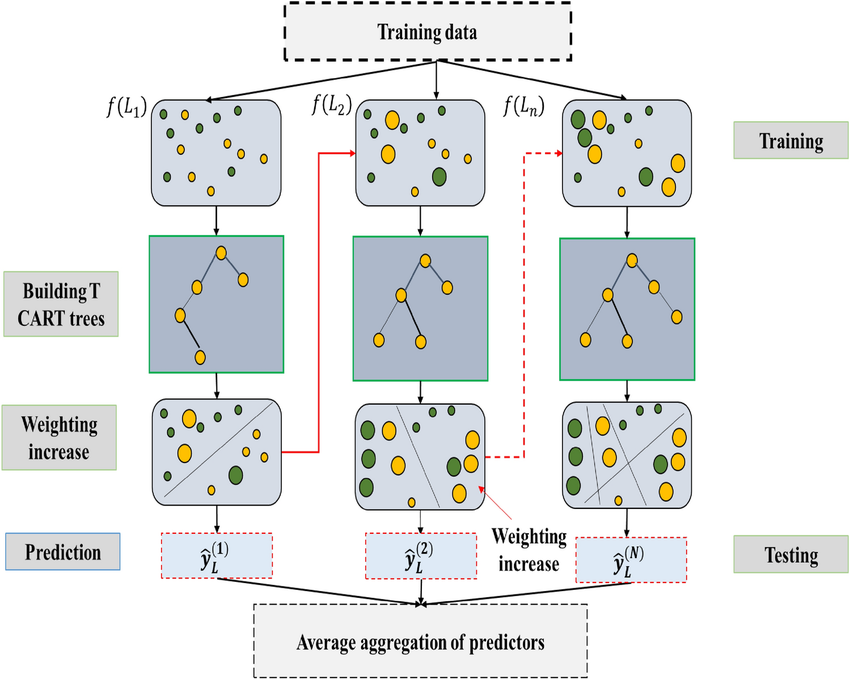
 <br></br>

- **Support Vector Machine**: This algorithm finds the optimal hyperplane to separate different classes in the feature space; it maximizes the margin between the closest data points of different classes (support vectors) to enhance classification accuracy.
  SVMs can handle linear and non-linear data through kernel functions, making them versatile and powerful for various classification tasks <br></br>
  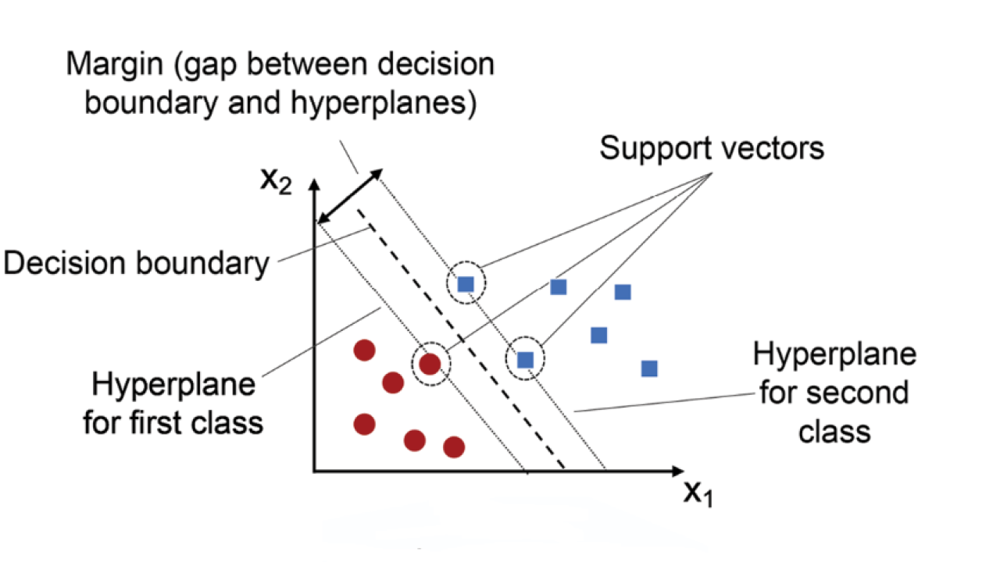
  <br></br>

- **Logistic Regression**: This algorithm models the probability of an outcome based on input features; it uses the logistic function to convert linear combinations of the features into probabilities, effectively separating classes by finding the best-fitting sigmoid curve <br></br>
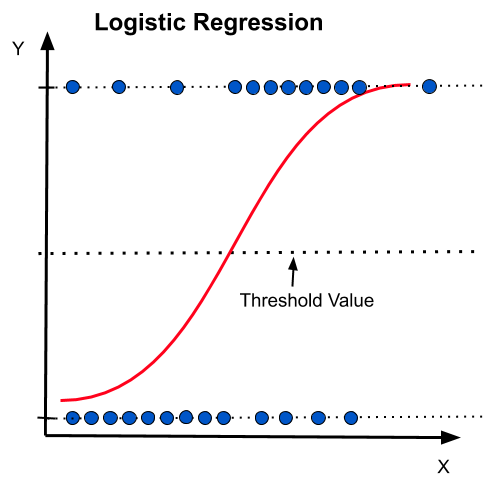


## Define function to perform Cross-Validation

In [33]:
def xgboostCrossValidation(xTrain, yTrain, parameters, nFolds):
    skf = StratifiedKFold(n_splits=nFolds, shuffle=True, random_state=42)

    bestParameters = {'n_estimators': 0, 'max_depth': 0, 'subsample': 0, 'learning_rate': 0, 'score': 0}

    t0 = time.time()

    for nEst in parameters['n_estimators']:
      for maxDep in parameters['max_depth']:
        for subsamp in parameters['subsample']:
          for lr in parameters['learning_rate']:

                print(f'Testing hyperparameters: n_estimators: {nEst}, max_depth: {maxDep}, learning_rate: {lr}, subsample: {subsamp}')
                score = 0
                for trainIDX, testIDX in skf.split(xTrain, yTrain):
                    xTrainFold, xTestFold = xTrain[trainIDX], xTrain[testIDX]
                    yTrainFold, yTestFold = yTrain[trainIDX], yTrain[testIDX]

                    model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                                          n_estimators = nEst, max_depth = maxDep, subsample = subsamp, learning_rate = lr)

                    model.fit(xTrainFold, yTrainFold)
                    yPred = model.predict(xTestFold)
                    globalF1 = mt.f1_score(yTestFold, yPred, average = 'macro')
                    score += globalF1

                score = score / nFolds

                if score > bestParameters['score']:
                    print('----------> [UPDATE] This configuration is now the optimal one!\n\n')
                    bestParameters['score'] = score
                    bestParameters['n_estimators'] = nEst
                    bestParameters['max_depth'] = maxDep
                    bestParameters['subsample'] = subsamp
                    bestParameters['learning_rate'] = lr

    t1 = time.time()

    duration = round(t1 - t0, 2)

    print(f"\n\nCross-Validation lasted: {str(datetime.timedelta(seconds = duration))}!")
    print(f"The best Macro F1-Score is: {bestParameters['score']:.2f}")

    return bestParameters

In [34]:
def svmCrossValidation(xTrain, yTrain, parameters, nFolds):

  bestParameters = {'decision_function_shape': 'undefined',
                    'kernel': 'undefined',
                    'gamma': 'undefined',
                    'C': 0,
                    'score': 0}

  skf = StratifiedKFold(n_splits = nFolds)
  t0 = time.time()

  for shape in parameters['decision_function_shape']:
    for kernel in parameters['kernel']:
      for c in parameters['C']:
        for gamma in parameters['gamma']:
          print(f'Trial with: Shape = {shape}, Kernel = {kernel}, C = {c}, gamma = {gamma}')
          score = 0

          for trainIDX, testIDX in skf.split(xTrain, yTrain):
              xTrainFold, xTestFold = xTrain[trainIDX], xTrain[testIDX]
              yTrainFold, yTestFold = yTrain[trainIDX], yTrain[testIDX]

              svm = SVC(decision_function_shape = shape, kernel = kernel, C = c, gamma = gamma)
              svm.fit(xTrainFold, yTrainFold)

              yPred = svm.predict(xTestFold)

              globalF1 = mt.f1_score(yTestFold, yPred, average = 'macro')
              score += globalF1

          score = score / nFolds

          if score > bestParameters['score']:
              print('----------> [UPDATE] This configuration is now the optimal one!\n\n')
              bestParameters['score'] = score
              bestParameters['C'] = c
              bestParameters['gamma'] = gamma
              bestParameters['kernel'] = kernel
              bestParameters['decision_function_shape'] = shape

  t1 = time.time()

  duration = round(t1 - t0, 2)

  print(f"\n\nCross-Validation lasted: {str(datetime.timedelta(seconds = duration))}!")
  print(f"The best Macro F1-Score is: {bestParameters['score']:.2f}")

  return bestParameters

In [35]:
def logisticCrossValidation(xTrain, yTrain, parameters, nFolds):

  bestParameters = {
                      'solver': 'Undefined',
                      'C': 0,
                      'maxIteration': 0,
                      'score': 0
                    }

  skf = StratifiedKFold(n_splits = nFolds)
  t0 = time.time()

  for solver in parameters['solver']:
    for maxIt in parameters['maxIteration']:
      for c in parameters['C']:

        print(f'Trial with: Solver = {solver}, maxIteration = {maxIt}, C = {c}')
        score = 0

        for trainIDX, testIDX in skf.split(xTrain, yTrain):
            xTrainFold, xTestFold = xTrain[trainIDX], xTrain[testIDX]
            yTrainFold, yTestFold = yTrain[trainIDX], yTrain[testIDX]
            lr = LogisticRegression(multi_class = 'multinomial', solver = solver, max_iter = maxIt, C = c)
            lr.fit(xTrainFold, yTrainFold)

            yPred = lr.predict(xTestFold)

            globalF1 = mt.f1_score(yTestFold, yPred, average = 'macro')
            score += globalF1

        score = score / nFolds
        if score > bestParameters['score']:
            print('----------> [UPDATE] This configuration is now the optimal one!\n\n')
            bestParameters['score'] = score
            bestParameters['C'] = c
            bestParameters['maxIteration'] = maxIt
            bestParameters['solver'] = solver

    t1 = time.time()

  duration = round(t1 - t0, 2)

  print(f"\n\nCross-Validation lasted: {str(datetime.timedelta(seconds = duration))}!")
  print(f"The best Macro F1-Score is: {bestParameters['score']:.2f}")

  return bestParameters

## DataGen 1

### 🌲 XGBoost

In [ ]:
parameters = {
      'n_estimators': [50, 100, 150],
      'max_depth': [5, 10, 15],
      'learning_rate': [0.01, 0.1, 0.2],
      'subsample': [0.7, 0.8, 0.9]
    }

nFolds = 10

#### Binary

In [ ]:
bestParams = xgboostCrossValidation(xTrainBinary, yTrainBinary, parameters, nFolds)

Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.2, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.8
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0.8
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.2, subsample: 0.8
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.9
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary'

with open(path, 'w') as json_file:
    json.dump(bestParams, json_file)

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = bestParameters['n_estimators'], max_depth = bestParameters['max_depth'], subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainBinary, yTrainBinary)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestBinary)
yPredProba = model.predict_proba(xTestBinary)

XGBoost baseline training lasted: 0:00:00.250000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.98      │ 0.99      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.96      │ 0.96      │ 1.00      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.97      │ 0.98      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.95      │ 0.96      │ 0.99      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.99      │ 0.99      │ 1.00      │ 1.00      │ /        │
├───

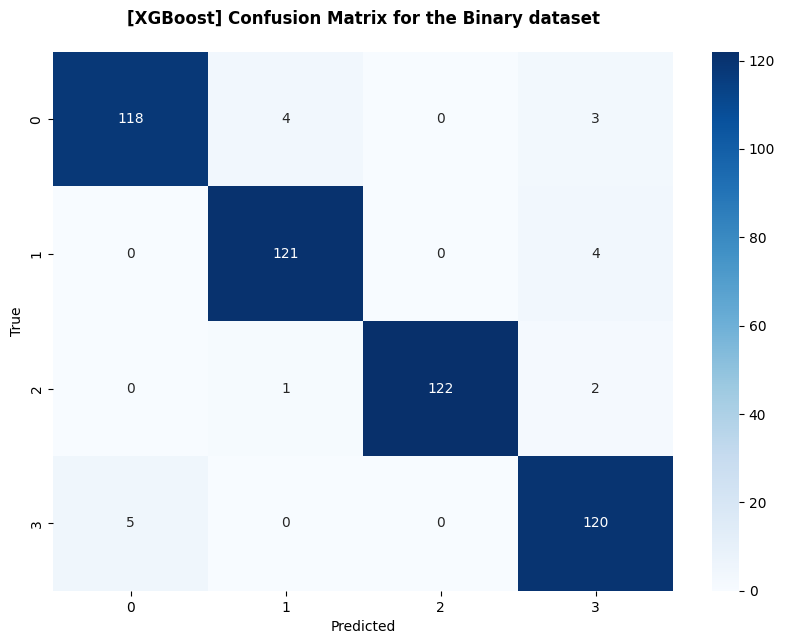

In [ ]:
path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/XGBoost'

printPerformances(yPred, yPredProba, yTestBinary, 'Binary', 'XGBoost', path)

#### Categorical

In [ ]:
bestParams = xgboostCrossValidation(xTrainCategorical, yTrainCategorical, parameters, nFolds)

Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.2, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.8
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0.8
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.2, subsample: 0.8
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.9
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical'

with open(path, 'w') as json_file:
    json.dump(bestParams, json_file)

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = bestParameters['n_estimators'], max_depth = bestParameters['max_depth'], subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainCategorical, yTrainCategorical)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestCategorical)
yPredProba = model.predict_proba(xTestCategorical)

XGBoost baseline training lasted: 0:00:00.440000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.98      │ 0.99      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.94      │ 0.96      │ 1.00      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.98      │ 0.98      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.94      │ 0.97      │ 0.99      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.99      │ 0.99      │ 1.00      │ 0.99      │ /        │
├───

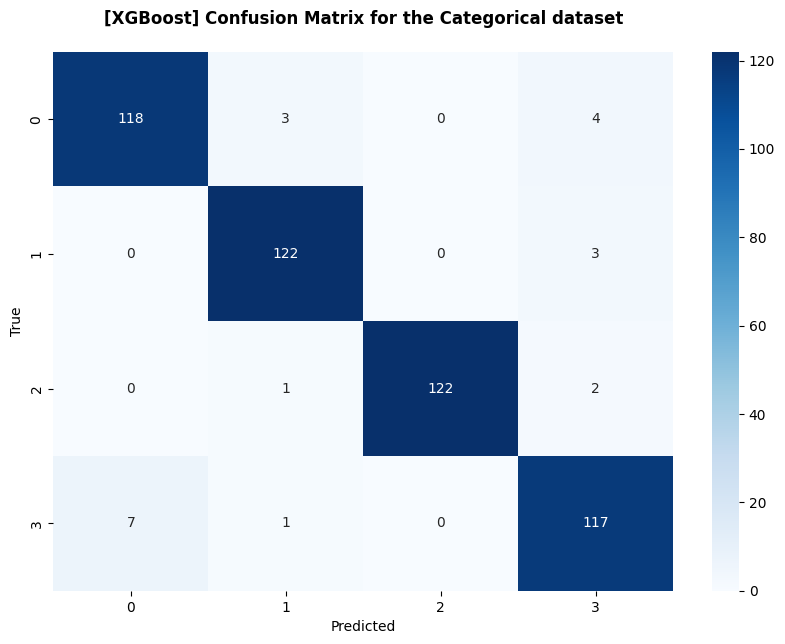

In [ ]:
path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/XGBoost'

printPerformances(yPred, yPredProba, yTestCategorical, 'Categorical', 'XGBoost', path)

### 🏎️ Support Vector Machine

In [ ]:
parameters = {
      'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
      'C': [0.01, 0.1, 1, 10, 100],
      'gamma': ['scale', 'auto'],
      'decision_function_shape': ['ovo', 'ovr']
    }

nFolds = 10

#### Binary

In [ ]:
bestParameters = svmCrossValidation(xTrainBinary, yTrainBinary, parameters, nFolds)

Trial with: Shape = ovo, Kernel = linear, C = 0.01, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 0.01, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 0.1, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 0.1, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 1, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 1, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 10, gamma = scale
Trial with: Shape = ovo, Kernel = linear, C = 10, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 100, gamma = scale
Trial with: Shape = ovo, Kernel = linear, C = 100, gamma = auto
Trial with: Shape = ovo, Kernel = poly, C = 0.01, gamma = scale
Trial with: Shape = ovo, Kernel = poly, C = 0.01, gamma = auto
Trial with: Shape = ovo, Kernel = 

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary'

with open(path, 'w') as json_file:
    json.dump(bestParameters, json_file)

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainBinary, yTrainBinary)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestBinary)
yProb = svm.predict_proba(xTestBinary)

SVM baseline training lasted: 0:00:00.310000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.96      │ 0.97      │ 0.98      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.90      │ 0.93      │ 1.00      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.95      │ 0.91      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.93      │ 0.94      │ 0.95      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.98      │ 1.00      │ 0.99      │ /        │
├───

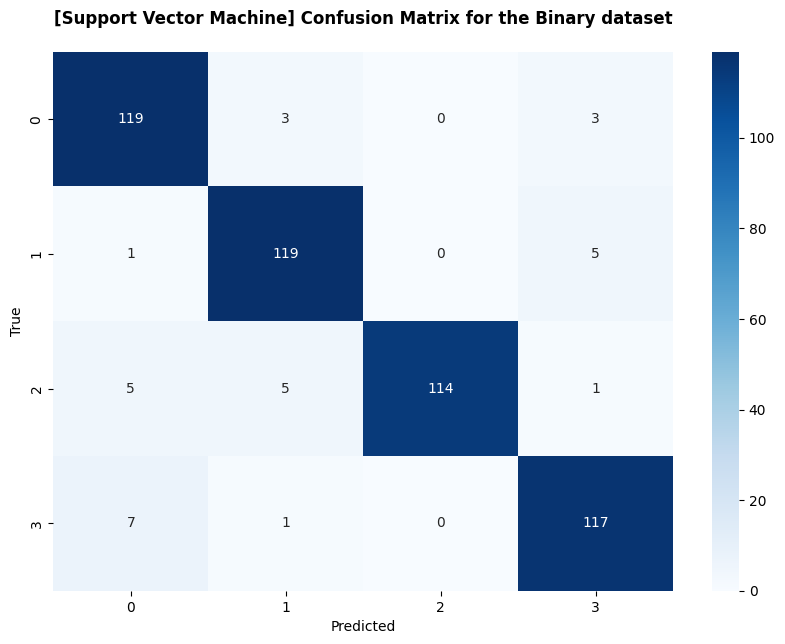

In [ ]:
path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/SVM'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Support Vector Machine', path)

#### Categorical

In [ ]:
bestParameters = svmCrossValidation(xTrainCategorical, yTrainCategorical, parameters, nFolds)

Trial with: Shape = ovo, Kernel = linear, C = 0.01, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 0.01, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 0.1, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 0.1, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 1, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 1, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 10, gamma = scale
Trial with: Shape = ovo, Kernel = linear, C = 10, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 100, gamma = scale
Trial with: Shape = ovo, Kernel = linear, C = 100, gamma = auto
Trial with: Shape = ovo, Kernel = poly, C = 0.01, gamma = scale
Trial with: Shape = ovo, Kernel = poly, C = 0.01, gamma = auto
Trial with: Shape = ovo, Kernel = 

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical'

with open(path, 'w') as json_file:
    json.dump(bestParameters, json_file)

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainCategorical, yTrainCategorical)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestCategorical)
yProb = svm.predict_proba(xTestCategorical)

SVM baseline training lasted: 0:00:00.190000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.95      │ 0.97      │ 0.97      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.87      │ 0.92      │ 0.99      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.93      │ 0.95      │ 0.89      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.90      │ 0.93      │ 0.94      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.99      │ 0.99      │ 0.99      │ /        │
├───

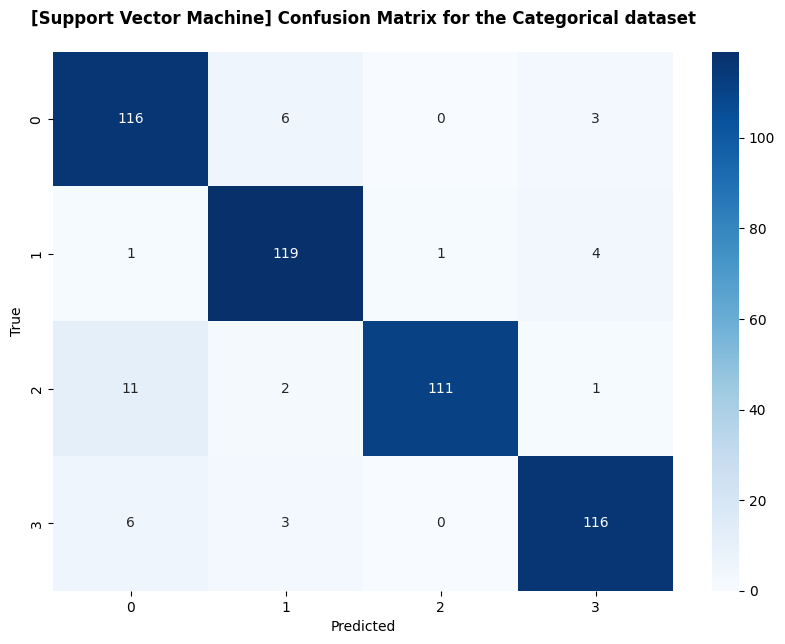

In [ ]:
path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/SVM'

printPerformances(yPred, yProb, yTestCategorical, 'Categorical', 'Support Vector Machine', path)

### 💡 Logistic Regression

In [ ]:
parameters = {
              'solver': ['sag', 'newton-cg', 'lbfgs'],
              'C': [1, 10, 100, 1000],
              'maxIteration': [1000, 5000, 10000]
              }
nFolds = 10

#### Binary

In [ ]:
bestParameters = logisticCrossValidation(xTrainBinary, yTrainBinary, parameters, nFolds)

Trial with: Solver = sag, maxIteration = 1000, C = 1
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Solver = sag, maxIteration = 1000, C = 10
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Solver = sag, maxIteration = 1000, C = 100
Trial with: Solver = sag, maxIteration = 1000, C = 1000


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/

Trial with: Solver = sag, maxIteration = 5000, C = 1
Trial with: Solver = sag, maxIteration = 5000, C = 10
Trial with: Solver = sag, maxIteration = 5000, C = 100
Trial with: Solver = sag, maxIteration = 5000, C = 1000
Trial with: Solver = sag, maxIteration = 10000, C = 1
Trial with: Solver = sag, maxIteration = 10000, C = 10
Trial with: Solver = sag, maxIteration = 10000, C = 100
Trial with: Solver = sag, maxIteration = 10000, C = 1000
Trial with: Solver = newton-cg, maxIteration = 1000, C = 1
Trial with: Solver = newton-cg, maxIteration = 1000, C = 10
Trial with: Solver = newton-cg, maxIteration = 1000, C = 100
Trial with: Solver = newton-cg, maxIteration = 1000, C = 1000
Trial with: Solver = newton-cg, maxIteration = 5000, C = 1
Trial with: Solver = newton-cg, maxIteration = 5000, C = 10
Trial with: Solver = newton-cg, maxIteration = 5000, C = 100
Trial with: Solver = newton-cg, maxIteration = 5000, C = 1000
Trial with: Solver = newton-cg, maxIteration = 10000, C = 1
Trial with: Solv

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Binary'

with open(path, 'w') as json_file:
    json.dump(bestParameters, json_file)

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainBinary, yTrainBinary)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")

yPred = lr.predict(xTestBinary)
yProb = lr.predict_proba(xTestBinary)

LR baseline training lasted: 0:00:00.680000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.96      │ 0.98      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.94      │ 0.90      │ 1.00      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.96      │ 0.96      │ 0.92      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.95      │ 0.93      │ 0.96      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.98      │ 1.00      │ 0.99      │ /        │
├───

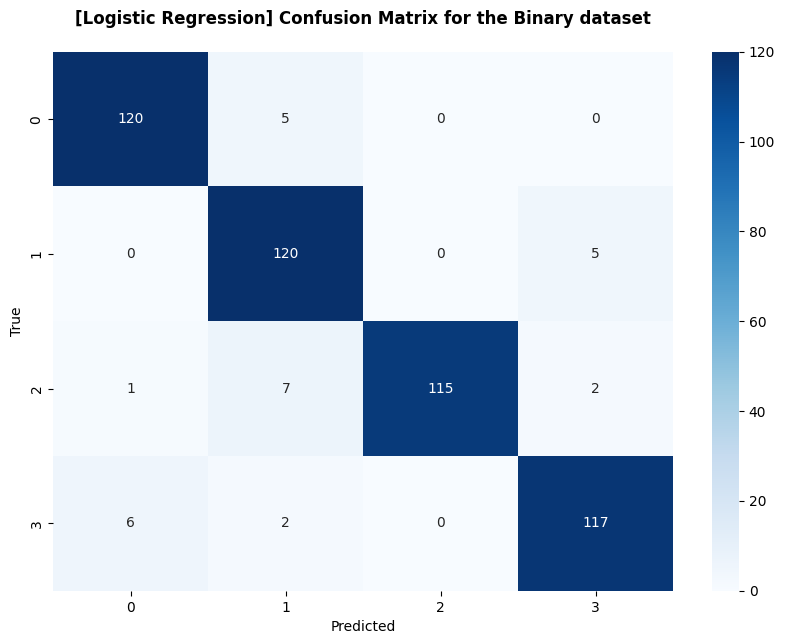

In [ ]:
path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/LR'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Logistic Regression', path)

#### Categorical

In [ ]:
bestParameters = logisticCrossValidation(xTrainCategorical, yTrainCategorical, parameters, nFolds)

Trial with: Solver = sag, maxIteration = 1000, C = 1
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Solver = sag, maxIteration = 1000, C = 10
Trial with: Solver = sag, maxIteration = 1000, C = 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/

Trial with: Solver = sag, maxIteration = 1000, C = 1000


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/

Trial with: Solver = sag, maxIteration = 5000, C = 1
Trial with: Solver = sag, maxIteration = 5000, C = 10
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Solver = sag, maxIteration = 5000, C = 100
Trial with: Solver = sag, maxIteration = 5000, C = 1000
Trial with: Solver = sag, maxIteration = 10000, C = 1
Trial with: Solver = sag, maxIteration = 10000, C = 10
Trial with: Solver = sag, maxIteration = 10000, C = 100
Trial with: Solver = sag, maxIteration = 10000, C = 1000
Trial with: Solver = newton-cg, maxIteration = 1000, C = 1
Trial with: Solver = newton-cg, maxIteration = 1000, C = 10
Trial with: Solver = newton-cg, maxIteration = 1000, C = 100
Trial with: Solver = newton-cg, maxIteration = 1000, C = 1000
Trial with: Solver = newton-cg, maxIteration = 5000, C = 1
Trial with: Solver = newton-cg, maxIteration = 5000, C = 10
Trial with: Solver = newton-cg, maxIteration = 5000, C = 100
Trial with: Solver = newton-cg, maxIteration = 5000, C = 1000
Trial with

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.10/dist-packages/sklearn/

Trial with: Solver = lbfgs, maxIteration = 5000, C = 1
Trial with: Solver = lbfgs, maxIteration = 5000, C = 10
Trial with: Solver = lbfgs, maxIteration = 5000, C = 100
Trial with: Solver = lbfgs, maxIteration = 5000, C = 1000
Trial with: Solver = lbfgs, maxIteration = 10000, C = 1
Trial with: Solver = lbfgs, maxIteration = 10000, C = 10
Trial with: Solver = lbfgs, maxIteration = 10000, C = 100
Trial with: Solver = lbfgs, maxIteration = 10000, C = 1000


Cross-Validation lasted: 0:09:58.440000!
The best Macro F1-Score is: 0.95


In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Categorical'

with open(path, 'w') as json_file:
    json.dump(bestParameters, json_file)

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])
t0 = time.time()
lr.fit(xTrainCategorical, yTrainCategorical)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestCategorical)
yProb = lr.predict_proba(xTestCategorical)

LR baseline training lasted: 0:00:02.110000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.96      │ 0.96      │ 0.97      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.91      │ 0.89      │ 0.99      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.94      │ 0.89      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.93      │ 0.92      │ 0.94      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.98      │ 0.98      │ 0.99      │ /        │
├───

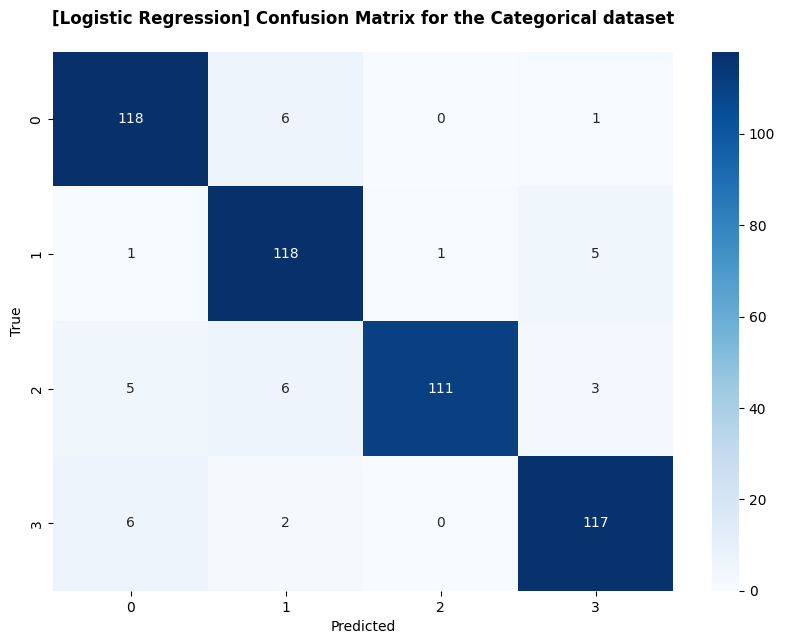

In [ ]:
path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/LR'

printPerformances(yPred, yProb, yTestCategorical, 'Categorical', 'Logistic Regression', path)

## DataGen 2

In [13]:
# Create the reduced dataset
percentage = 80
classToRemove = 2

trainingSetBinaryReduced = createReducedDataset(trainingSetBinary, 'Binary', percentage, classToRemove)
trainingSetCategoricalReduced = createReducedDataset(trainingSetCategorical, 'Categorical', percentage, classToRemove)

*********************** Reducing Binary Dataset ***********************

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 82 samples
					 - Class 3: 211 samples
The new data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples



*********************** Reducing Categorical Dataset ***********************

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 82 samples
					 - Class 3: 211 samples
The new data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples





In [37]:
# The test set clearly remains unchanged with respect to the previous case, we are just changing the date on which we
# perform the training

xTrainBinary = trainingSetBinaryReduced.drop(columns = ['label']).to_numpy()
yTrainBinary = trainingSetBinaryReduced['label'].to_numpy()

xTrainCategorical = trainingSetCategoricalReduced.drop(columns = ['label']).to_numpy()
yTrainCategorical = trainingSetCategoricalReduced['label'].to_numpy()

### 🌲 XGBoost

In [38]:
parameters = {
      'n_estimators': [50, 100, 150],
      'max_depth': [5, 10, 15],
      'learning_rate': [0.01, 0.1, 0.2],
      'subsample': [0.7, 0.8, 0.9]
    }

nFolds = 10

#### Binary

In [39]:
bestParams = xgboostCrossValidation(xTrainBinary, yTrainBinary, parameters, nFolds)

Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.2, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.8
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0.8
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.2, subsample: 0.8
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.9
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0

In [40]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary_DataGen2'

with open(path, 'w') as json_file:
    json.dump(bestParams, json_file)

In [41]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = bestParameters['n_estimators'], max_depth = bestParameters['max_depth'], subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainBinary, yTrainBinary)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestBinary)
yPredProba = model.predict_proba(xTestBinary)

XGBoost baseline training lasted: 0:00:00.260000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.94      │ 0.90      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.97      │ 0.81      │ 1.00      │ 0.81      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 1.00      │ 0.62      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.96      │ 0.89      │ 0.76      │ 0.87      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.99      │ 0.98      │ 0.98      │ /        │
├───

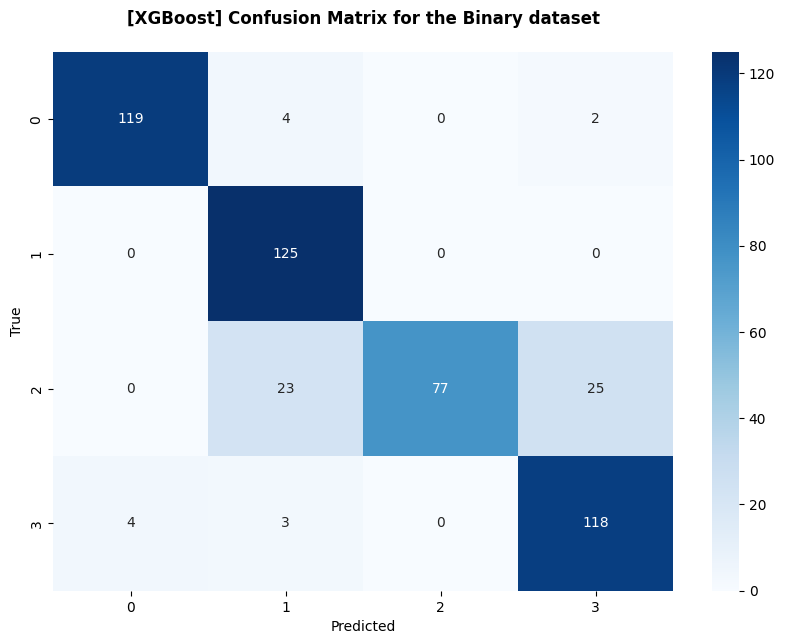

In [42]:
path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/XGBoost_DataGen2'

printPerformances(yPred, yPredProba, yTestBinary, 'Binary', 'XGBoost', path)

#### Categorical

In [43]:
bestParams = xgboostCrossValidation(xTrainCategorical, yTrainCategorical, parameters, nFolds)

Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.2, subsample: 0.7
----------> [UPDATE] This configuration is now the optimal one!


Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.8
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0.8
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.2, subsample: 0.8
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.01, subsample: 0.9
Testing hyperparameters: n_estimators: 50, max_depth: 5, learning_rate: 0.1, subsample: 0.9
Testing hyperparameters: n_estimators: 50, max_depth: 5, learni

In [44]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical_DataGen2'

with open(path, 'w') as json_file:
    json.dump(bestParams, json_file)

In [45]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = bestParameters['n_estimators'], max_depth = bestParameters['max_depth'], subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainCategorical, yTrainCategorical)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestCategorical)
yPredProba = model.predict_proba(xTestCategorical)

XGBoost baseline training lasted: 0:00:00.380000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.92      │ 0.91      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.98      │ 0.75      │ 1.00      │ 0.90      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.99      │ 0.62      │ 0.98      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.97      │ 0.86      │ 0.77      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.99      │ 0.99      │ 0.99      │ /        │
├───

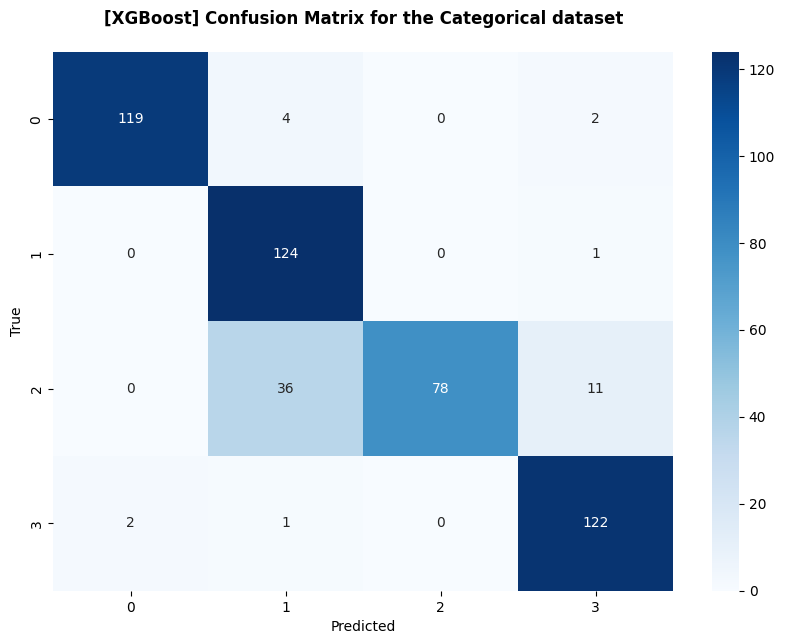

In [46]:
path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/XGBoost_DataGen2'

printPerformances(yPred, yPredProba, yTestCategorical, 'Categorical', 'XGBoost', path)

### 🏎️ Support Vector Machine

In [47]:
parameters = {
      'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
      'C': [0.01, 0.1, 1, 10, 100],
      'gamma': ['scale', 'auto'],
      'decision_function_shape': ['ovo', 'ovr']
    }

nFolds = 10

#### Binary

In [48]:
bestParameters = svmCrossValidation(xTrainBinary, yTrainBinary, parameters, nFolds)

Trial with: Shape = ovo, Kernel = linear, C = 0.01, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 0.01, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 0.1, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 0.1, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 1, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 1, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 10, gamma = scale
Trial with: Shape = ovo, Kernel = linear, C = 10, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 100, gamma = scale
Trial with: Shape = ovo, Kernel = linear, C = 100, gamma = auto
Trial with: Shape = ovo, Kernel = poly, C = 0.01, gamma = scale
Trial with: Shape = ovo, Kernel = poly, C = 0.01, gamma = auto
Trial with: Shape = ovo, Kernel = 

In [49]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary_DataGen2'

with open(path, 'w') as json_file:
    json.dump(bestParameters, json_file)

In [50]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainBinary, yTrainBinary)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestBinary)
yProb = svm.predict_proba(xTestBinary)

SVM baseline training lasted: 0:00:00.180000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.93      │ 0.90      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.97      │ 0.79      │ 0.99      │ 0.80      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.98      │ 0.59      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.96      │ 0.88      │ 0.74      │ 0.86      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.99      │ 1.00      │ 0.98      │ /        │
├───

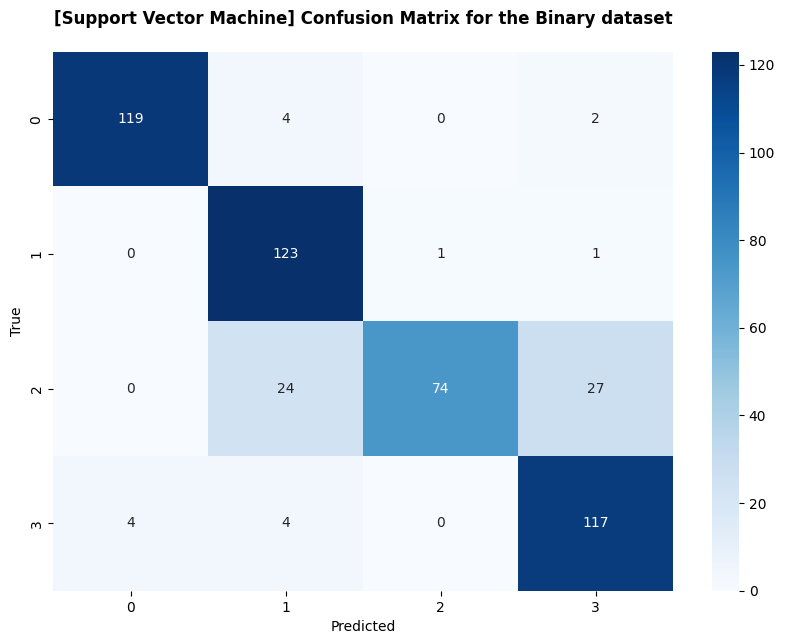

In [51]:
path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/SVM_DataGen2'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Support Vector Machine', path)

#### Categorical

In [52]:
bestParameters = svmCrossValidation(xTrainCategorical, yTrainCategorical, parameters, nFolds)

Trial with: Shape = ovo, Kernel = linear, C = 0.01, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 0.01, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 0.1, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 0.1, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 1, gamma = scale
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Shape = ovo, Kernel = linear, C = 1, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 10, gamma = scale
Trial with: Shape = ovo, Kernel = linear, C = 10, gamma = auto
Trial with: Shape = ovo, Kernel = linear, C = 100, gamma = scale
Trial with: Shape = ovo, Kernel = linear, C = 100, gamma = auto
Trial with: Shape = ovo, Kernel = poly, C = 0.01, gamma = scale
Trial with: Shape = ovo, Kernel = poly, C = 0.01, gamma = auto
Trial with: Shape = ovo, Kernel = 

In [53]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical_DataGen2'

with open(path, 'w') as json_file:
    json.dump(bestParameters, json_file)

In [54]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainCategorical, yTrainCategorical)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestCategorical)
yProb = svm.predict_proba(xTestCategorical)

SVM baseline training lasted: 0:00:00.150000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.93      │ 0.90      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.92      │ 0.80      │ 0.97      │ 0.84      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.97      │ 0.61      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.93      │ 0.87      │ 0.75      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.99      │ 0.98      │ 0.99      │ /        │
├───

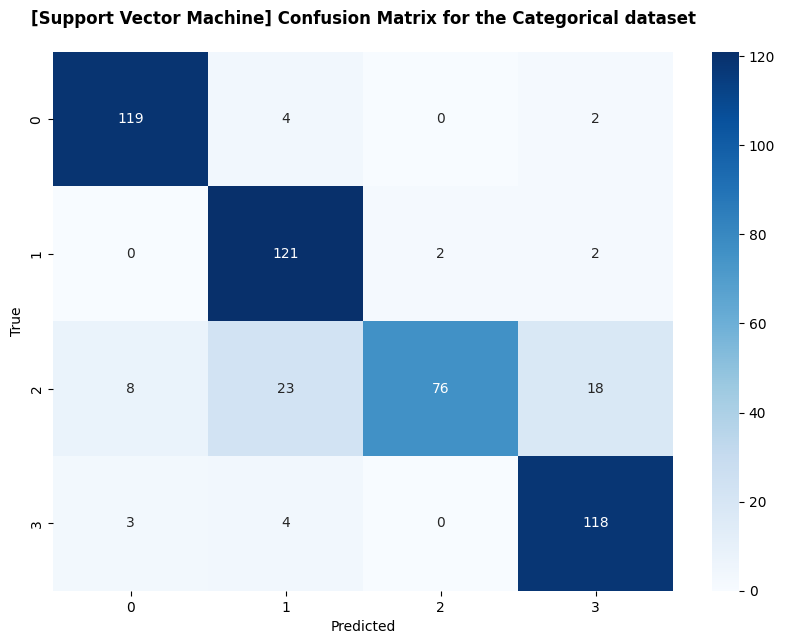

In [55]:
path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/SVM_DataGen2'

printPerformances(yPred, yProb, yTestCategorical, 'Categorical', 'Support Vector Machine', path)

### 💡 Logistic Regression

In [56]:
parameters = {
              'solver': ['sag', 'newton-cg', 'lbfgs'],
              'C': [1, 10, 100, 1000],
              'maxIteration': [1000, 5000, 10000]
              }
nFolds = 10

#### Binary

In [57]:
bestParameters = logisticCrossValidation(xTrainBinary, yTrainBinary, parameters, nFolds)

Trial with: Solver = sag, maxIteration = 1000, C = 1
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Solver = sag, maxIteration = 1000, C = 10
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Solver = sag, maxIteration = 1000, C = 100
Trial with: Solver = sag, maxIteration = 1000, C = 1000


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/

Trial with: Solver = sag, maxIteration = 5000, C = 1
Trial with: Solver = sag, maxIteration = 5000, C = 10
Trial with: Solver = sag, maxIteration = 5000, C = 100
Trial with: Solver = sag, maxIteration = 5000, C = 1000
Trial with: Solver = sag, maxIteration = 10000, C = 1
Trial with: Solver = sag, maxIteration = 10000, C = 10
Trial with: Solver = sag, maxIteration = 10000, C = 100
Trial with: Solver = sag, maxIteration = 10000, C = 1000
Trial with: Solver = newton-cg, maxIteration = 1000, C = 1
Trial with: Solver = newton-cg, maxIteration = 1000, C = 10
Trial with: Solver = newton-cg, maxIteration = 1000, C = 100
Trial with: Solver = newton-cg, maxIteration = 1000, C = 1000
Trial with: Solver = newton-cg, maxIteration = 5000, C = 1
Trial with: Solver = newton-cg, maxIteration = 5000, C = 10
Trial with: Solver = newton-cg, maxIteration = 5000, C = 100
Trial with: Solver = newton-cg, maxIteration = 5000, C = 1000
Trial with: Solver = newton-cg, maxIteration = 10000, C = 1
Trial with: Solv

In [58]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Binary_DataGen2'

with open(path, 'w') as json_file:
    json.dump(bestParameters, json_file)

In [59]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Binary_DateGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainBinary, yTrainBinary)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")

yPred = lr.predict(xTestBinary)
yProb = lr.predict_proba(xTestBinary)

LR baseline training lasted: 0:00:00.530000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.94      │ 0.89      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.92      │ 0.83      │ 1.00      │ 0.77      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.96      │ 0.97      │ 0.57      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.94      │ 0.89      │ 0.72      │ 0.85      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.98      │ 0.97      │ 0.95      │ /        │
├───

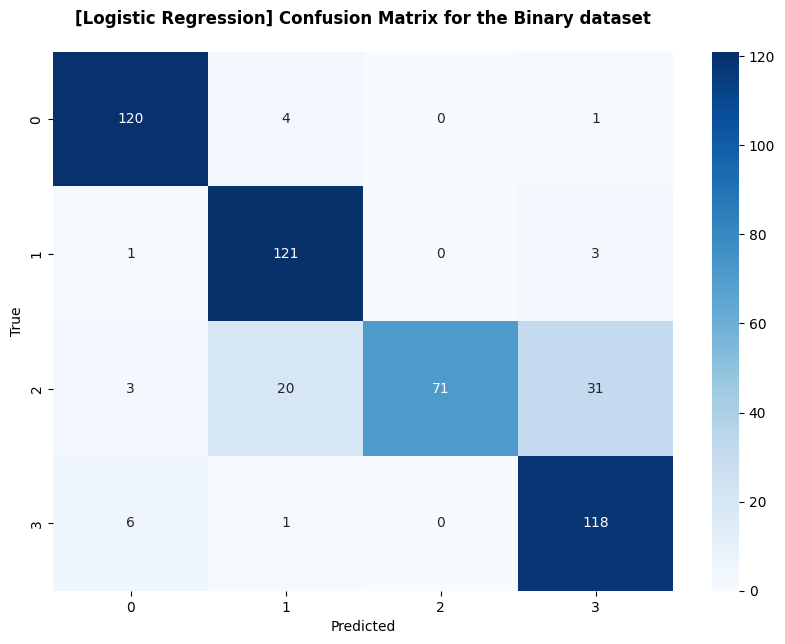

In [60]:
path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/LR_DataGen2'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Logistic Regression', path)

#### Categorical

In [61]:
bestParameters = logisticCrossValidation(xTrainCategorical, yTrainCategorical, parameters, nFolds)

Trial with: Solver = sag, maxIteration = 1000, C = 1
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Solver = sag, maxIteration = 1000, C = 10
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Solver = sag, maxIteration = 1000, C = 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/

Trial with: Solver = sag, maxIteration = 1000, C = 1000


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/usr/local/lib/python3.10/dist-packages/

Trial with: Solver = sag, maxIteration = 5000, C = 1
Trial with: Solver = sag, maxIteration = 5000, C = 10
Trial with: Solver = sag, maxIteration = 5000, C = 100
Trial with: Solver = sag, maxIteration = 5000, C = 1000
Trial with: Solver = sag, maxIteration = 10000, C = 1
Trial with: Solver = sag, maxIteration = 10000, C = 10
----------> [UPDATE] This configuration is now the optimal one!


Trial with: Solver = sag, maxIteration = 10000, C = 100
Trial with: Solver = sag, maxIteration = 10000, C = 1000
Trial with: Solver = newton-cg, maxIteration = 1000, C = 1
Trial with: Solver = newton-cg, maxIteration = 1000, C = 10
Trial with: Solver = newton-cg, maxIteration = 1000, C = 100
Trial with: Solver = newton-cg, maxIteration = 1000, C = 1000
Trial with: Solver = newton-cg, maxIteration = 5000, C = 1
Trial with: Solver = newton-cg, maxIteration = 5000, C = 10
Trial with: Solver = newton-cg, maxIteration = 5000, C = 100
Trial with: Solver = newton-cg, maxIteration = 5000, C = 1000
Trial with

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.10/dist-packages/sklearn/

Trial with: Solver = lbfgs, maxIteration = 5000, C = 1
Trial with: Solver = lbfgs, maxIteration = 5000, C = 10
Trial with: Solver = lbfgs, maxIteration = 5000, C = 100
Trial with: Solver = lbfgs, maxIteration = 5000, C = 1000
Trial with: Solver = lbfgs, maxIteration = 10000, C = 1
Trial with: Solver = lbfgs, maxIteration = 10000, C = 10
Trial with: Solver = lbfgs, maxIteration = 10000, C = 100
Trial with: Solver = lbfgs, maxIteration = 10000, C = 1000


Cross-Validation lasted: 0:11:19.730000!
The best Macro F1-Score is: 0.88


In [62]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Categorical_DataGen2'

with open(path, 'w') as json_file:
    json.dump(bestParameters, json_file)

In [63]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])
t0 = time.time()
lr.fit(xTrainCategorical, yTrainCategorical)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR baseline training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestCategorical)
yProb = lr.predict_proba(xTestCategorical)

LR baseline training lasted: 0:00:03.570000!


╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.96      │ 0.95      │ 0.94      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.89      │ 0.84      │ 1.00      │ 0.91      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.97      │ 0.76      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.92      │ 0.90      │ 0.86      │ 0.91      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.98      │ 0.96      │ 0.98      │ /        │
├───

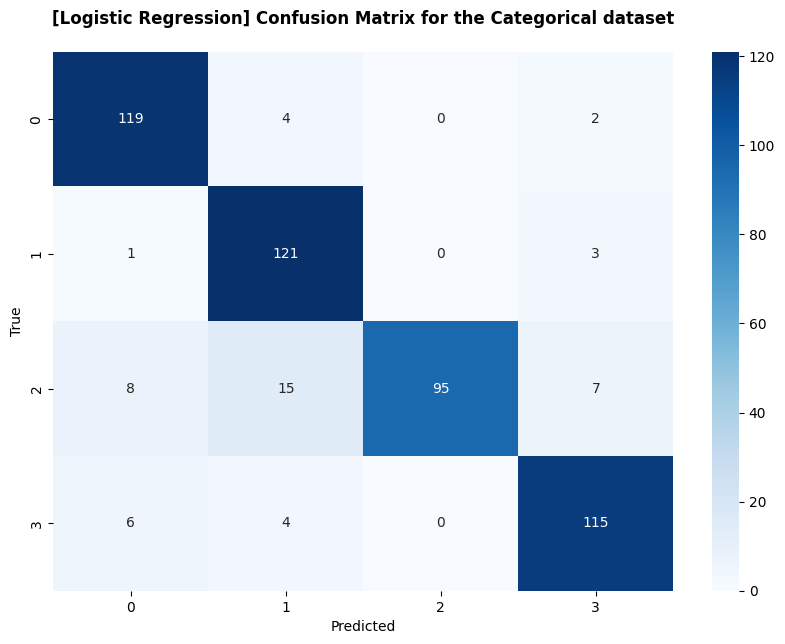

In [64]:
path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/LR_DataGen2'

printPerformances(yPred, yProb, yTestCategorical, 'Categorical', 'Logistic Regression', path)

# 1️⃣ DataGen 1

In this section, we implement the first approach to rebalance the dataset and measure the performance using both SMOTE and GAN techniques: <br></br>

  - **SMOTE (Synthetic Minority Over-sampling Technique)**: This technique identifies the under-represented classes and, based on the chosen sampling strategy, generates new synthetic samples. In our case, we aim to augment the data points of all the minority classes to match the number of samples in the majority class; SMOTE achieves this by interpolating between a sample from the minority class and a certain number of its nearest neighbors, thus creating new, synthetic data points<br></br>
  
  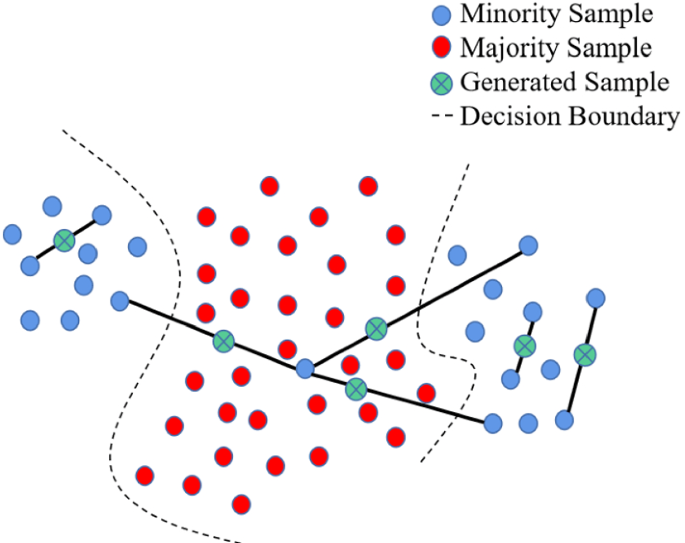
<br></br>

  - **CTGAN(Conditional Tabular Generative Adversarial Network)**: This model extends the traditional Generative Adversarial Network (GAN) to effectively handle tabular data. <br>The CTGAN architecture consists of two main components:<br>
    
    - *Generator*: The generator's goal is to create synthetic data that closely resembles real data. It takes a random noise vector as input and generates new data points
    
    - *Discriminator*: The discriminator's task is to distinguish between real and synthetic data. It evaluates the data and tries to identify which samples are genuine and which are artificially created

  The objective of the generator is to deceive the discriminator into believing that the synthetic data is real; simultaneously, the discriminator is trained to accurately detect the differences between real and synthetic data. <br>
  This adversarial process continues until the generator produces highly realistic synthetic data that the discriminator can no longer reliably differentiate from real data

  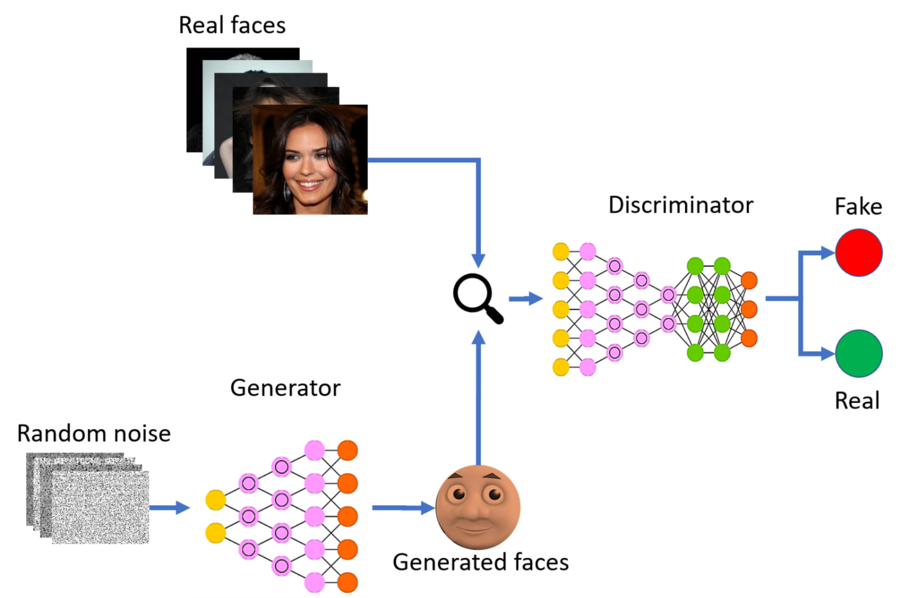

## 🧨 [SMOTE] Binary

In [ ]:
xTrainBinarySMOTE, yTrainBinarySMOTE = applySmote(xTrainBinary, yTrainBinary, 'Datagen1/2A')

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 82 samples
					 - Class 3: 211 samples

The new data distribution is:
					 - Class 0: 486 samples
					 - Class 1: 486 samples
					 - Class 2: 486 samples
					 - Class 3: 486 samples


### XGBoost

XGBoost SMOTE training lasted: 0:00:00.460000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.97      │ 0.98      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.96      │ 0.94      │ 0.99      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.96      │ 0.94      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.95      │ 0.95      │ 0.97      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.99      │ 1.00

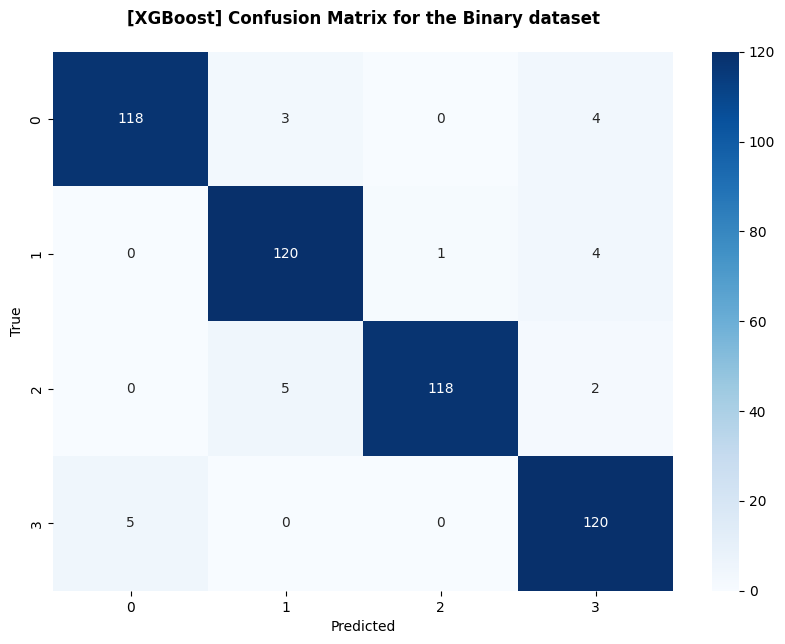

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])


t0 = time.time()
model.fit(xTrainBinarySMOTE, yTrainBinarySMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestBinary)
yPredProba = model.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/XGBoost_SMOTE_'

printPerformances(yPred, yPredProba, yTestBinary, 'Binary', 'XGBoost', path)

### Support Vector Machine

SVM SMOTE training lasted: 0:00:00.390000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.96      │ 0.96      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.93      │ 0.89      │ 1.00      │ 0.91      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.95      │ 0.84      │ 0.98      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.94      │ 0.92      │ 0.91      │ 0.95      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.97    

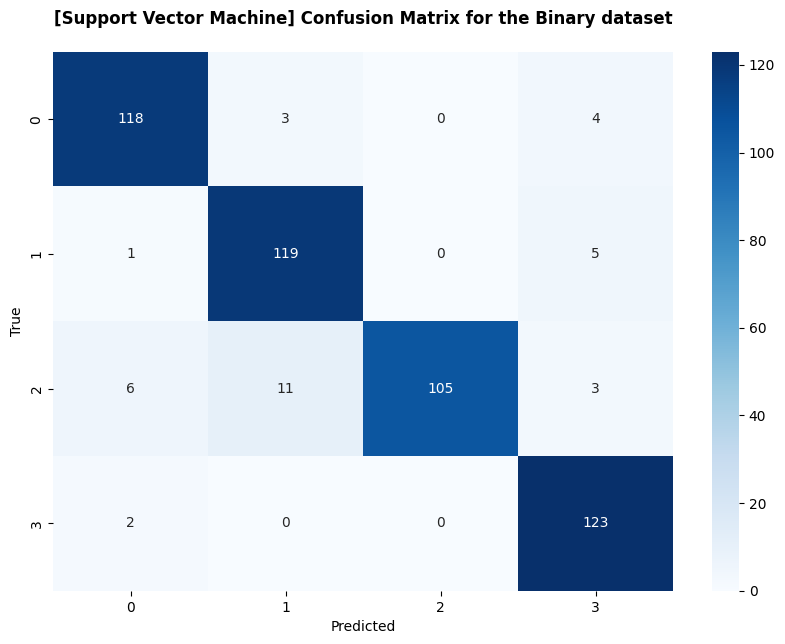

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainBinarySMOTE, yTrainBinarySMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestBinary)
yProb = svm.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/SVM_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Support Vector Machine', path)

### Logistic Regression

LR SMOTE training lasted: 0:00:01.280000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.96      │ 0.98      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.96      │ 0.89      │ 0.99      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.96      │ 0.95      │ 0.91      │ 0.95      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.96      │ 0.92      │ 0.95      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.99      │ 0.98     

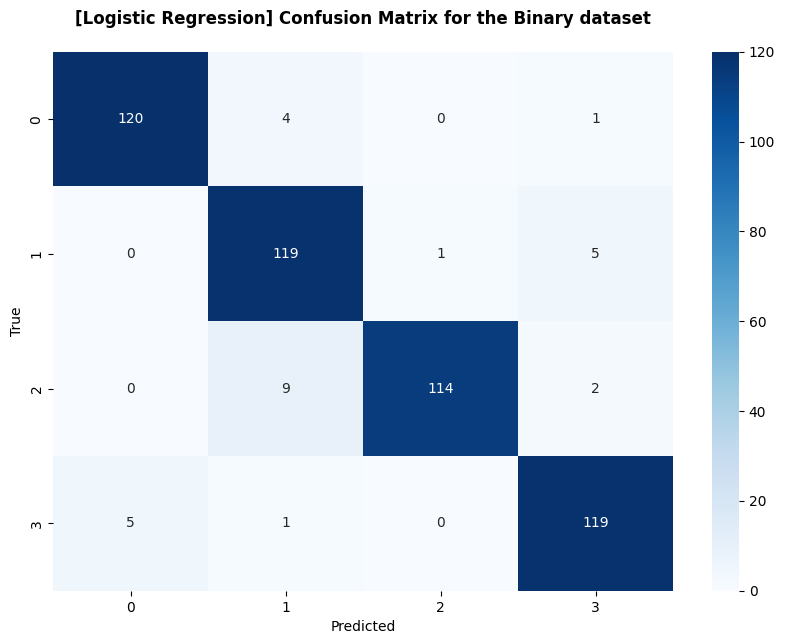

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainBinarySMOTE, yTrainBinarySMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestBinary)
yProb = lr.predict_proba(xTestBinary)


path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/LR_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Logistic Regression', path)

## 🧨 [SMOTE] Categorical

In [ ]:
xTrainCategoricalSMOTE, yTrainCategoricalSMOTE = applySmote(xTrainCategorical, yTrainCategorical, 'Datagen1/2A')

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 82 samples
					 - Class 3: 211 samples

The new data distribution is:
					 - Class 0: 486 samples
					 - Class 1: 486 samples
					 - Class 2: 486 samples
					 - Class 3: 486 samples


### XGBoost

XGBoost SMOTE training lasted: 0:00:01.980000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.98      │ 0.99      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.94      │ 0.95      │ 0.98      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.93      │ 0.97      │ 0.98      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.94      │ 0.96      │ 0.98      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.99      │ 1.00

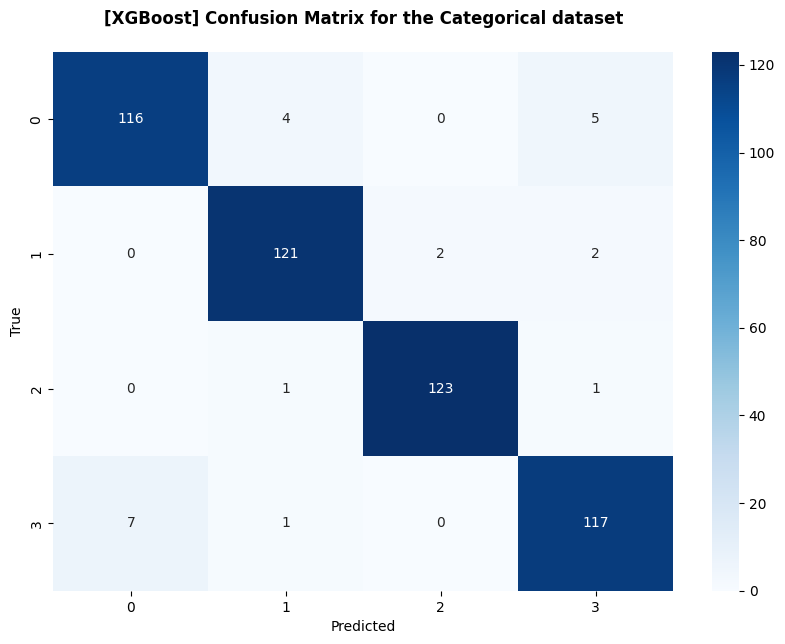

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainCategoricalSMOTE, yTrainCategoricalSMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestCategorical)
yPredProba = model.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/XGBoost_SMOTE_'

printPerformances(yPred, yPredProba, yTestCategorical, 'Categorical', 'XGBoost', path)

### Support Vector Machine

SVM SMOTE training lasted: 0:00:00.630000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.95      │ 0.96      │ 0.95      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.88      │ 0.88      │ 0.96      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.95      │ 0.82      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.91      │ 0.92      │ 0.89      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.98    

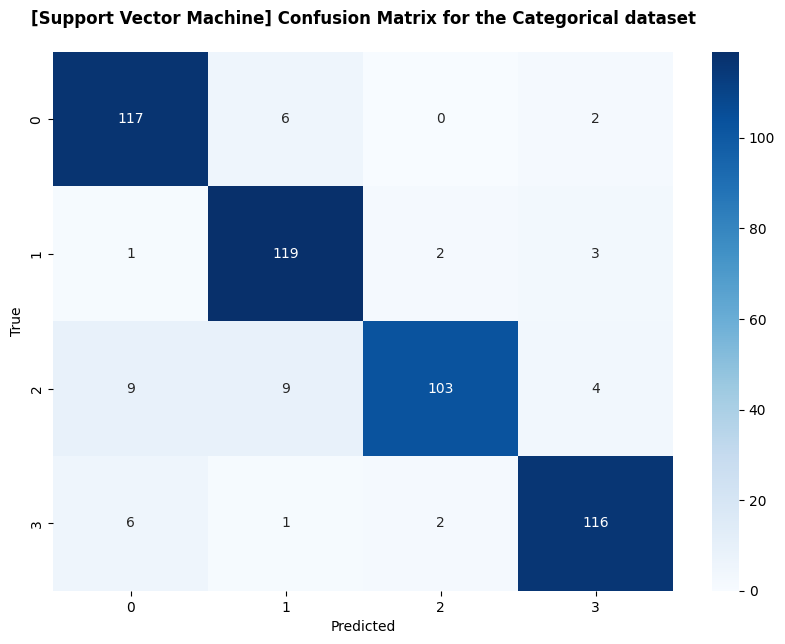

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainCategoricalSMOTE, yTrainCategoricalSMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestCategorical)
yProb = svm.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/SVM_SMOTE_'

printPerformances(yPred, yProb, yTestCategorical, 'Categorical', 'Support Vector Machine', path)

### Logistic Regression

LR SMOTE training lasted: 0:00:03.890000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.96      │ 0.96      │ 0.97      │ 0.98      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.93      │ 0.89      │ 0.97      │ 0.95      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.93      │ 0.94      │ 0.90      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.93      │ 0.91      │ 0.93      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.98     

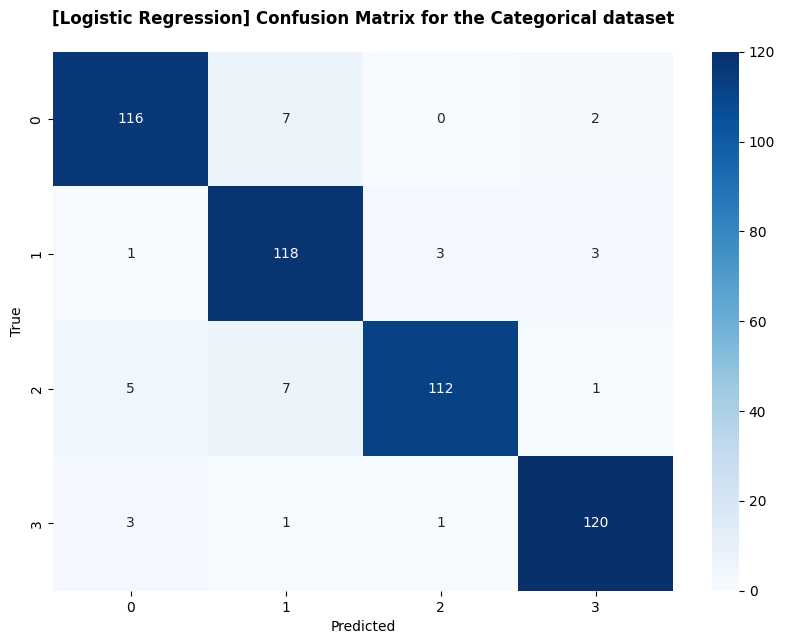

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainCategoricalSMOTE, yTrainCategoricalSMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestCategorical)
yProb = lr.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/LR_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Categorical', 'Logistic Regression', path)

## 💣 [CTGAN] Binary

In [ ]:
xTrainBinaryGAN, yTrainBinaryGAN = applyCTGAN(trainingSetBinary, 'Datagen1/2A')

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 82 samples
					 - Class 3: 211 samples


The new data distribution is:
					 - Class 0: 486 samples
					 - Class 1: 486 samples
					 - Class 2: 486 samples
					 - Class 3: 486 samples


### XGBoost

XGBoost CTGAN training lasted: 0:00:00.400000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.97      │ 0.98      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.95      │ 0.95      │ 0.98      │ 0.90      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.92      │ 0.94      │ 0.95      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.93      │ 0.94      │ 0.96      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.99      │ 0.99

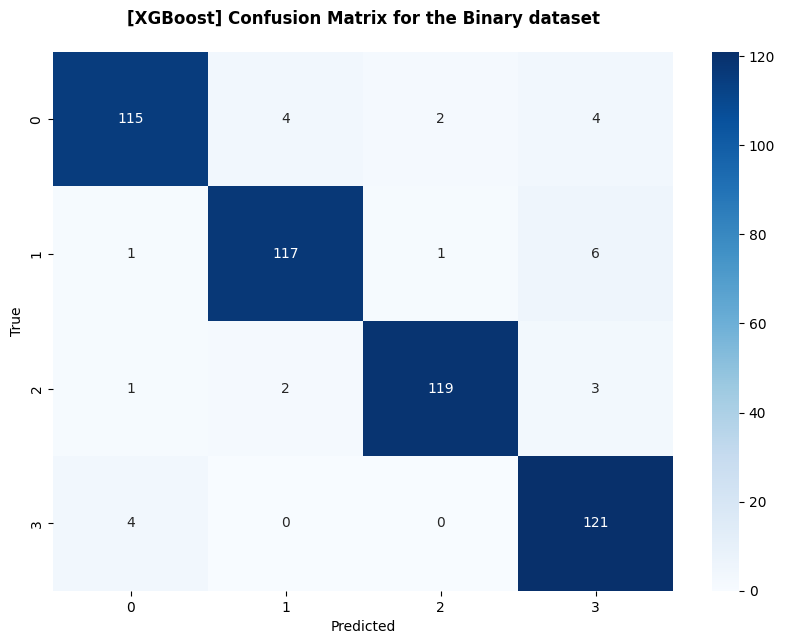

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainBinaryGAN, yTrainBinaryGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestBinary)
yPredProba = model.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/XGBoost_GAN_'

printPerformances(yPred, yPredProba, yTestBinary, 'Binary', 'XGBoost', path)

### Support Vector Machine

SVM CTGAN training lasted: 0:00:01.190000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.97      │ 0.97      │ 0.95      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.94      │ 0.93      │ 0.97      │ 0.87      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.92      │ 0.94      │ 0.90      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.93      │ 0.93      │ 0.94      │ 0.90      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.98    

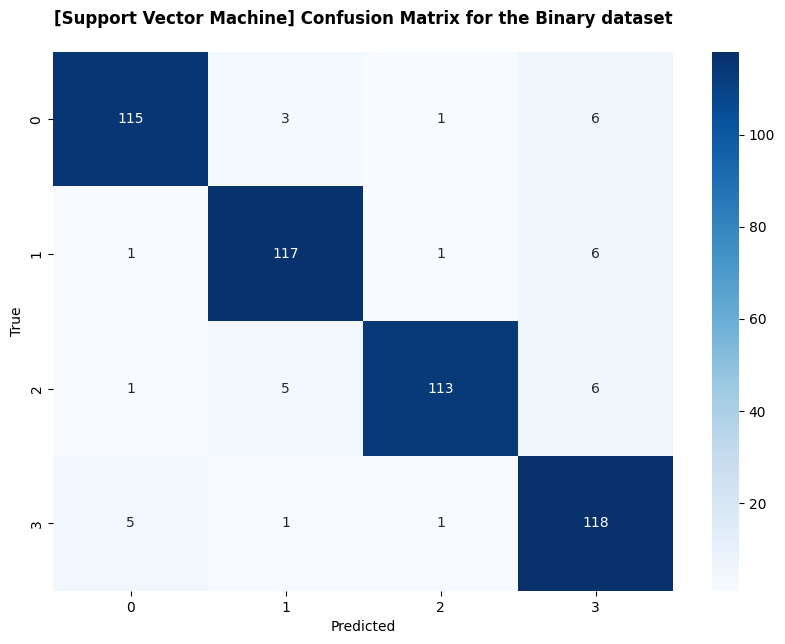

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainBinaryGAN, yTrainBinaryGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestBinary)
yProb = svm.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/SVM_GAN_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Support Vector Machine', path)

### Logistic Regression

LR CTGAN training lasted: 0:00:01.460000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.94      │ 0.95      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.94      │ 0.84      │ 0.95      │ 0.88      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.94      │ 0.84      │ 0.88      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.94      │ 0.89      │ 0.89      │ 0.88      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.97     

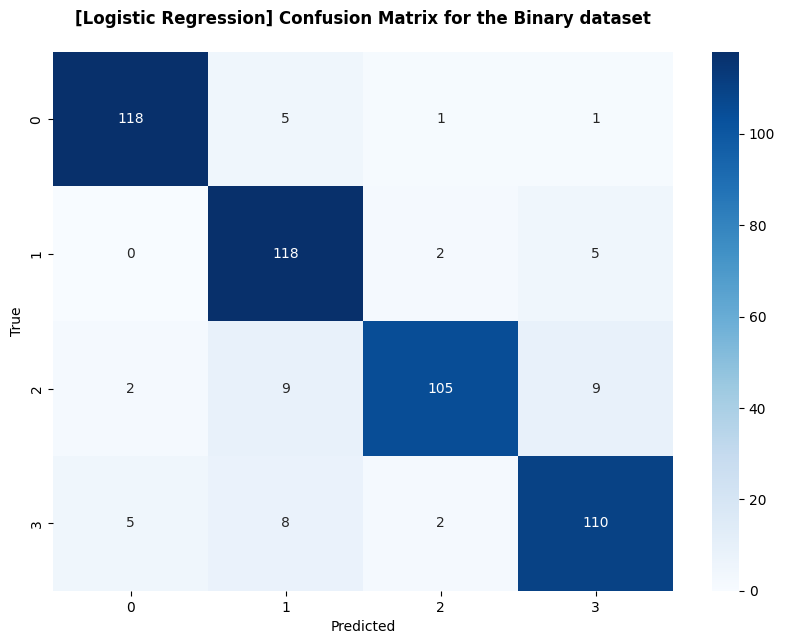

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainBinaryGAN, yTrainBinaryGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestBinary)
yProb = lr.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/LR_GAN_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Logistic Regression', path)

## 💣 [CTGAN] Categorical

In [ ]:
xTrainCategoricalGAN, yTrainCategoricalGAN = applyCTGAN(trainingSetCategorical, 'Datagen1/2A')

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 82 samples
					 - Class 3: 211 samples


The new data distribution is:
					 - Class 0: 486 samples
					 - Class 1: 486 samples
					 - Class 2: 486 samples
					 - Class 3: 486 samples


### XGBoost

XGBoost CTGAN training lasted: 0:00:01.080000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.97      │ 0.98      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.95      │ 0.92      │ 0.96      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.91      │ 0.95      │ 0.96      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.93      │ 0.94      │ 0.96      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.99      │ 0.99

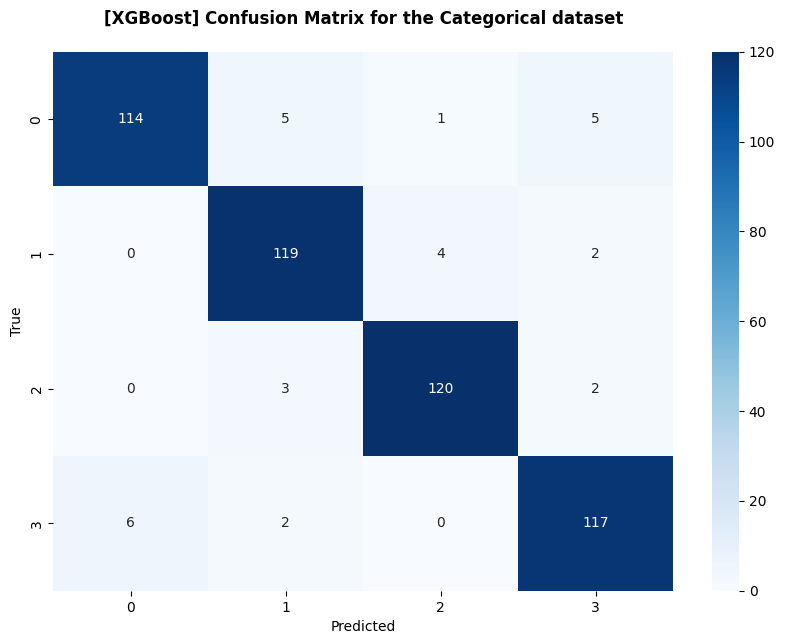

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainCategoricalGAN, yTrainCategoricalGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestCategorical)
yPredProba = model.predict_proba(xTestCategorical)


path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/XGBoost_GAN_'

printPerformances(yPred, yPredProba, yTestBinary, 'Categorical', 'XGBoost', path)

### Support Vector Machine

SVM CTGAN training lasted: 0:00:02.440000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.96      │ 0.98      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.96      │ 0.91      │ 0.95      │ 0.91      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.91      │ 0.94      │ 0.95      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.93      │ 0.93      │ 0.95      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.98    

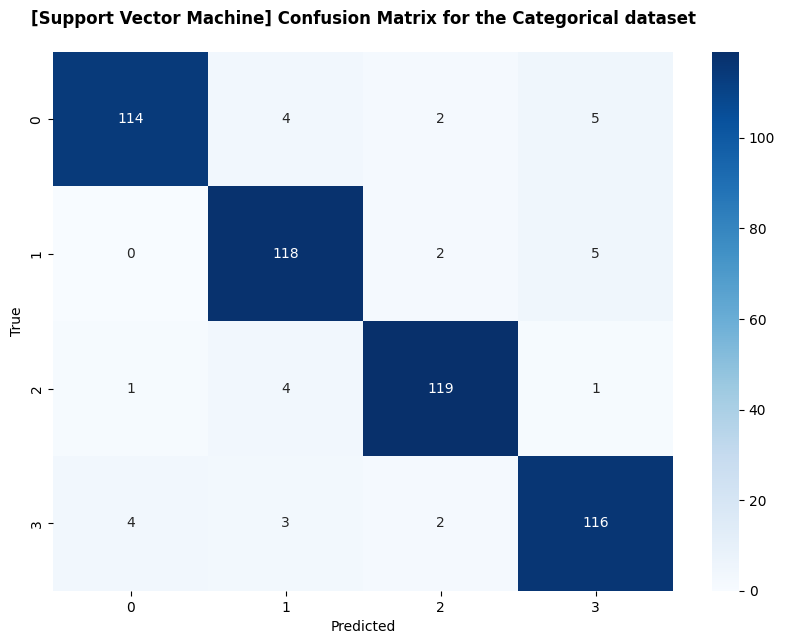

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainCategoricalGAN, yTrainCategoricalGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestCategorical)
yProb = svm.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/SVM_GAN_'

printPerformances(yPred, yProb, yTestCategorical, 'Categorical', 'Support Vector Machine', path)

### Logistic Regression

LR CTGAN training lasted: 0:00:05.630000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.96      │ 0.96      │ 0.96      │ 0.95      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.91      │ 0.91      │ 0.92      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.93      │ 0.93      │ 0.87      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.93      │ 0.92      │ 0.92      │ 0.90      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.98     

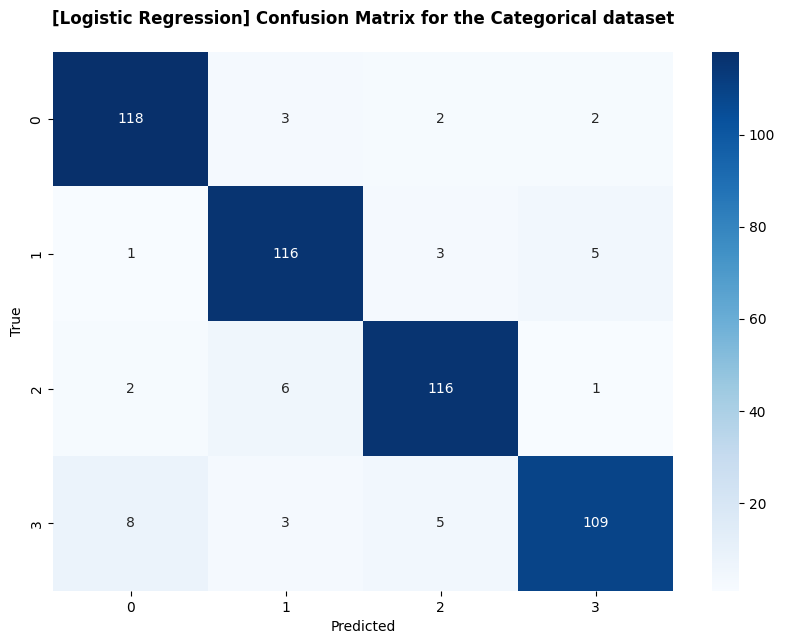

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainCategoricalGAN, yTrainCategoricalGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestCategorical)
yProb = lr.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/LR_GAN_'

printPerformances(yPred, yProb, yTestBinary, 'Categorical', 'Logistic Regression', path)

# 2️⃣ DataGen 2

In this section, we aim to address extremely unbalanced data using two different approaches: <br></br>

  1. **DataGen 2/A**:  We remove a significant percentage (e.g. 80%) of data points from a specific class and, after creating this reduced dataset, we balance it using the same techniques applied in DataGen 1

  2. **DataGen 2/B**: Similar to the first approach, we reduce the data points of a specific class, but, instead of balancing the dataset, we generate a fixed number of samples for each class, resulting in an unbalanced (but augmented) dataset

In [14]:
# Create the reduced dataset
trainingSetBinaryReduced = createReducedDataset(trainingSetBinary, 'Binary', percentage, classToRemove)
trainingSetCategoricalReduced = createReducedDataset(trainingSetCategorical, 'Categorical', percentage, classToRemove)

*********************** Reducing Binary Dataset ***********************

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 82 samples
					 - Class 3: 211 samples
The new data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples



*********************** Reducing Categorical Dataset ***********************

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 82 samples
					 - Class 3: 211 samples
The new data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples





## 🅰️ DataGen 2/A

### 🧨 [SMOTE] Binary

In [15]:
xTrainBinaryReduced = trainingSetBinaryReduced.drop(columns = ['label']).to_numpy()
yTrainBinaryReduced = trainingSetBinaryReduced['label'].to_numpy()

xTrainBinaryReducedSMOTE, yTrainBinaryReducedSMOTE = applySmote(xTrainBinaryReduced, yTrainBinaryReduced, 'Datagen1/2A')

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples

The new data distribution is:
					 - Class 0: 486 samples
					 - Class 1: 486 samples
					 - Class 2: 486 samples
					 - Class 3: 486 samples


#### XGBoost

XGBoost SMOTE training lasted: 0:00:01.710000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.95      │ 0.89      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.98      │ 0.84      │ 0.95      │ 0.78      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.98      │ 0.61      │ 0.95      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.96      │ 0.90      │ 0.74      │ 0.86      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.99

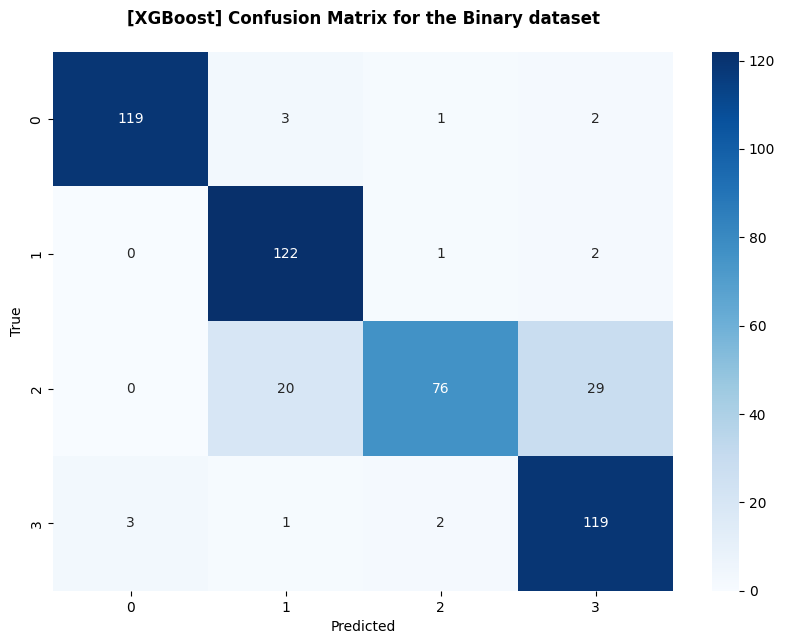

In [16]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])


t0 = time.time()
model.fit(xTrainBinaryReducedSMOTE, yTrainBinaryReducedSMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestBinary)
yPredProba = model.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/XGBoost_SMOTE_'

printPerformances(yPred, yPredProba, yTestBinary, 'Binary', 'XGBoost', path)

#### Support Vector Machine

SVM SMOTE training lasted: 0:00:00.750000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.93      │ 0.88      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.95      │ 0.78      │ 0.95      │ 0.82      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.96      │ 0.98      │ 0.56      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.96      │ 0.87      │ 0.70      │ 0.87      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.99    

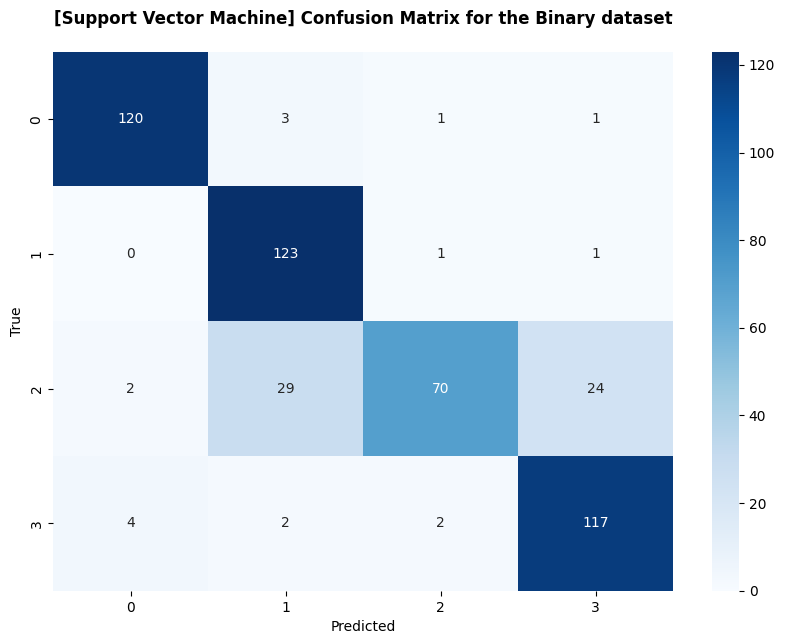

In [17]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary_DataGen2'

with open(path, 'r') as json_file:

    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainBinaryReducedSMOTE, yTrainBinaryReducedSMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestBinary)
yProb = svm.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/SVM_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Support Vector Machine', path)

#### Logistic Regression

LR SMOTE training lasted: 0:00:01.980000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.94      │ 0.93      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.94      │ 0.85      │ 0.94      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.94      │ 0.77      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.94      │ 0.89      │ 0.85      │ 0.91      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.96     

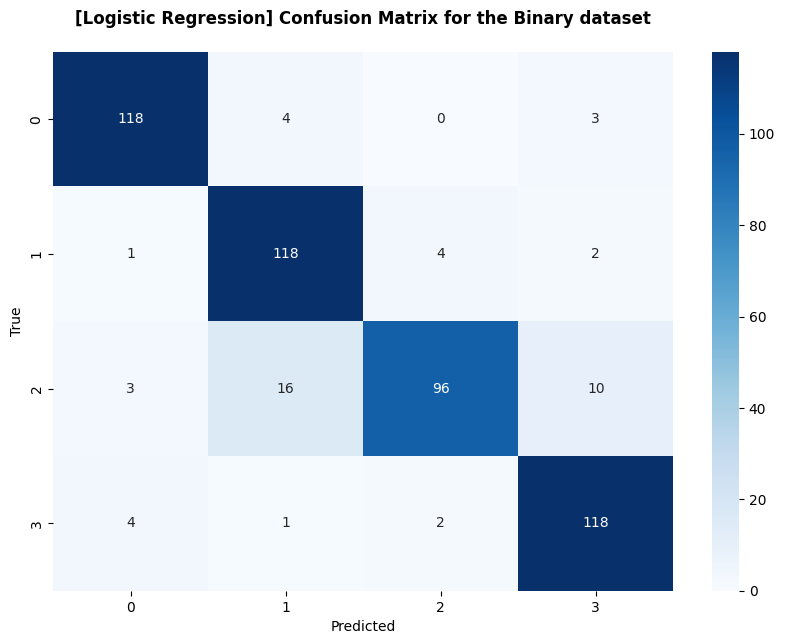

In [19]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainBinaryReducedSMOTE, yTrainBinaryReducedSMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestBinary)
yProb = lr.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/LR_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Logistic Regression', path)

### 🧨 [SMOTE] Categorical

In [20]:
xTrainCategoricalReduced = trainingSetCategoricalReduced.drop(columns = ['label']).to_numpy()
yTrainCategoricalReduced = trainingSetCategoricalReduced['label'].to_numpy()

xTrainCategoricalReducedSMOTE, yTrainCategoricalReducedSMOTE = applySmote(xTrainCategoricalReduced, yTrainCategoricalReduced, 'Datagen1/2A')

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples

The new data distribution is:
					 - Class 0: 486 samples
					 - Class 1: 486 samples
					 - Class 2: 486 samples
					 - Class 3: 486 samples


#### XGBoost

XGBoost SMOTE training lasted: 0:00:03.690000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.93      │ 0.90      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.97      │ 0.79      │ 0.91      │ 0.88      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.96      │ 0.66      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.96      │ 0.87      │ 0.76      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.99      │ 0.99

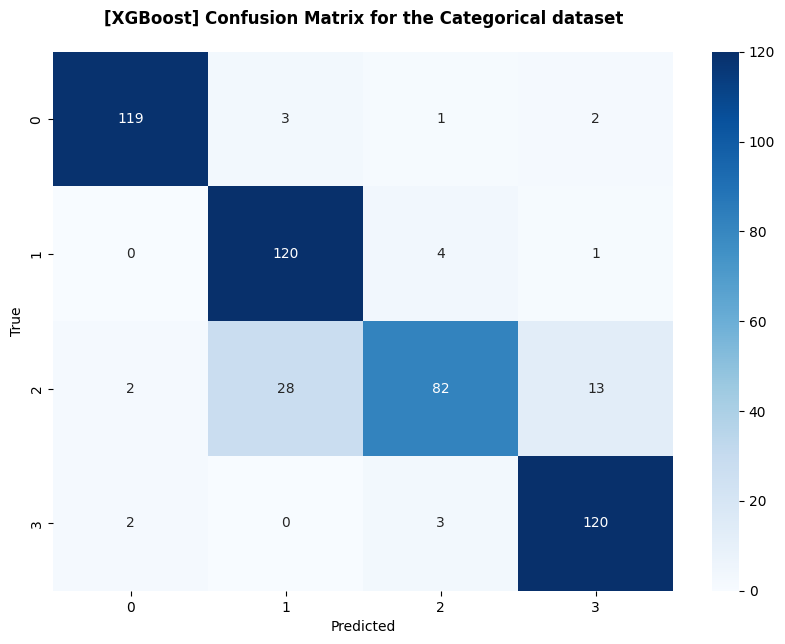

In [21]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainCategoricalReducedSMOTE, yTrainCategoricalReducedSMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestCategorical)
yPredProba = model.predict_proba(xTestCategorical)


path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/XGBoost_SMOTE_'

printPerformances(yPred, yPredProba, yTestBinary, 'Categorical', 'XGBoost', path)

#### Support Vector Machine

SVM SMOTE training lasted: 0:00:00.610000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.83      │ 0.79      │ 0.85      │ 0.69      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.97      │ 0.68      │ 0.69      │ 0.44      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.31      │ 0.32      │ 0.75      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.47      │ 0.43      │ 0.72      │ 0.60      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.96      │ 0.89    

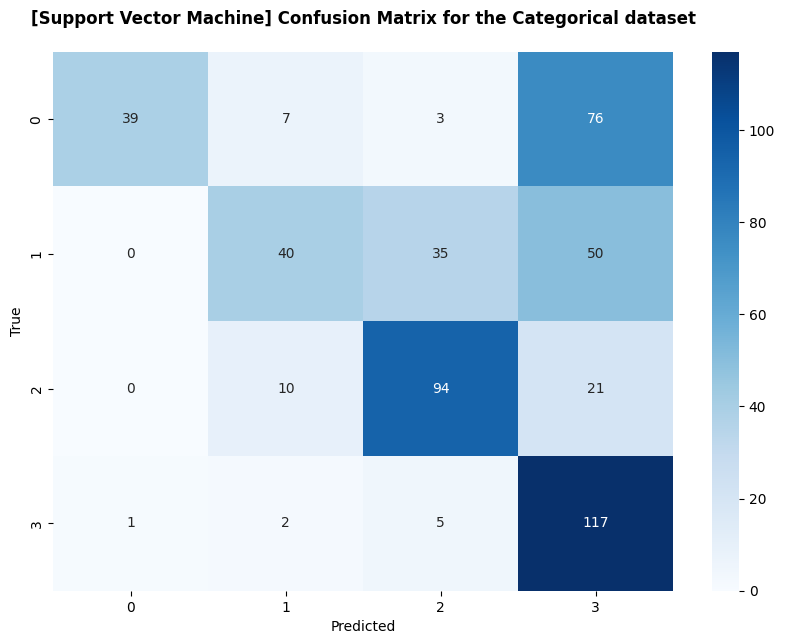

In [22]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainCategoricalReducedSMOTE, yTrainCategoricalReducedSMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestBinary)
yProb = svm.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/SVM_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Categorical', 'Support Vector Machine', path)

#### Logistic Regression

LR SMOTE training lasted: 0:00:10.590000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.90      │ 0.93      │ 0.94      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.94      │ 0.85      │ 0.94      │ 0.70      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.65      │ 0.89      │ 0.82      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.77      │ 0.87      │ 0.87      │ 0.81      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.96     

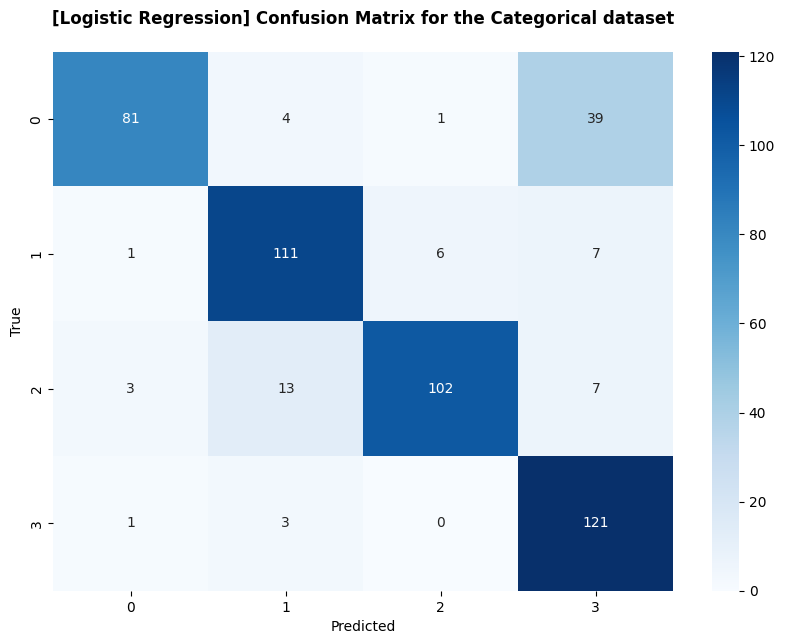

In [23]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainCategoricalReducedSMOTE, yTrainCategoricalReducedSMOTE)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestBinary)
yProb = lr.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/LR_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Categorical', 'Logistic Regression', path)

### 💣 [CTGAN] Binary

In [24]:
xTrainBinaryReducedGAN, yTrainBinaryReducedGAN = applyCTGAN(trainingSetBinaryReduced, 'Datagen1/2A')

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples


The new data distribution is:
					 - Class 0: 486 samples
					 - Class 1: 486 samples
					 - Class 2: 486 samples
					 - Class 3: 486 samples


#### XGBoost

XGBoost CTGAN training lasted: 0:00:00.690000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.96      │ 0.92      │ 0.88      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.95      │ 0.76      │ 0.91      │ 0.84      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.90      │ 0.97      │ 0.58      │ 0.95      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.93      │ 0.85      │ 0.71      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.99

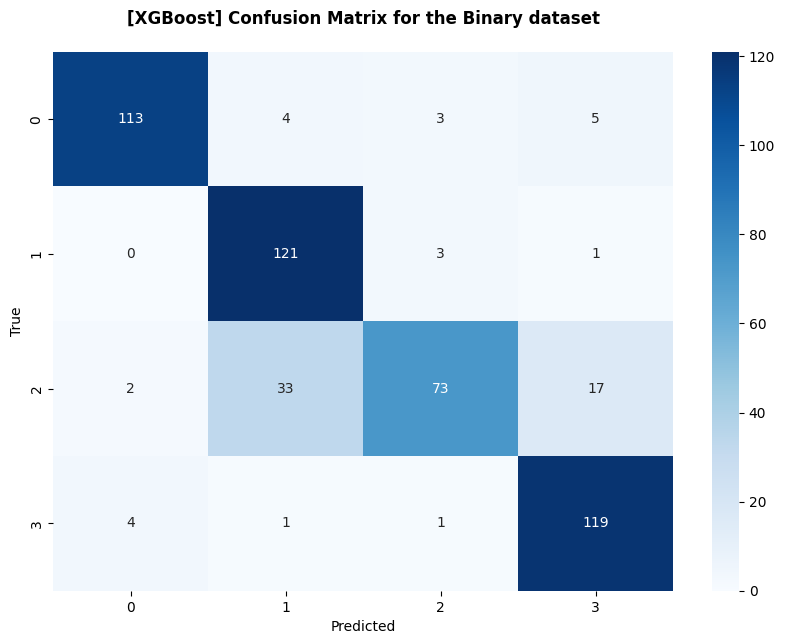

In [25]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainBinaryReducedGAN, yTrainBinaryReducedGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestBinary)
yPredProba = model.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/XGBoost_GAN_'

printPerformances(yPred, yPredProba, yTestBinary, 'Binary', 'XGBoost', path)

#### Support Vector Machine

SVM CTGAN training lasted: 0:00:01.610000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.96      │ 0.91      │ 0.89      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.91      │ 0.77      │ 0.94      │ 0.84      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.92      │ 0.94      │ 0.58      │ 0.95      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.92      │ 0.85      │ 0.72      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.99    

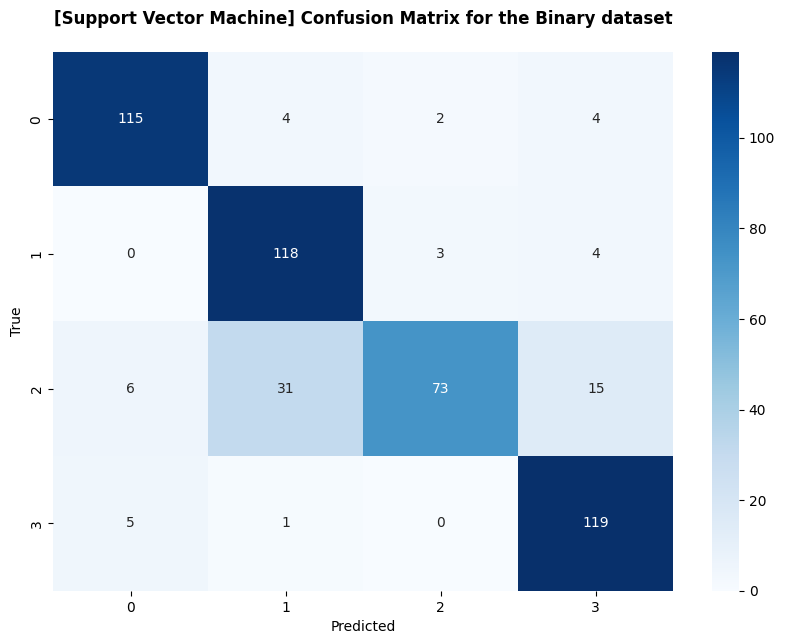

In [26]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainBinaryReducedGAN, yTrainBinaryReducedGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestBinary)
yProb = svm.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/SVM_GAN_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Support Vector Machine', path)

#### Logistic Regression

LR CTGAN training lasted: 0:00:01.130000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.92      │ 0.95      │ 0.89      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.77      │ 0.87      │ 0.94      │ 0.86      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.92      │ 0.62      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.85      │ 0.89      │ 0.74      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.96      │ 0.98     

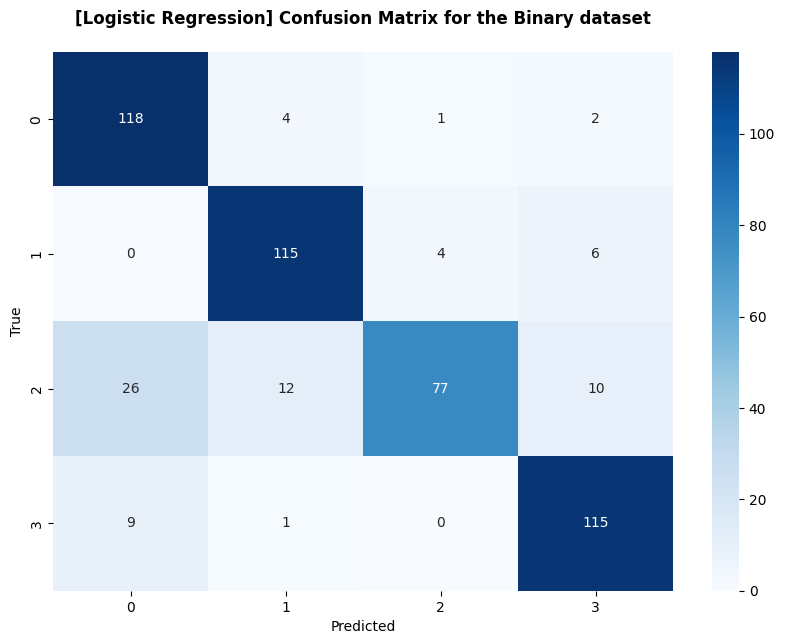

In [27]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainBinaryReducedGAN, yTrainBinaryReducedGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestBinary)
yProb = lr.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/LR_GAN_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Logistic Regression', path)

### 💣 [CTGAN] Categorical

In [28]:
xTrainCategoricalReducedGAN, yTrainCategoricalReducedGAN = applyCTGAN(trainingSetCategoricalReduced, 'Datagen1/2A')

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples


The new data distribution is:
					 - Class 0: 486 samples
					 - Class 1: 486 samples
					 - Class 2: 486 samples
					 - Class 3: 486 samples


#### XGBoost

XGBoost CTGAN training lasted: 0:00:01.010000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.90      │ 0.89      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.96      │ 0.73      │ 0.93      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.94      │ 0.60      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.95      │ 0.82      │ 0.73      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.98

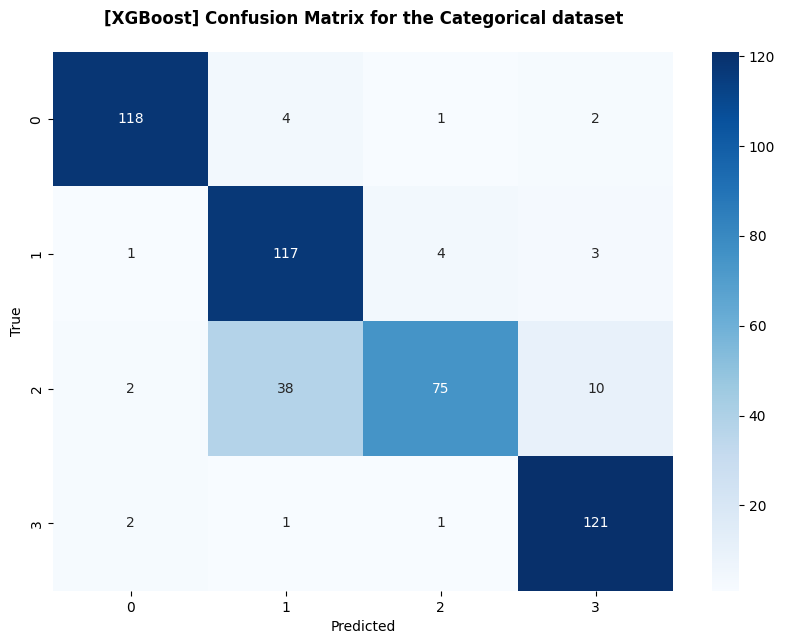

In [29]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainCategoricalReducedGAN, yTrainCategoricalReducedGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestCategorical)
yPredProba = model.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/XGBoost_GAN_'

printPerformances(yPred, yPredProba, yTestBinary, 'Categorical', 'XGBoost', path)

#### Support Vector Machine

SVM CTGAN training lasted: 0:00:01.700000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.93      │ 0.90      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.93      │ 0.82      │ 0.96      │ 0.80      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.96      │ 0.94      │ 0.63      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.94      │ 0.87      │ 0.76      │ 0.86      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.98    

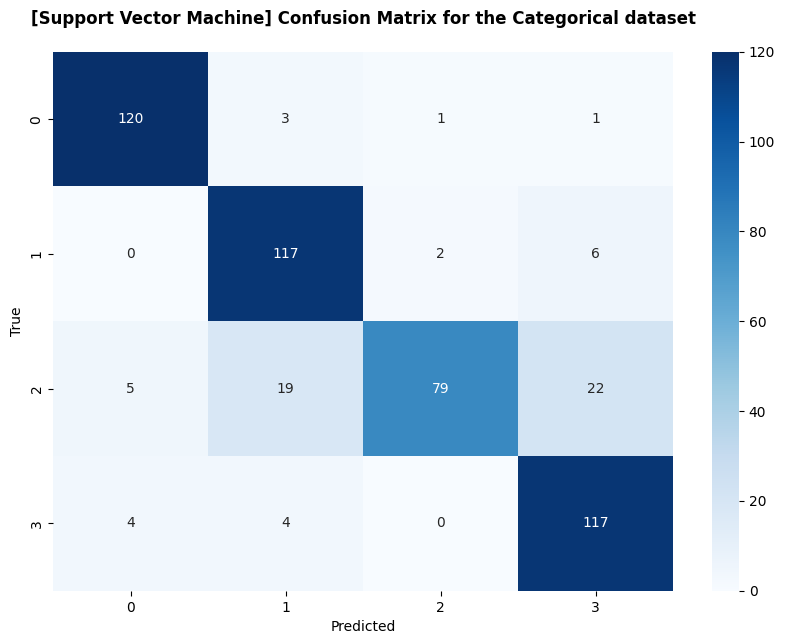

In [30]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainCategoricalReducedGAN, yTrainCategoricalReducedGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestCategorical)
yProb = svm.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/SVM_GAN_'

printPerformances(yPred, yProb, yTestCategorical, 'Categorical', 'Support Vector Machine', path)

#### Logistic Regression

LR CTGAN training lasted: 0:00:06!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.94      │ 0.93      │ 0.87      │ 0.90      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.85      │ 0.83      │ 0.88      │ 0.75      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.92      │ 0.54      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.89      │ 0.87      │ 0.67      │ 0.81      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.96      │ 0.97      │ 0.85

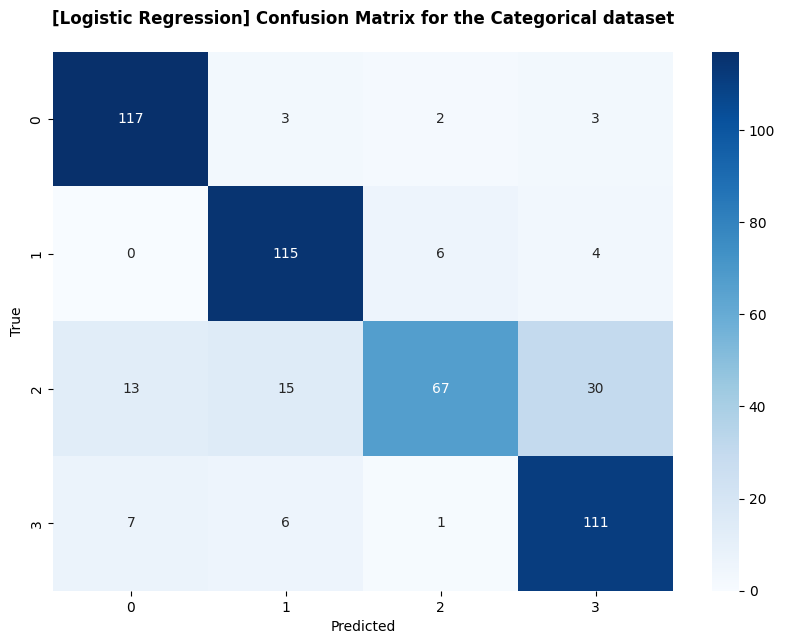

In [31]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainCategoricalReducedGAN, yTrainCategoricalReducedGAN)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestCategorical)
yProb = lr.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/LR_GAN_'

printPerformances(yPred, yProb, yTestBinary, 'Categorical', 'Logistic Regression', path)

## 🅱️ DataGen 2/B

### 🧨 [SMOTE] Binary

In [32]:
xTrainBinaryReduced = trainingSetBinaryReduced.drop(columns = ['label']).to_numpy()
yTrainBinaryReduced = trainingSetBinaryReduced['label'].to_numpy()

xTrainBinaryReducedSMOTE_2, yTrainBinaryReducedSMOTE_2 = applySmote(xTrainBinaryReduced, yTrainBinaryReduced, 'Datagen2B', 300)

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples

The new data distribution is:
					 - Class 0: 690 samples
					 - Class 1: 786 samples
					 - Class 2: 317 samples
					 - Class 3: 511 samples


#### XGBoost

XGBoost SMOTE training lasted: 0:00:00.580000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.94      │ 0.90      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.96      │ 0.81      │ 0.97      │ 0.80      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.98      │ 0.61      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.96      │ 0.89      │ 0.75      │ 0.86      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.99

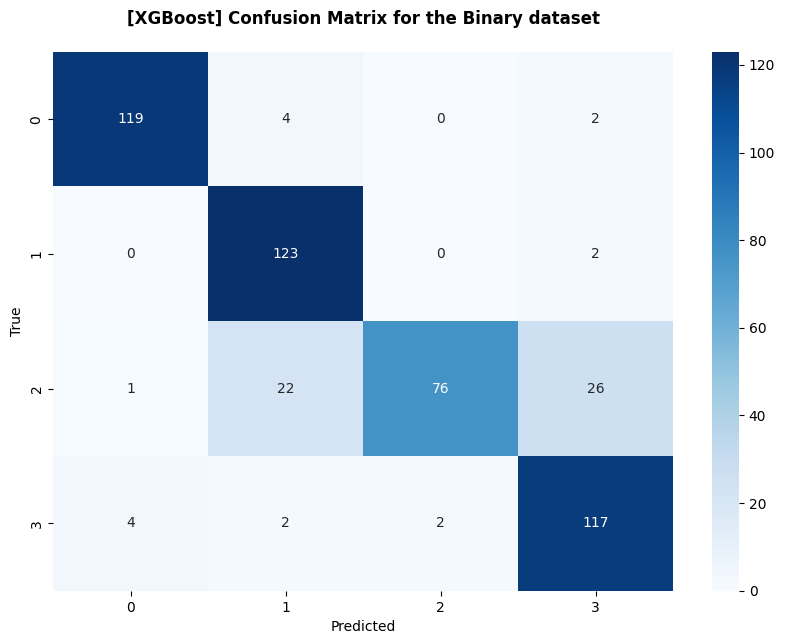

In [33]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainBinaryReducedSMOTE_2, yTrainBinaryReducedSMOTE_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestBinary)
yPredProba = model.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/XGBoost_SMOTE_'

printPerformances(yPred, yPredProba, yTestBinary, 'Binary', 'XGBoost', path)

#### Support Vector Machine

SVM SMOTE training lasted: 0:00:00.580000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.92      │ 0.88      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.95      │ 0.77      │ 0.94      │ 0.81      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.96      │ 0.98      │ 0.54      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.96      │ 0.87      │ 0.69      │ 0.87      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.99    

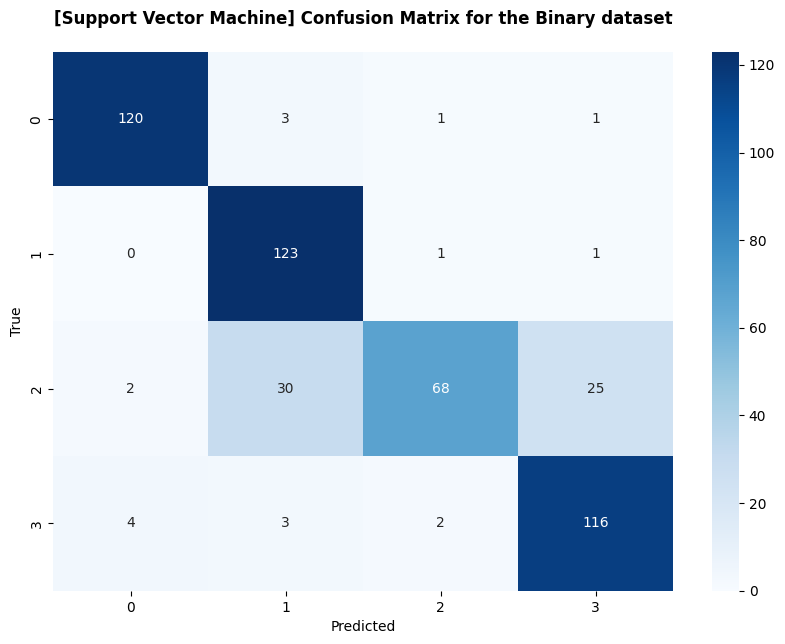

In [34]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainBinaryReducedSMOTE_2, yTrainBinaryReducedSMOTE_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestBinary)
yProb = svm.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/SVM_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Support Vector Machine', path)

#### Logistic Regression

LR SMOTE training lasted: 0:00:01.580000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.97      │ 0.95      │ 0.94      │ 0.95      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.94      │ 0.85      │ 0.97      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.97      │ 0.77      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.94      │ 0.91      │ 0.86      │ 0.91      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.97     

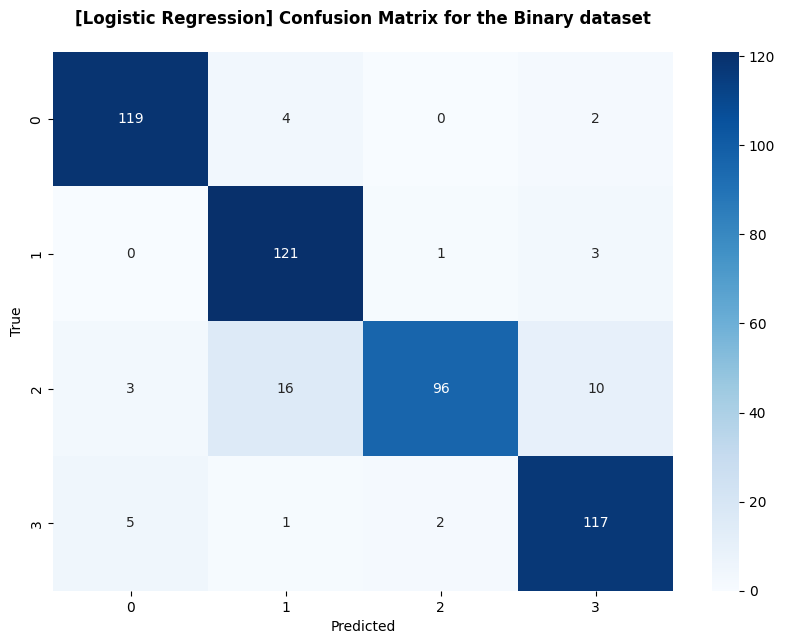

In [35]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainBinaryReducedSMOTE_2, yTrainBinaryReducedSMOTE_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestBinary)
yProb = lr.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/LR_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Logistic Regression', path)

### 🧨 [SMOTE] Categorical

In [36]:
xTrainCategoricalReduced = trainingSetCategoricalReduced.drop(columns = ['label']).to_numpy()
yTrainCategoricalReduced = trainingSetCategoricalReduced['label'].to_numpy()

xTrainCategoricalReducedSMOTE_2, yTrainCategoricalReducedSMOTE_2 = applySmote(xTrainCategoricalReduced, yTrainCategoricalReduced,
                                                                              'Datagen2B', 300)

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples

The new data distribution is:
					 - Class 0: 690 samples
					 - Class 1: 786 samples
					 - Class 2: 317 samples
					 - Class 3: 511 samples


#### XGBoost

XGBoost SMOTE training lasted: 0:00:00.750000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.92      │ 0.90      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.98      │ 0.78      │ 0.93      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.96      │ 0.66      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.97      │ 0.86      │ 0.78      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.99

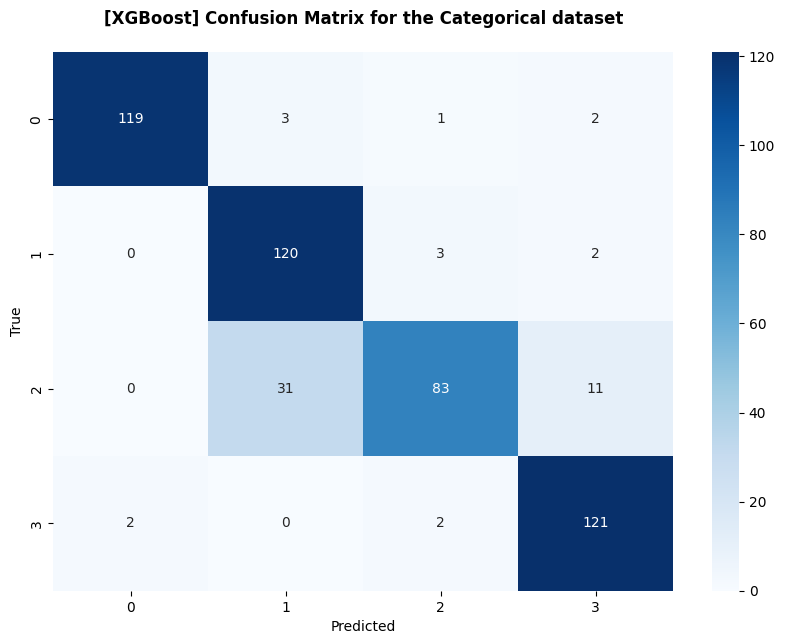

In [37]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainCategoricalReducedSMOTE_2, yTrainCategoricalReducedSMOTE_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestCategorical)
yPredProba = model.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/XGBoost_SMOTE_'

printPerformances(yPred, yPredProba, yTestBinary, 'Categorical', 'XGBoost', path)

#### Support Vector Machine

SVM SMOTE training lasted: 0:00:00.680000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.80      │ 0.80      │ 0.86      │ 0.66      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.93      │ 0.65      │ 0.73      │ 0.42      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.20      │ 0.41      │ 0.68      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.33      │ 0.50      │ 0.70      │ 0.58      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.95      │ 0.92    

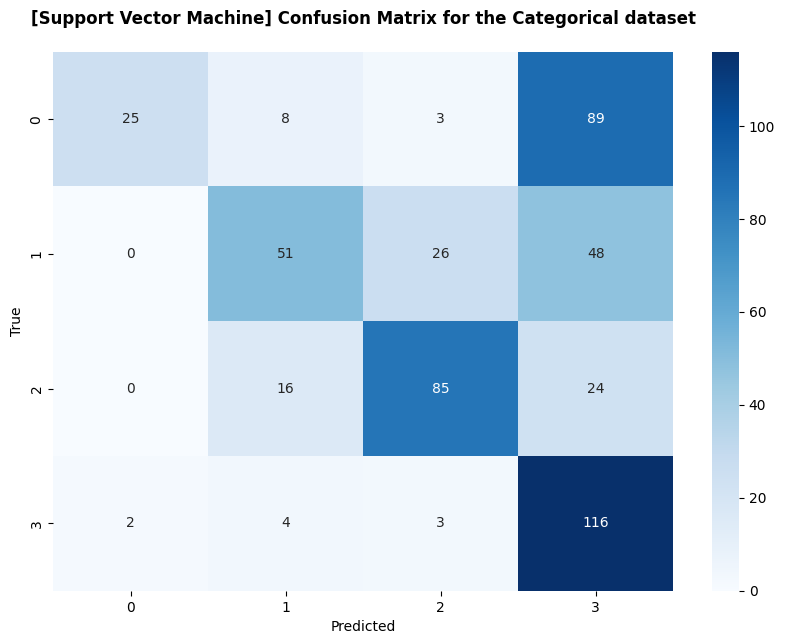

In [38]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainCategoricalReducedSMOTE_2, yTrainCategoricalReducedSMOTE_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestBinary)
yProb = svm.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/SVM_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Categorical', 'Support Vector Machine', path)

#### Logistic Regression

LR SMOTE training lasted: 0:00:05.620000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.90      │ 0.94      │ 0.95      │ 0.90      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.94      │ 0.83      │ 0.99      │ 0.72      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.64      │ 0.97      │ 0.81      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.76      │ 0.89      │ 0.89      │ 0.82      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.96     

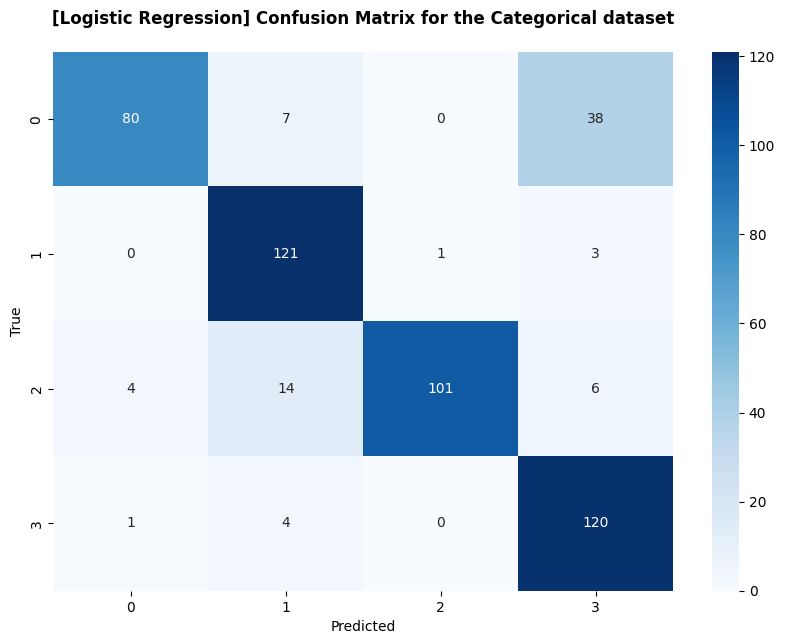

In [39]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainCategoricalReducedSMOTE_2, yTrainCategoricalReducedSMOTE_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR SMOTE training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestBinary)
yProb = lr.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/LR_SMOTE_'

printPerformances(yPred, yProb, yTestBinary, 'Categorical', 'Logistic Regression', path)

### 💣 [CTGAN] Binary

In [40]:
xTrainBinaryReducedGAN_2, yTrainBinaryReducedGAN_2 = applyCTGAN(trainingSetBinaryReduced, 'Datagen2B', 300)

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples


The new data distribution is:
					 - Class 0: 690 samples
					 - Class 1: 786 samples
					 - Class 2: 317 samples
					 - Class 3: 511 samples


#### XGBoost

XGBoost CTGAN training lasted: 0:00:00.820000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.89      │ 0.89      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.96      │ 0.72      │ 0.97      │ 0.88      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.95      │ 0.58      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.95      │ 0.82      │ 0.72      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.98

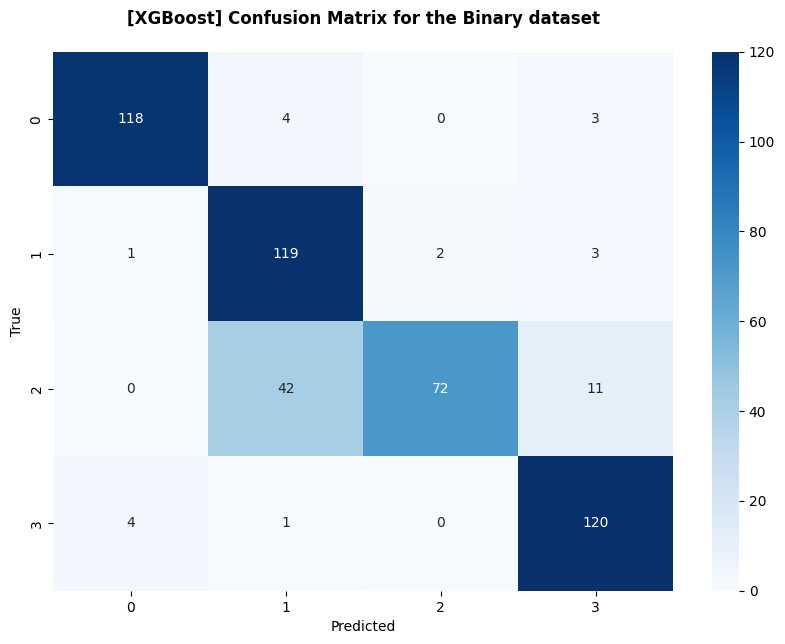

In [41]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainBinaryReducedGAN_2, yTrainBinaryReducedGAN_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestBinary)
yPredProba = model.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/XGBoost_GAN_'

printPerformances(yPred, yPredProba, yTestBinary, 'Binary', 'XGBoost', path)

#### Support Vector Machine

SVM CTGAN training lasted: 0:00:04.070000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.96      │ 0.89      │ 0.88      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.89      │ 0.72      │ 0.96      │ 0.92      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.94      │ 0.56      │ 0.95      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.92      │ 0.82      │ 0.71      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.98      │ 0.97    

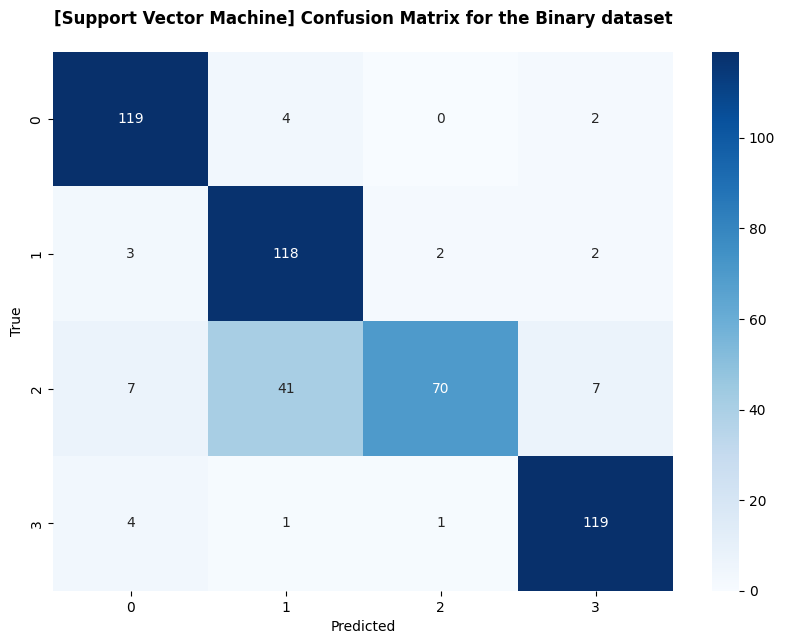

In [42]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainBinaryReducedGAN_2, yTrainBinaryReducedGAN_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestBinary)
yProb = svm.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/SVM_GAN_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Support Vector Machine', path)

#### Logistic Regression

LR CTGAN training lasted: 0:00:02!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.93      │ 0.88      │ 0.84      │ 0.90      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.80      │ 0.69      │ 0.98      │ 0.78      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.95      │ 0.92      │ 0.36      │ 0.86      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.87      │ 0.79      │ 0.53      │ 0.81      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.96      │ 0.91

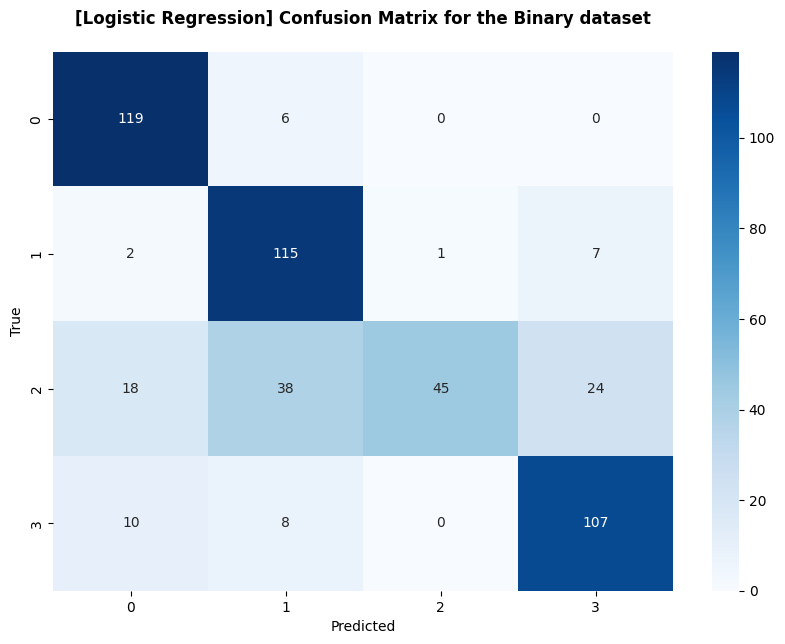

In [43]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Binary_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainBinaryReducedGAN_2, yTrainBinaryReducedGAN_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestBinary)
yProb = lr.predict_proba(xTestBinary)

path = '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/LR_GAN_'

printPerformances(yPred, yProb, yTestBinary, 'Binary', 'Logistic Regression', path)

### 💣 [CTGAN] Categorical

In [44]:
xTrainCategoricalReducedGAN_2, yTrainCategoricalReducedGAN_2 = applyCTGAN(trainingSetCategoricalReduced, 'Datagen2B', 300)

The actual data distribution is:
					 - Class 0: 390 samples
					 - Class 1: 486 samples
					 - Class 2: 17 samples
					 - Class 3: 211 samples


The new data distribution is:
					 - Class 0: 690 samples
					 - Class 1: 786 samples
					 - Class 2: 317 samples
					 - Class 3: 511 samples


#### XGBoost

XGBoost CTGAN training lasted: 0:00:01.210000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.98      │ 0.89      │ 0.88      │ 0.97      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.97      │ 0.70      │ 0.98      │ 0.89      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.98      │ 0.52      │ 0.98      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.95      │ 0.81      │ 0.68      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.99      │ 0.98

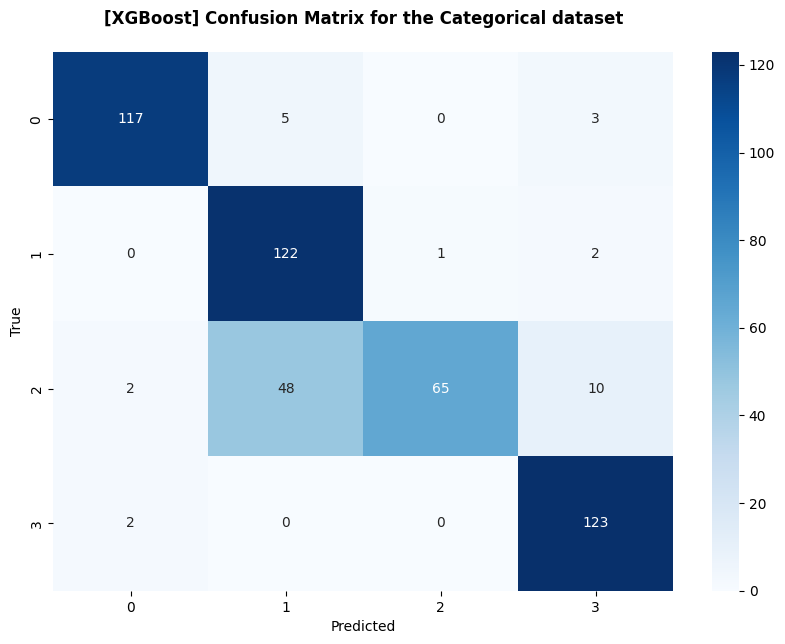

In [45]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

t0 = time.time()
model.fit(xTrainCategoricalReducedGAN_2, yTrainCategoricalReducedGAN_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"XGBoost CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = model.predict(xTestCategorical)
yPredProba = model.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/XGBoost_GAN_'

printPerformances(yPred, yPredProba, yTestBinary, 'Categorical', 'XGBoost', path)

#### Support Vector Machine

SVM CTGAN training lasted: 0:00:04.080000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.96      │ 0.93      │ 0.92      │ 0.96      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.91      │ 0.79      │ 0.99      │ 0.91      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.93      │ 0.98      │ 0.70      │ 0.94      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.92      │ 0.87      │ 0.82      │ 0.93      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.97      │ 0.97    

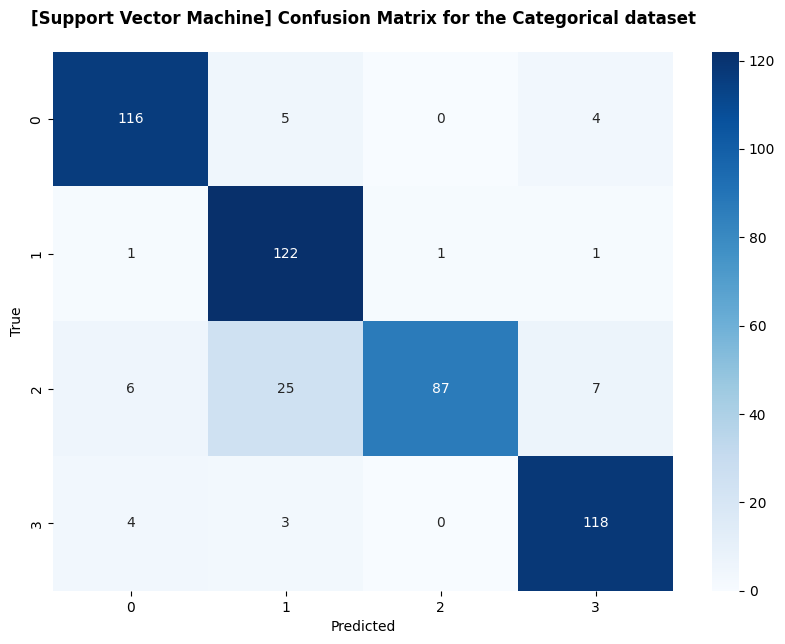

In [46]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

t0 = time.time()
svm.fit(xTrainCategoricalReducedGAN_2, yTrainCategoricalReducedGAN_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"SVM CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = svm.predict(xTestCategorical)
yProb = svm.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/SVM_GAN_'

printPerformances(yPred, yProb, yTestCategorical, 'Categorical', 'Support Vector Machine', path)

#### Logistic Regression

LR CTGAN training lasted: 0:00:05.670000!
╒═════════════════════╤═══════════╤═══════════╤═══════════╤═══════════╤══════════╕
│                     │ Class 0   │ Class 1   │ Class 2   │ Class 3   │ Global   │
╞═════════════════════╪═══════════╪═══════════╪═══════════╪═══════════╪══════════╡
│ Accuracy Per-Class  │ 0.90      │ 0.91      │ 0.85      │ 0.87      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Precision Per-Class │ 0.73      │ 0.74      │ 0.98      │ 0.74      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ Recall Per-Class    │ 0.94      │ 0.96      │ 0.39      │ 0.76      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ F1-Score Per-Class  │ 0.82      │ 0.84      │ 0.56      │ 0.75      │ /        │
├─────────────────────┼───────────┼───────────┼───────────┼───────────┼──────────┤
│ AUC Per-Class       │ 0.96      │ 0.95     

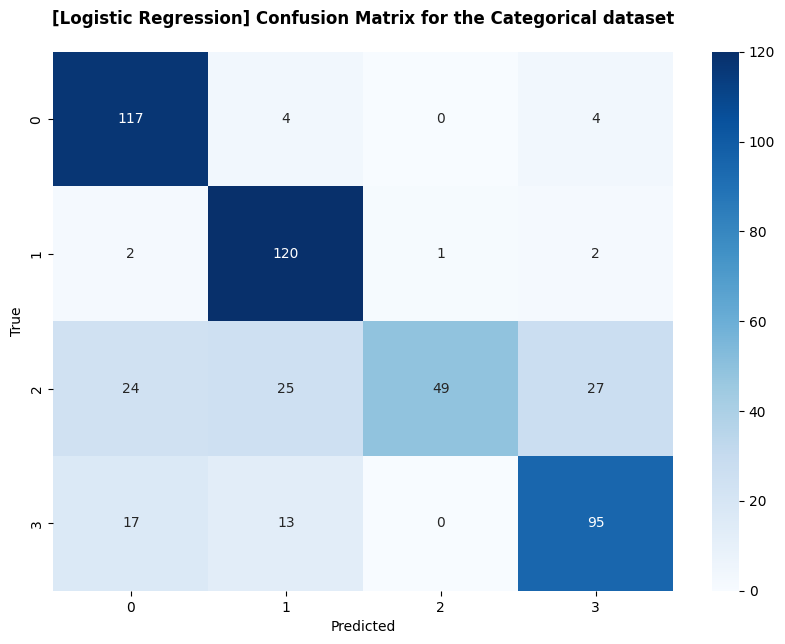

In [47]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/LR_Categorical_DataGen2'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

lr = LogisticRegression(multi_class = 'multinomial',
                        solver = bestParameters['solver'],
                        max_iter = bestParameters['maxIteration'],
                        C = bestParameters['C'])

t0 = time.time()
lr.fit(xTrainCategoricalReducedGAN_2, yTrainCategoricalReducedGAN_2)
t1 = time.time()
duration = round(t1 - t0, 2)
print(f"LR CTGAN training lasted: {str(datetime.timedelta(seconds = duration))}!")
yPred = lr.predict(xTestCategorical)
yProb = lr.predict_proba(xTestCategorical)

path = '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/LR_GAN_'

printPerformances(yPred, yProb, yTestBinary, 'Categorical', 'Logistic Regression', path)

# ⏱️ Performance Evaluation

In this section, we present a comprehensive analysis of the performances obtained from the models using both baseline and SMOTE/GAN augmentation techniques. <br>The results are categorized based on three data generation scenarios: DataGen1, DataGen2/A, and DataGen2/B. <br>


## Define Functions

### Get files from directory

In [48]:
def getFiles(path):
    # We take all the files in the directory 'path'
    allFiles = glob.glob(os.path.join(path, '*'))

    # Exclude the 'png' files (we also have confusion matrices)
    performanceFiles = [file for file in allFiles if not file.lower().endswith('.png')]

    return performanceFiles

### Sort Files

In [49]:
def orderList(files, useDataGen2 = False):

  order = [
      'XGBoost',
      'SVM',
      'LR',
      'XGBoost_SMOTE_',
      'SVM_SMOTE_',
      'LR_SMOTE_',
      'XGBoost_GAN_',
      'SVM_GAN_',
      'LR_GAN_'
  ]

  if useDataGen2:

        order = [model + '_DataGen2' if i < 3 else model for i, model in enumerate(order)]


  sortedFiles = []

  for model in order:
    for file in files:
      if model in file:
        sortedFiles.append(file)
        break

  return sortedFiles

### Define title format

In [50]:
def formatTitle(names):
    title = ''.join([' ' + char if char.isupper() else char for char in names]).strip()
    words = title.split()

    if 'Global' in words:
        words.remove('Global')
        words.insert(0, 'Global')

    words = ['AUC' if word.lower() == 'auc' else word.capitalize() for word in words]

    return ' '.join(words)

### Plot Metrics

In [51]:
# For Global Metrics
def plotMetric(metricName, performances, modelNames, colors, legendLabels, formattedTitle):
  maxValue = 0
  legendHandles = [plt.Rectangle((0, 0), 1, 1, color = color) for color in colors]

  for i, el in enumerate(performances):
    color = colors[i // 3 % len(colors)]
    value = el[metricName] * 100

    if value > maxValue:
      maxValue = value

    plt.bar(modelNames[i], value, color = color, width = 0.5)
    plt.text(i + 0.02, value + 1, f'{value:.2f} %', ha = 'center', va = 'bottom')

  plt.axhline(y = maxValue, color = 'red', linestyle = ':', linewidth = 1)

  plt.title(formattedTitle, pad = 20, fontweight = 'bold', fontsize = 22)
  plt.xlabel('')
  plt.ylabel('Performance (%)')
  plt.ylim(0, maxValue * 1.2)

  plt.legend(legendHandles, legendLabels, loc = 'lower right')
  plt.tight_layout()

In [52]:
def plotMetricPerClass(metricName, performances, modelNames, colors, legendLabels, formattedTitle, numClasses = 4):

  maxValue = 0
  legendHandles = [plt.Line2D([0], [0], color = color, lw = 2) for color in colors]
  classMarkers = ['o', 's', 'D', '^']
  classHandles = [plt.Line2D([0], [0], color = 'black', marker = classMarkers[i], linestyle = 'None') for i in range(numClasses)]


  for i, el in enumerate(performances):

      color = colors[i // 3 % len(colors)]
      values = el[metricName]

      for class_idx in range(numClasses):

          value = values[class_idx] * 100

          if value > maxValue:
              maxValue = value

          plt.plot(modelNames[i], value, color = color, marker = classMarkers[class_idx], markersize = 7)


  plt.axhline(y=maxValue, color = 'red', linestyle = ':', linewidth = 1)

  plt.title(formattedTitle, pad = 20, fontweight = 'bold', fontsize = 22)
  plt.xlabel('')
  plt.ylabel('Performance (%)')
  plt.ylim(0, maxValue * 1.2)


  plt.legend(classHandles, [f'Class {i}' for i in range(numClasses)], loc = 'best')


  plt.tight_layout()

In [53]:
def printEvaluationPerformance(files, data, formattedTitles, saveFilePath, perClass = False):

  performances = []

  for el in files:
      with open(el, 'r') as json_file:
          performances.append(json.load(json_file))

  modelNames = ['XGBoost', 'SVM', 'LR',
                'XGBoost\n + \nSMOTE', 'SVM\n + \nSMOTE', 'LR\n + \nSMOTE',
                'XGBoost\n + \nGAN', 'SVM\n + \nGAN', 'LR\n + \nGAN']

  colors = ['skyblue', 'lightgreen', '#FFA07A']
  legendLabels = ['Baseline', 'SMOTE', 'GAN']


  if perClass:

    metrics = ['accuracyPerClass', 'precisionPerClass', 'recallPerClass', 'f1PerClass', 'aucPerClass']

  else:

    metrics = ['accuracyGlobal', 'precisionGlobal', 'recallGlobal', 'f1Global', 'aucGlobal']


  plt.figure(figsize = (14, 15))

  for idx, metric in enumerate(metrics):

    plt.subplot(3, 2, idx + 1)

    if perClass:


      plotMetricPerClass(metric, performances, modelNames, colors, legendLabels, formattedTitles[idx], numClasses = 4)

    else:

      plotMetric(metric, performances, modelNames, colors, legendLabels, formattedTitles[idx])

  plt.savefig(saveFilePath)

  plt.subplots_adjust(hspace = 0.4, wspace = 0.15)

  plt.show()

## Evaluation

In [55]:
generalPath = '/content/drive/My Drive/NMDA Lab - Project/'

binaryPath = 'binary_dataset/performance/'
categoricalPath = 'categorical_dataset/performance/'

modelPath = ['datagen1/', 'datagen2a/', 'datagen2b/']

datasetPath = 'actual_dataset/'

In [56]:
dataPerClass = ['accuracyPerClass', 'precisionPerClass', 'recallPerClass', 'f1PerClass', 'aucPerClass']
dataGlobal = ['accuracyGlobal', 'precisionGlobal', 'recallGlobal', 'f1Global', 'aucGlobal']

In [57]:
formattedTitlesPerClass = [formatTitle(el) for el in dataPerClass]
formattedTitlesGlobal = [formatTitle(el) for el in dataGlobal]

### DataGen 1

#### Binary

In [75]:
files = []

# Load files for baselines
path = generalPath + binaryPath + 'baseline/' + datasetPath
files = getFiles(path)

# Load files for the specific dataset
path = generalPath + binaryPath + modelPath[0]  + datasetPath
files += getFiles(path)

files = orderList(files)

files

['/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/XGBoost',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/SVM',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/LR',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/XGBoost_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/SVM_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/LR_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/XGBoost_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/SVM_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen1/actual_dataset/LR_GAN_']

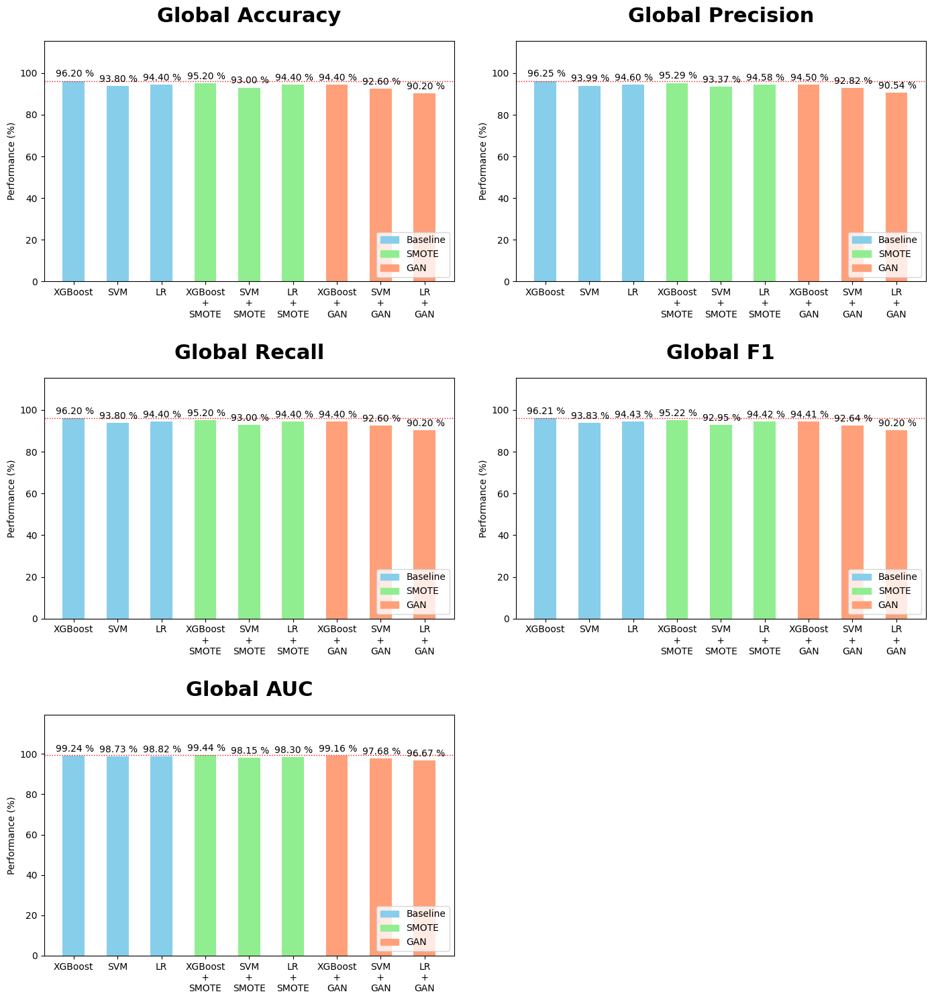

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/binary_datagen1_global.png'

printEvaluationPerformance(files, dataGlobal, formattedTitlesGlobal, path)

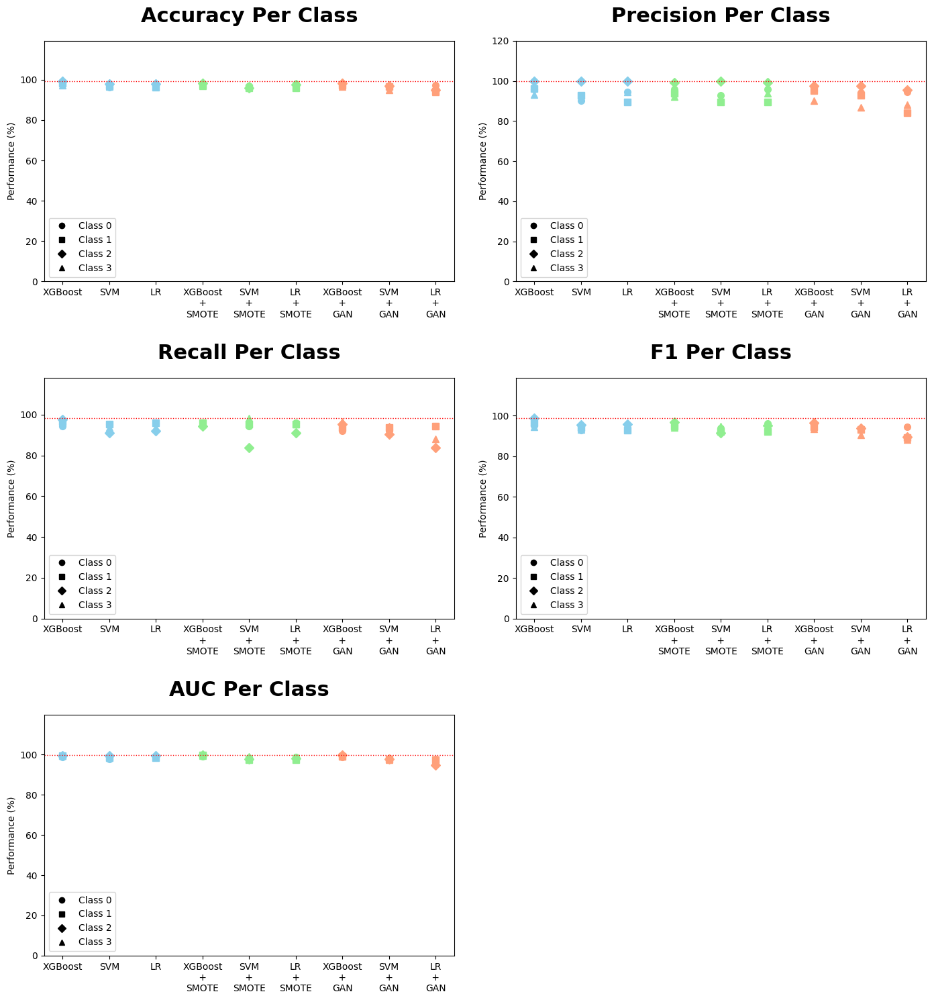

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/binary_datagen1_per_class.png'

printEvaluationPerformance(files, dataPerClass, formattedTitlesPerClass, path, perClass = True)

#### Categorical

In [ ]:
files = []

# Load files for baselines
path = generalPath + categoricalPath + 'baseline/' + datasetPath
files = getFiles(path)

# Load files for the specific dataset
path = generalPath + categoricalPath + modelPath[0]  + datasetPath
files += getFiles(path)

files = orderList(files)

files

['/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/XGBoost',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/SVM',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/LR',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/XGBoost_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/SVM_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/LR_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/XGBoost_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/SVM_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen1/actual_dataset/LR

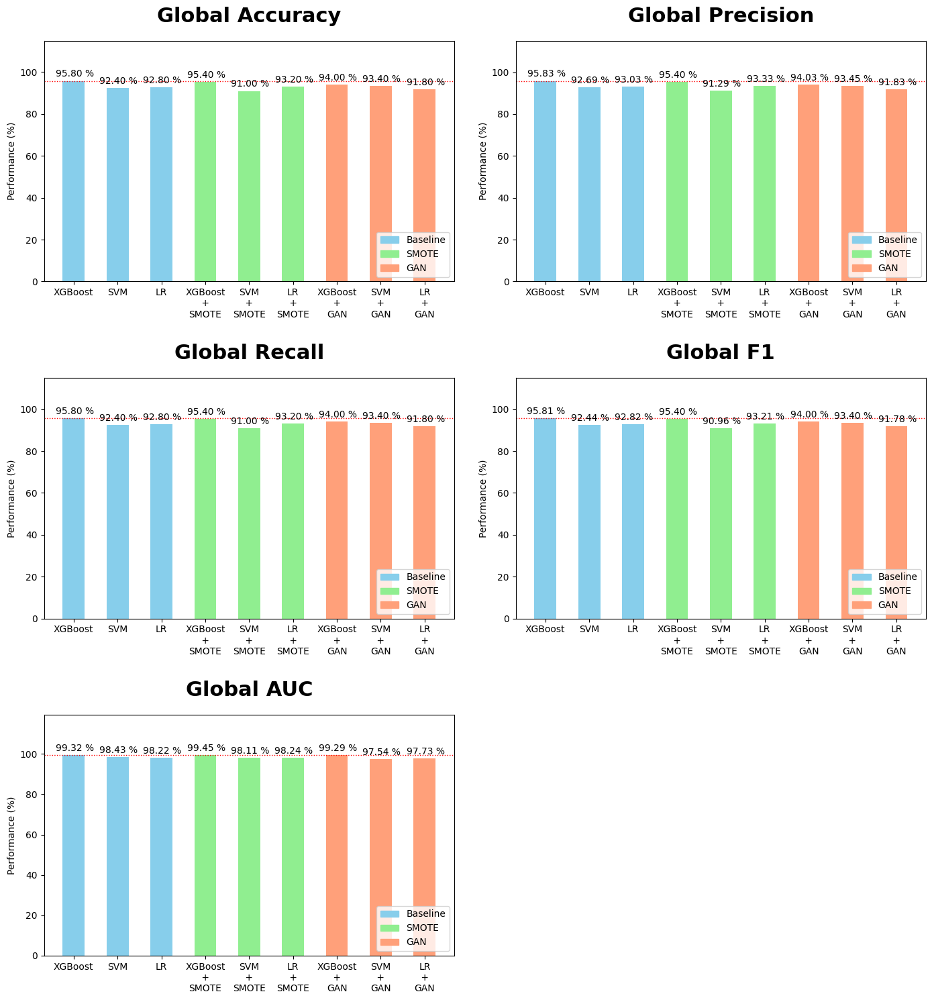

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/categorical_datagen1_global.png'

printEvaluationPerformance(files, dataGlobal, formattedTitlesGlobal, path)

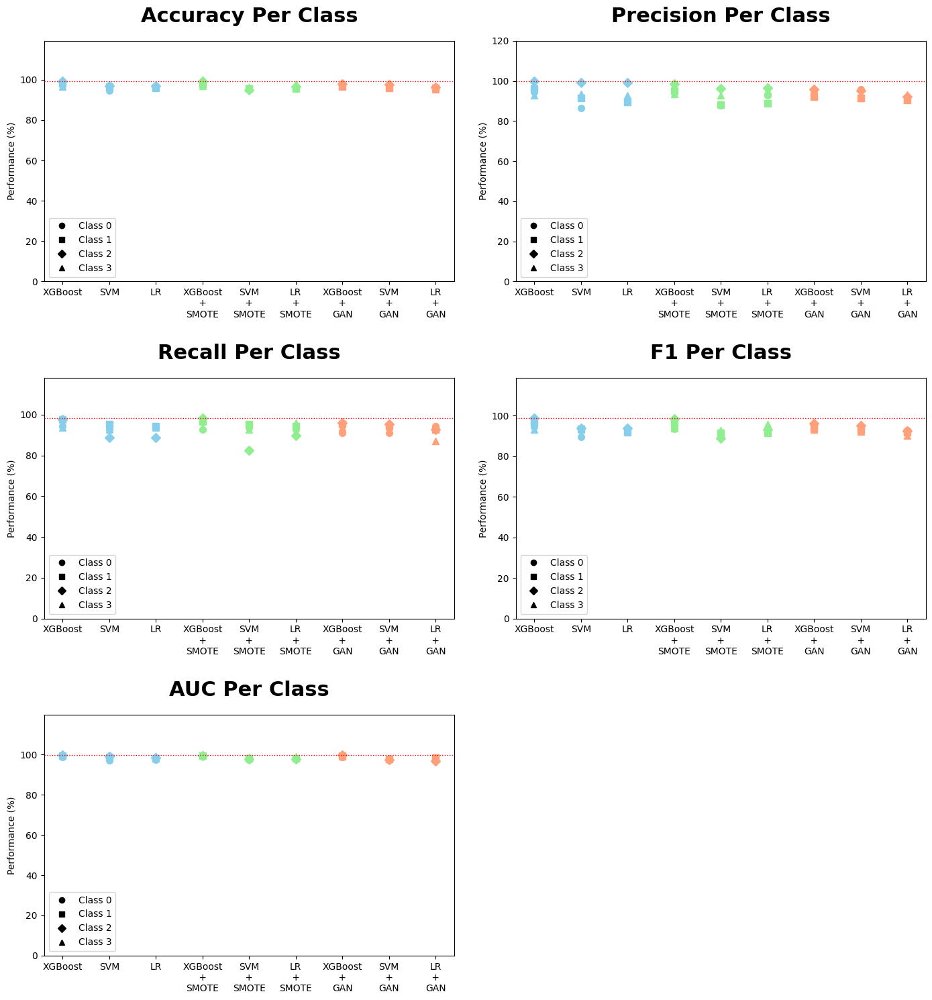

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/categorical_datagen1_per_class.png'

printEvaluationPerformance(files, dataPerClass, formattedTitlesPerClass, path, perClass = True)

### DataGen 2/A

#### Binary

In [58]:
files = []

# Load files for baselines
path = generalPath + binaryPath + 'baseline/' + datasetPath
files = getFiles(path)

# Load files for the specific dataset
path = generalPath + binaryPath + modelPath[1]  + datasetPath
files += getFiles(path)

files = orderList(files, useDataGen2 = True)

files

['/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/XGBoost_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/SVM_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/LR_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/XGBoost_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/SVM_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/LR_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/XGBoost_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/SVM_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2a/actual_dataset/LR_GAN_']

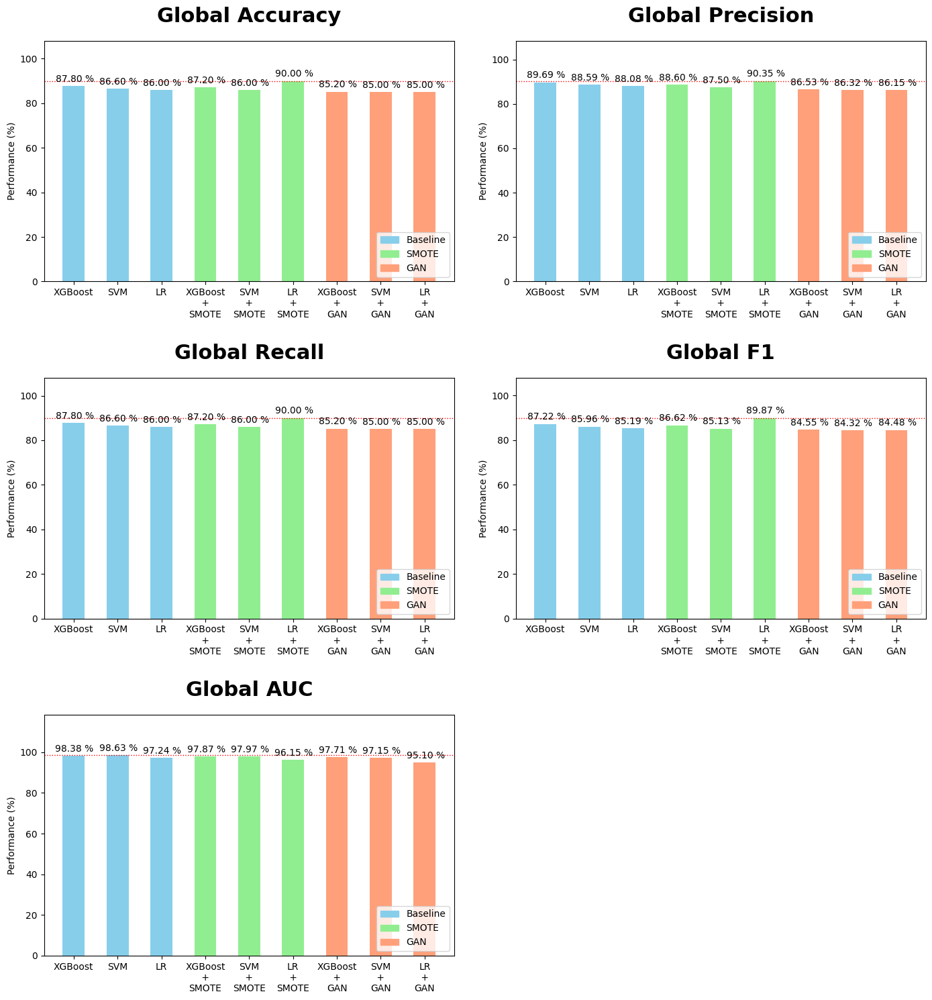

In [59]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/binary_datagen2a_global.png'

printEvaluationPerformance(files, dataGlobal, formattedTitlesGlobal, path)

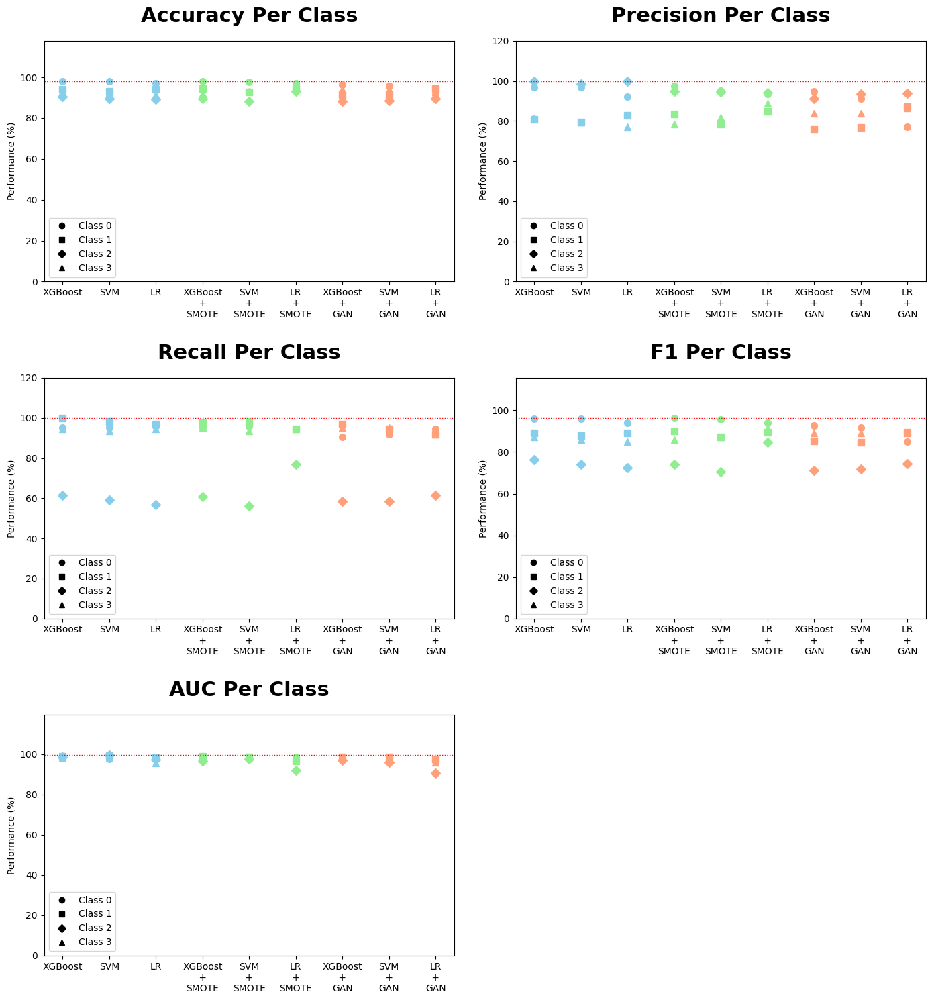

In [60]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/binary_datagen2a_per_class.png'

printEvaluationPerformance(files, dataPerClass, formattedTitlesPerClass, path, perClass = True)

#### Categorical

In [61]:
files = []

# Load files for baselines
path = generalPath + categoricalPath + 'baseline/' + datasetPath
files = getFiles(path)

# Load files for the specific dataset
path = generalPath + categoricalPath + modelPath[1]  + datasetPath
files += getFiles(path)

files = orderList(files, useDataGen2 = True)

files

['/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/XGBoost_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/SVM_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/LR_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/XGBoost_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/SVM_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/LR_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/XGBoost_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2a/actual_dataset/SVM_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/perfor

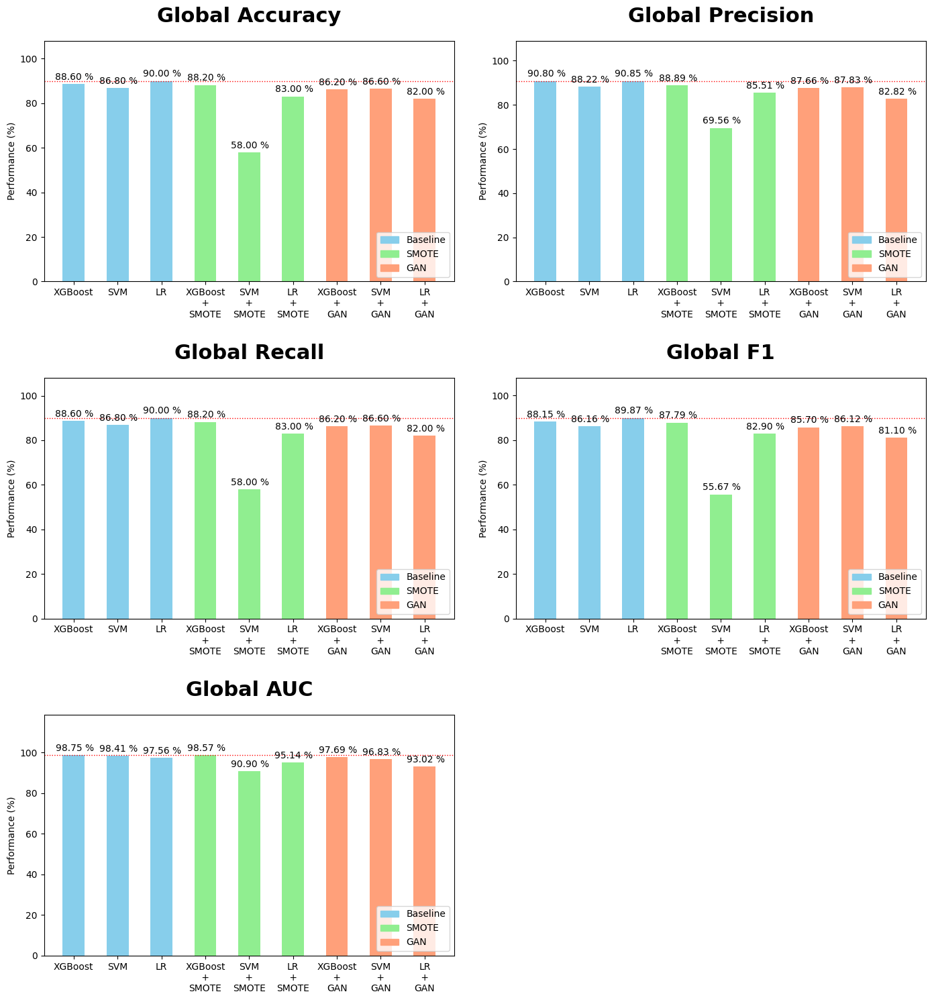

In [62]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/categorical_datagen2a_global.png'

printEvaluationPerformance(files, dataGlobal, formattedTitlesGlobal, path)

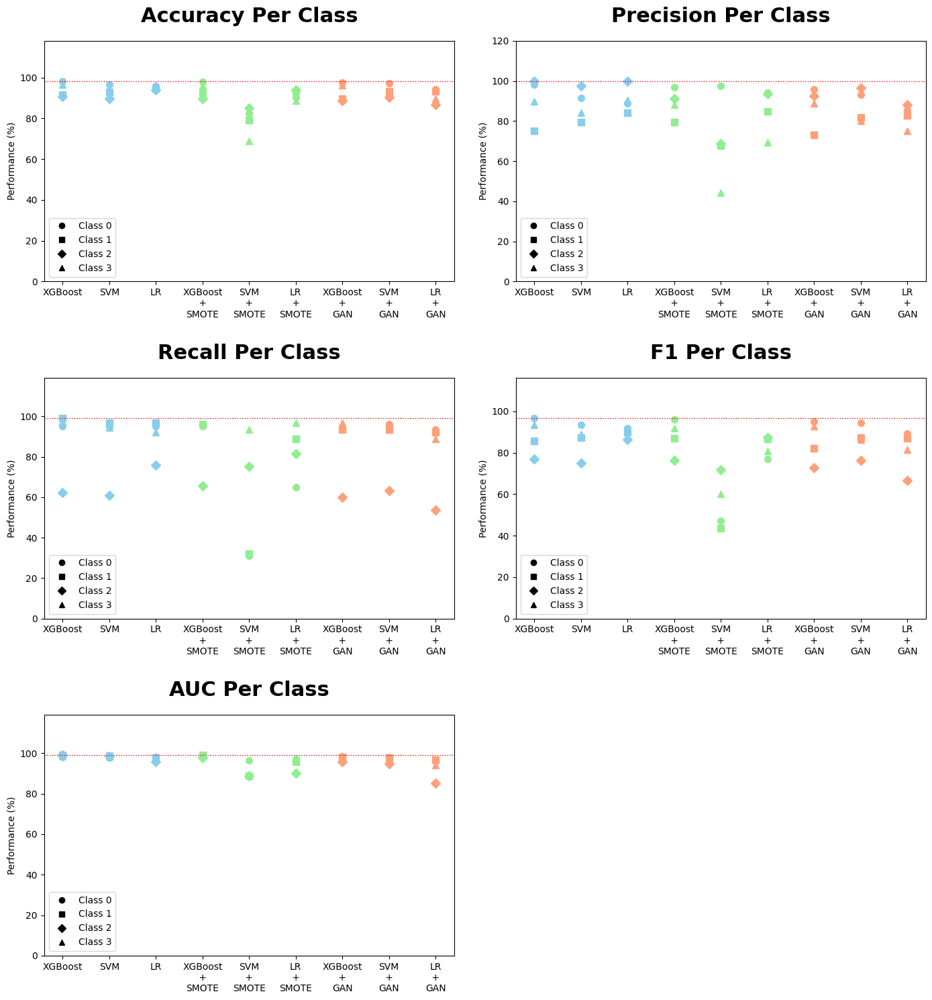

In [63]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/categorical_datagen2a_per_class.png'

printEvaluationPerformance(files, dataPerClass, formattedTitlesPerClass, path, perClass = True)

### DataGen 2/B

#### Binary

In [64]:
files = []

# Load files for baselines
path = generalPath + binaryPath + 'baseline/' + datasetPath
files = getFiles(path)

# Load files for the specific dataset
path = generalPath + binaryPath + modelPath[2]  + datasetPath
files += getFiles(path)

files = orderList(files, useDataGen2 = True)

files

['/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/XGBoost_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/SVM_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/baseline/actual_dataset/LR_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/XGBoost_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/SVM_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/LR_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/XGBoost_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/SVM_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/binary_dataset/performance/datagen2b/actual_dataset/LR_GAN_']

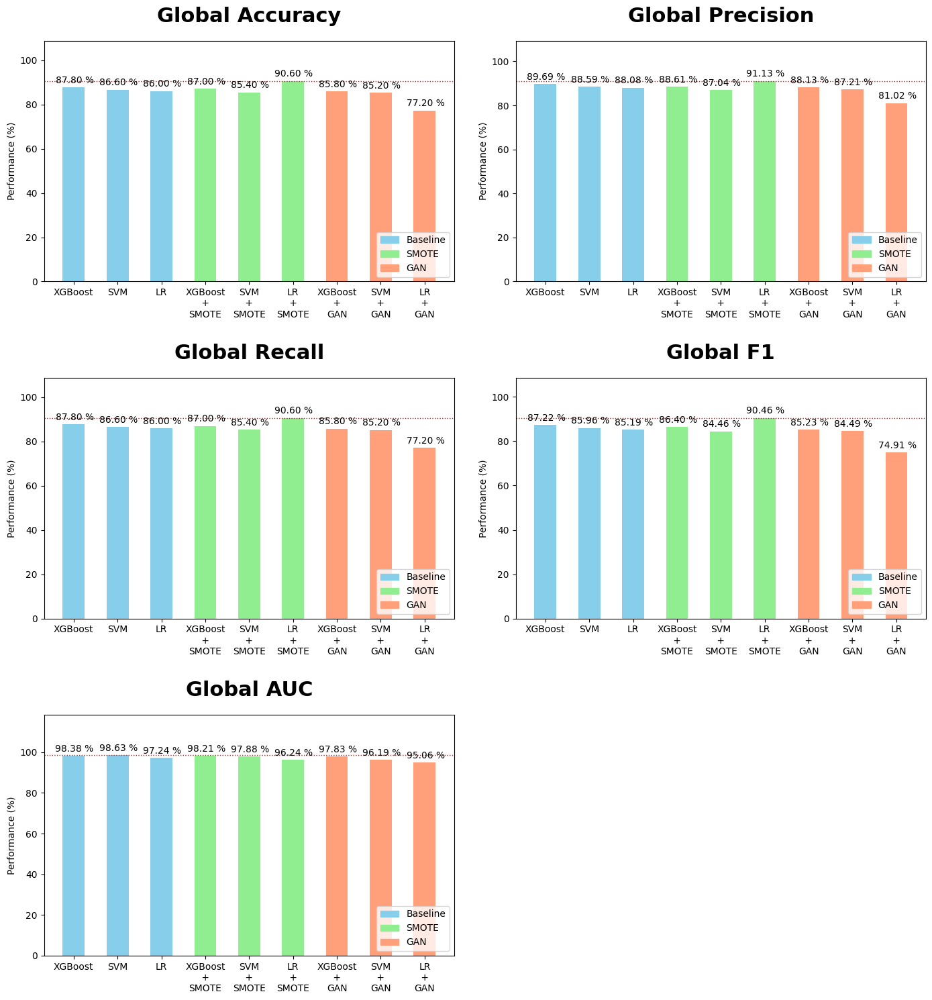

In [65]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/binary_datagen2b_global.png'

printEvaluationPerformance(files, dataGlobal, formattedTitlesGlobal, path)

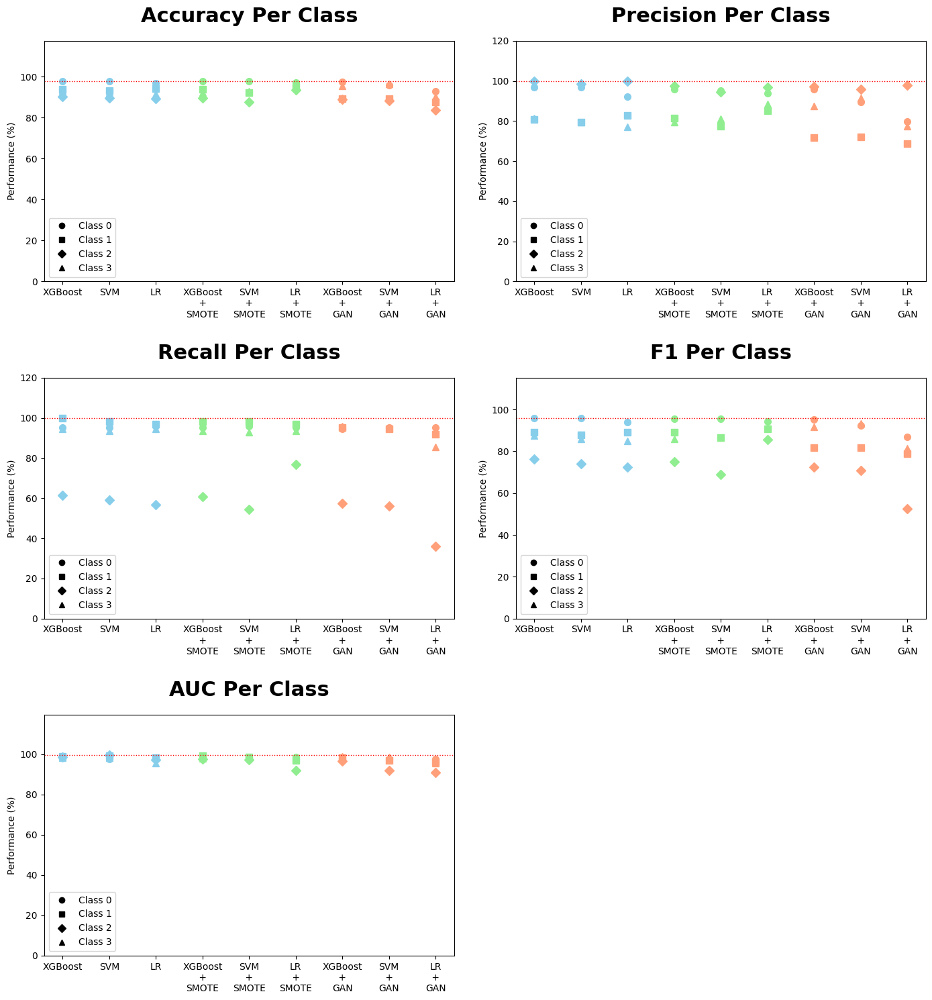

In [66]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/binary_datagen2b_per_class.png'

printEvaluationPerformance(files, dataPerClass, formattedTitlesPerClass, path, perClass = True)

#### Categorical

In [67]:
files = []

# Load files for baselines
path = generalPath + categoricalPath + 'baseline/' + datasetPath
files = getFiles(path)

# Load files for the specific dataset
path = generalPath + categoricalPath + modelPath[2]  + datasetPath
files += getFiles(path)

files = orderList(files, useDataGen2 = True)

files

['/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/XGBoost_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/SVM_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/baseline/actual_dataset/LR_DataGen2',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/XGBoost_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/SVM_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/LR_SMOTE_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/XGBoost_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/performance/datagen2b/actual_dataset/SVM_GAN_',
 '/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/perfor

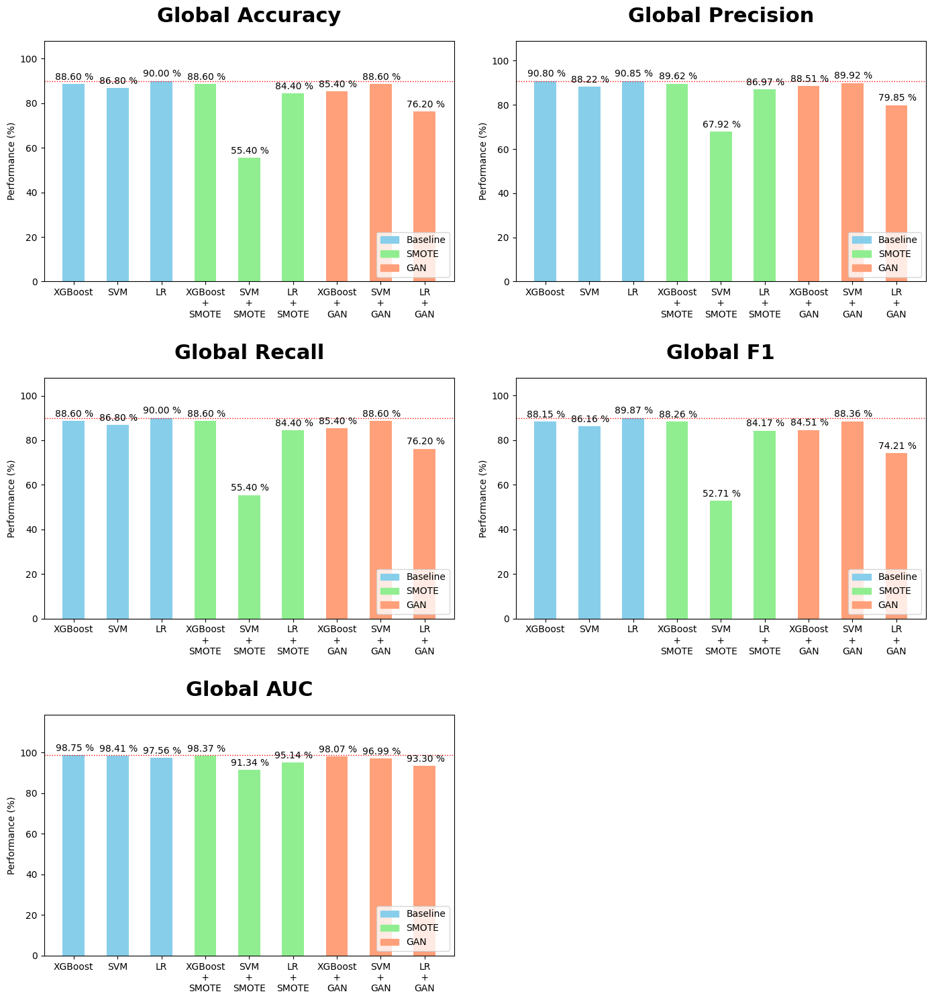

In [68]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/categorical_datagen2b_global.png'

printEvaluationPerformance(files, dataGlobal, formattedTitlesGlobal, path)

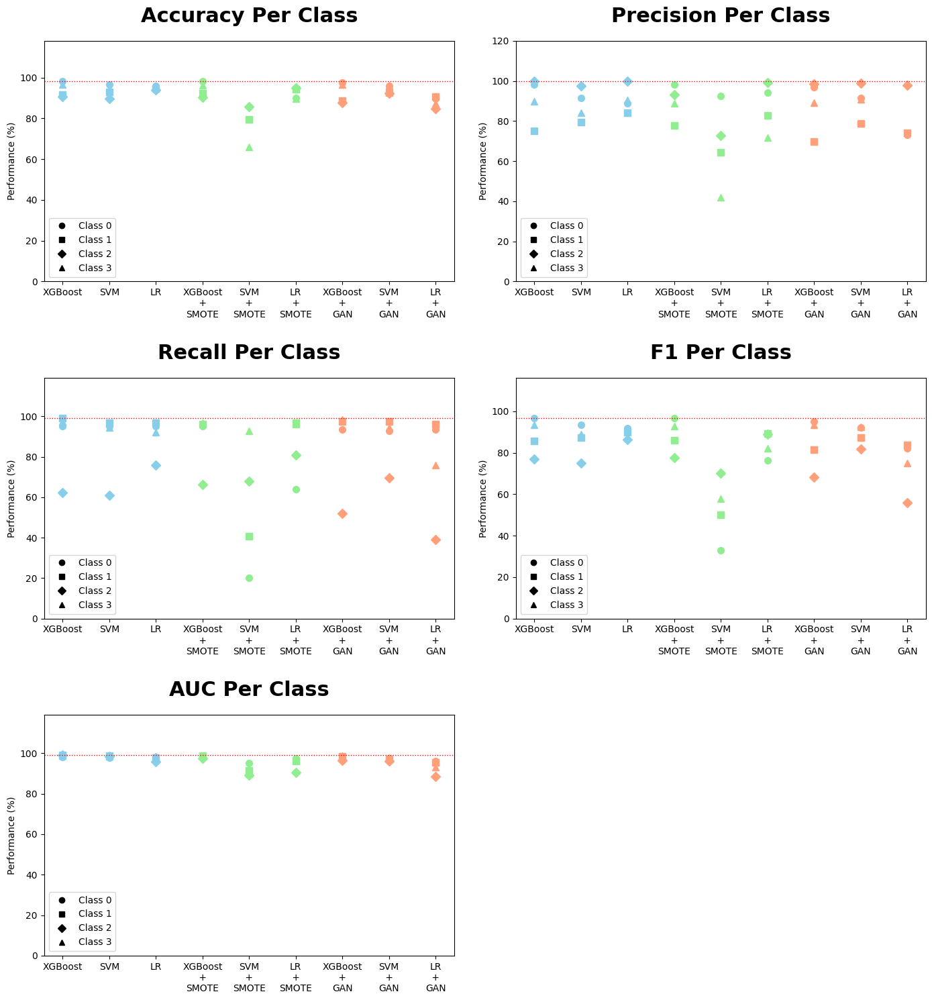

In [69]:
path = '/content/drive/MyDrive/NMDA Lab - Project/performance/categorical_datagen2b_per_class.png'

printEvaluationPerformance(files, dataPerClass, formattedTitlesPerClass, path, perClass = True)

# 🔬 XAI - eXplainable Artificial Intelligence


## SHAP

### Binary

#### XGBoost

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

model.fit(xTrainBinary, yTrainBinary)

binaryDf = pd.read_csv("/content/drive/My Drive/NMDA Lab - Project/binary_dataset/dbinary.csv")
binaryDf.drop(columns = ['label'], inplace = True)

# Obtaining shap values
explainerShap = shap.TreeExplainer(model)
shapValues = explainerShap.shap_values(xTestBinary)

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:160: UserWarning:

[13:50:17] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.



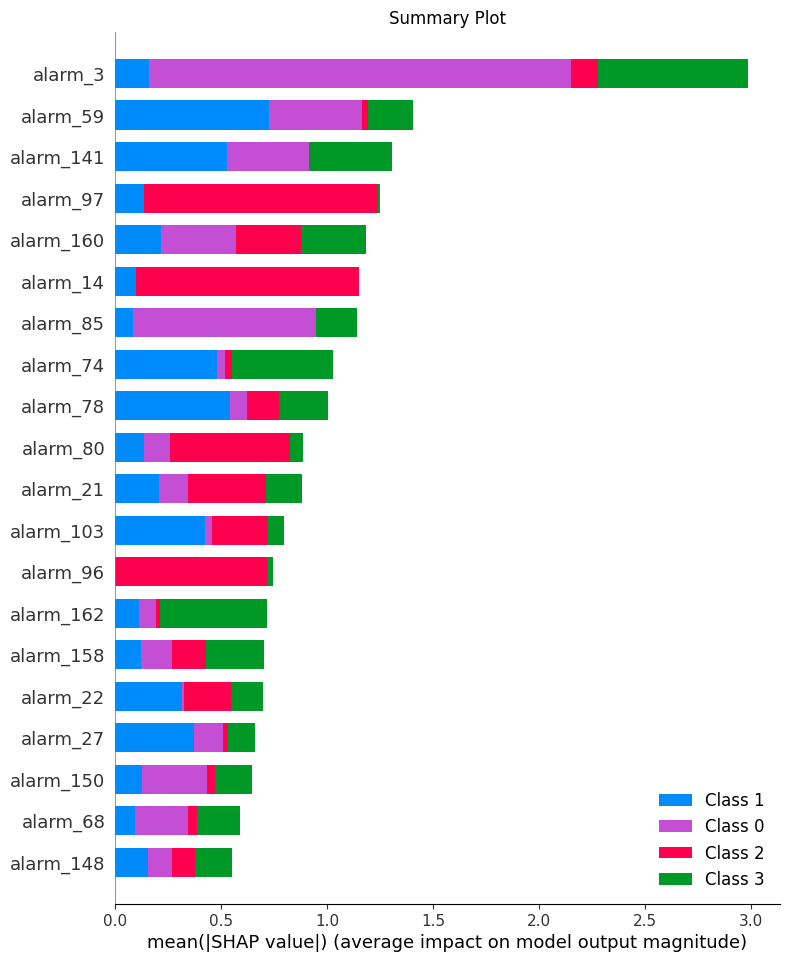

In [ ]:
shap.summary_plot(shapValues, feature_names=list(binaryDf.columns), show = False)
plt.title("Summary Plot")
plt.show()

/usr/local/lib/python3.10/dist-packages/shap/plots/_beeswarm.py:699: UserWarning:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored



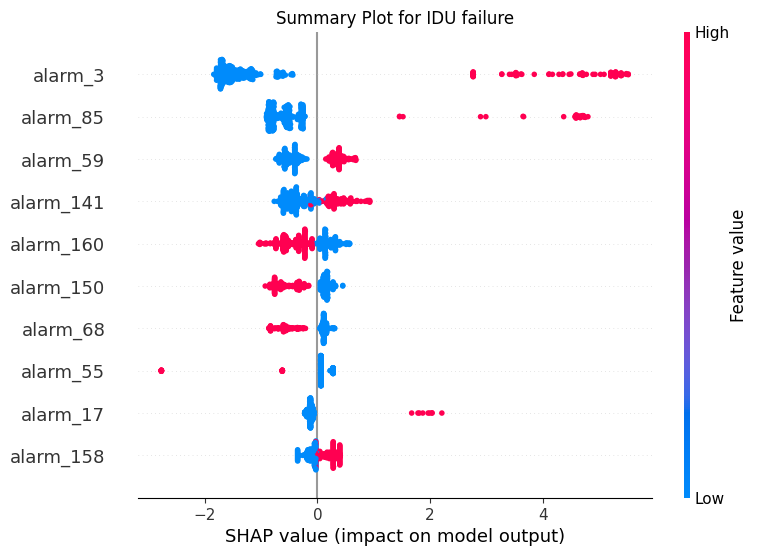

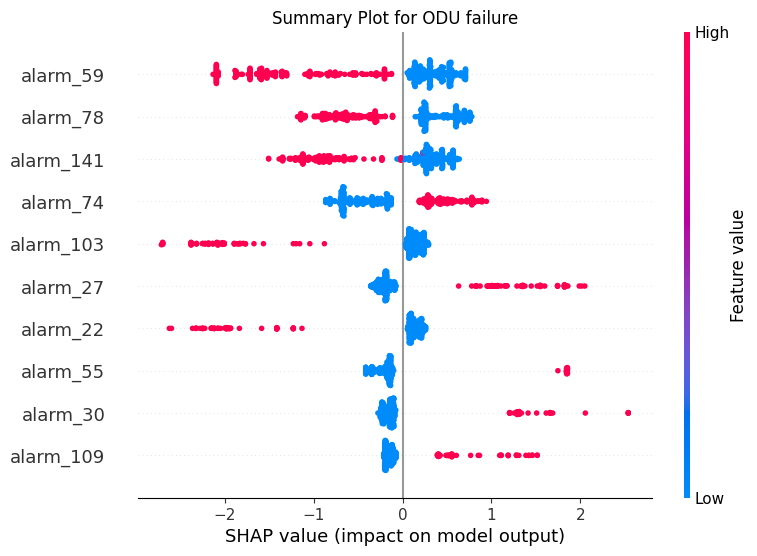

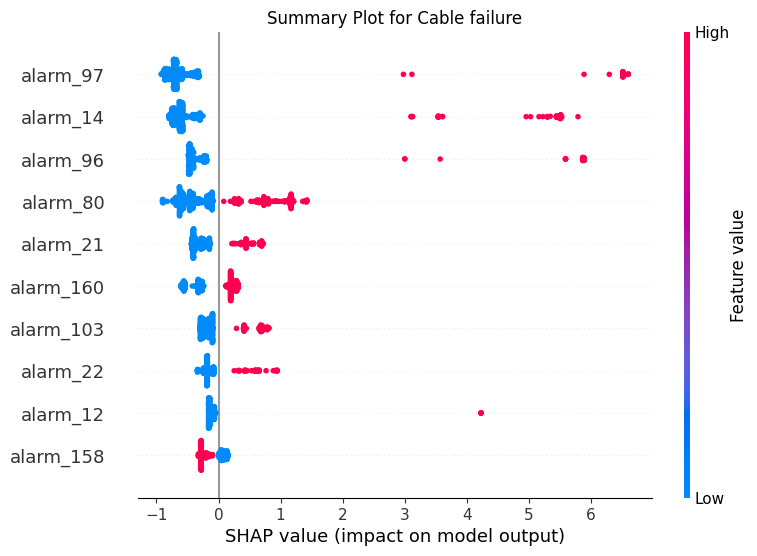

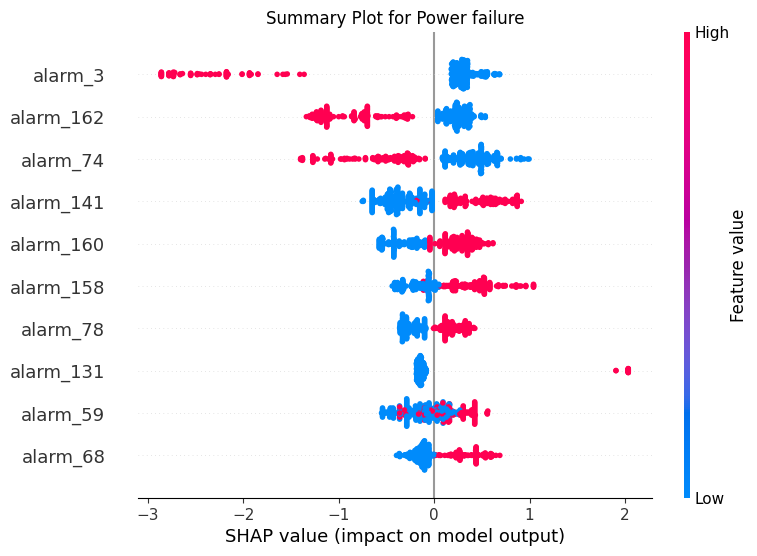

In [ ]:
classNames = ['IDU failure', 'ODU failure', 'Cable failure', 'Power failure']

for classInd in range(len(classNames)):
    shap.summary_plot(shapValues[classInd], features=xTestBinary, feature_names=list(binaryDf.columns),
                      show = False, max_display=10)

    title = 'Summary Plot for ' + str(classNames[classInd])
    plt.title(title)
    plt.show()

In [ ]:
shap.initjs()
shap.force_plot(explainerShap.expected_value[0], shapValues[0], xTestBinary)

#### SVM

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True)

svm.fit(xTrainBinary, yTrainBinary)

SVC(C=1, decision_function_shape='ovo', kernel='linear', probability=True)

In [ ]:
explainer = shap.KernelExplainer(svm.predict, xTestBinary[:2])

shapValues = explainer(xTestBinary)

  0%|          | 0/500 [00:00<?, ?it/s]

********************* Sample 100 ----> Prediction: Class 0, Actual: Class 0 *********************




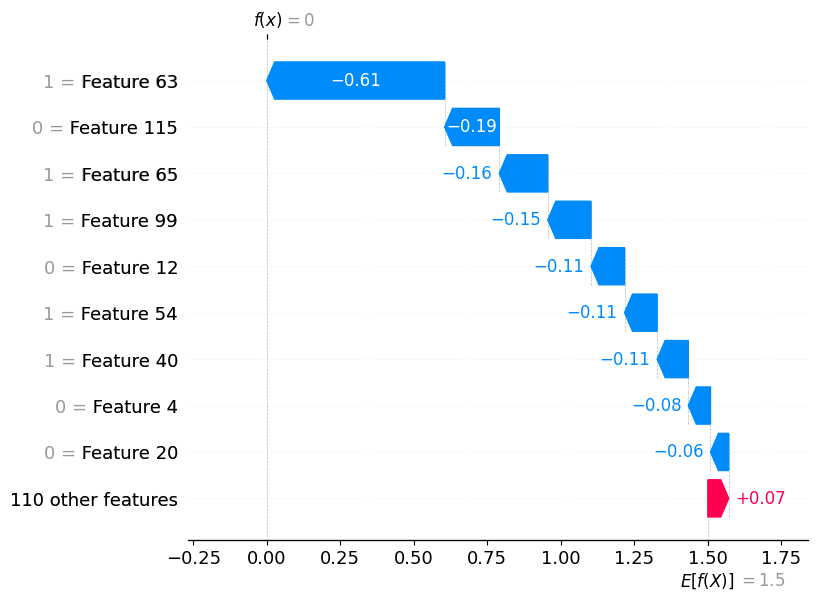

In [ ]:
# idx = 1     (missclassified sample)
idx = 100
predictedClass = svm.predict([xTestBinary[idx]])[0]
actualClass = yTestBinary[idx]

print(f"********************* Sample {idx} ----> Prediction: Class {predictedClass}, Actual: Class {actualClass} *********************\n\n")

shap.plots.waterfall(shapValues[idx], max_display = 10)

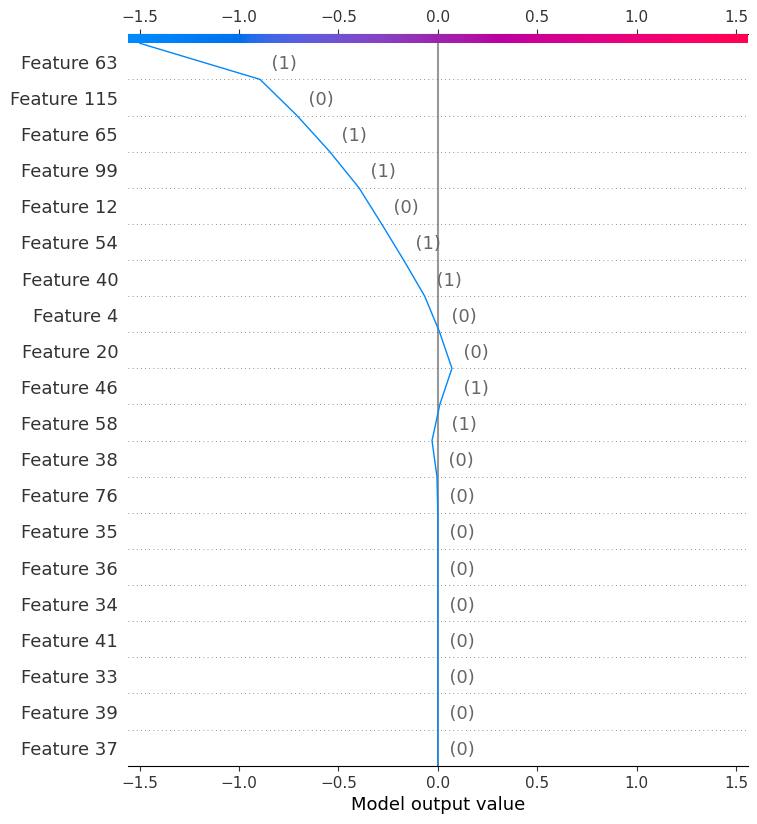

In [ ]:
shapValuesArray = shapValues.values
features = xTestBinary[idx].reshape(1, -1)

shap.decision_plot(predictedClass, shapValuesArray[idx], features)

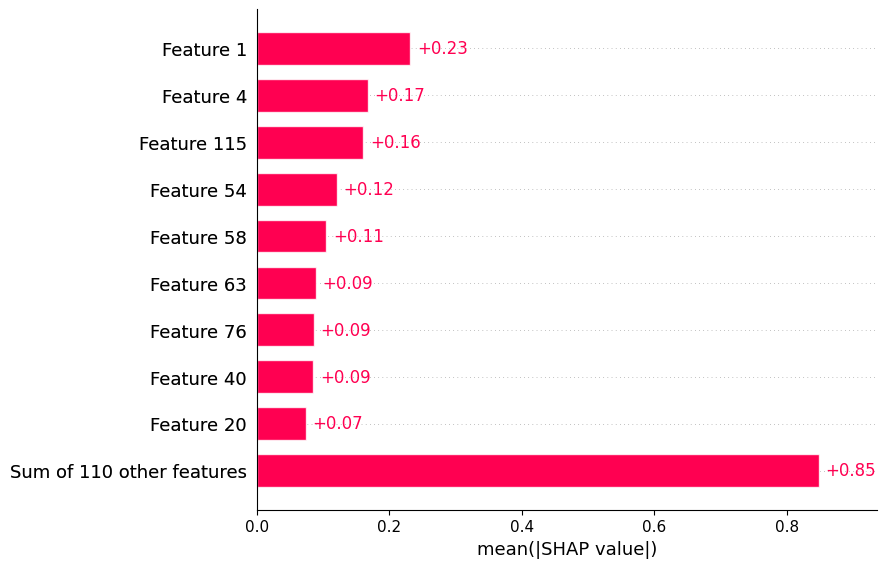

In [ ]:
shap.plots.bar(shapValues)

In [ ]:
explainer = shap.KernelExplainer(svm.predict_proba, xTestBinary[:2])

shapValues = explainer.shap_values(xTestBinary)

  0%|          | 0/500 [00:00<?, ?it/s]

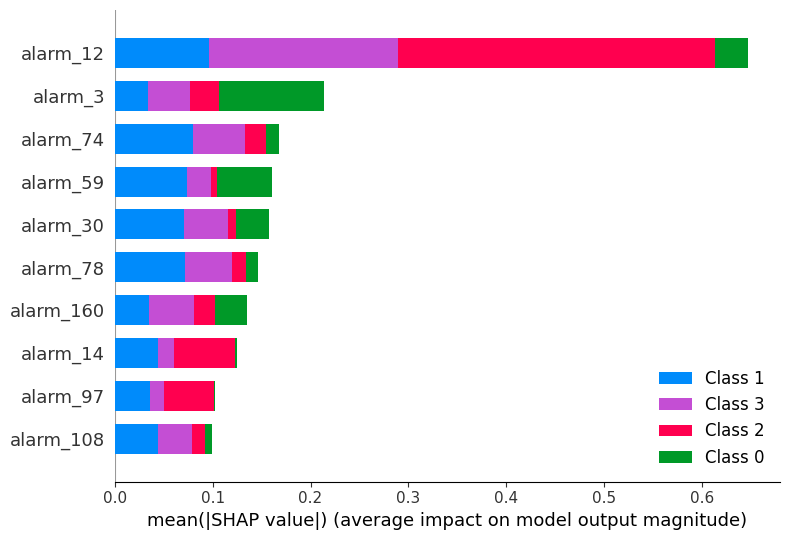

In [ ]:
columns = list(trainingSetBinary.drop(columns = ['label']).columns)

with warnings.catch_warnings():
  warnings.simplefilter("ignore", UserWarning)
  shap.summary_plot(shapValues, xTestBinary, feature_names = columns, max_display = 10)

/usr/local/lib/python3.10/dist-packages/shap/plots/_beeswarm.py:699: UserWarning:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored



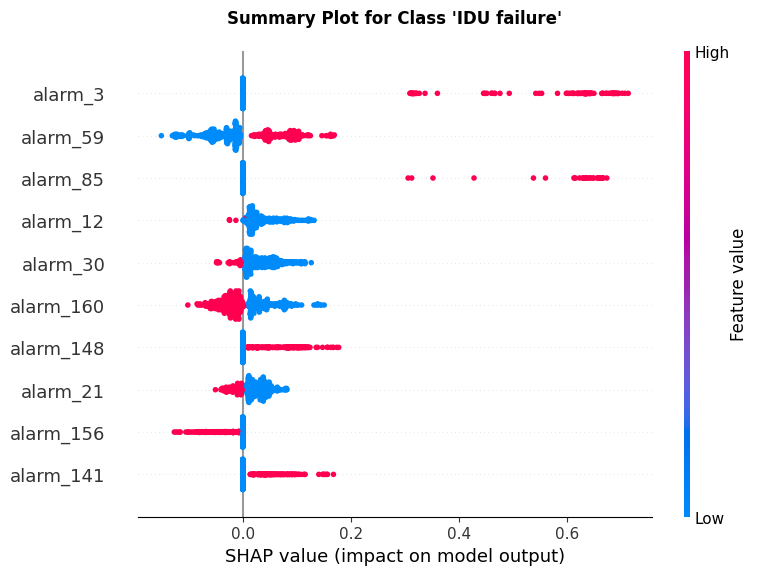

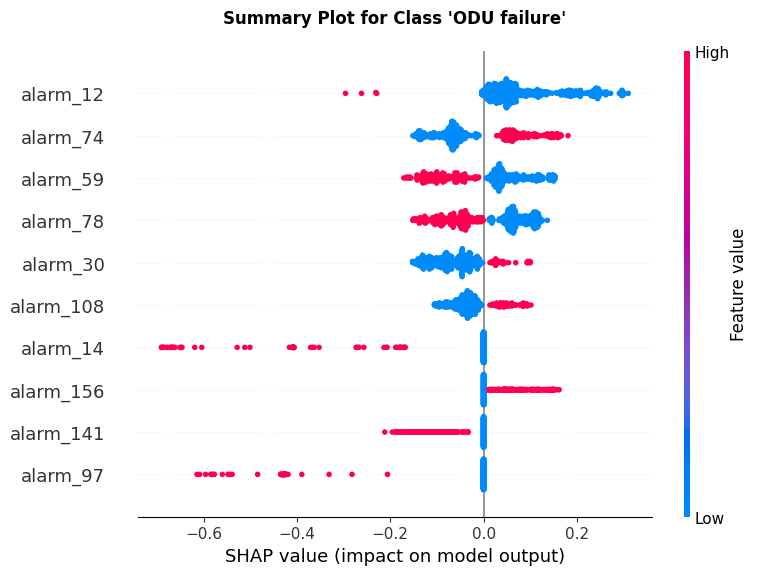

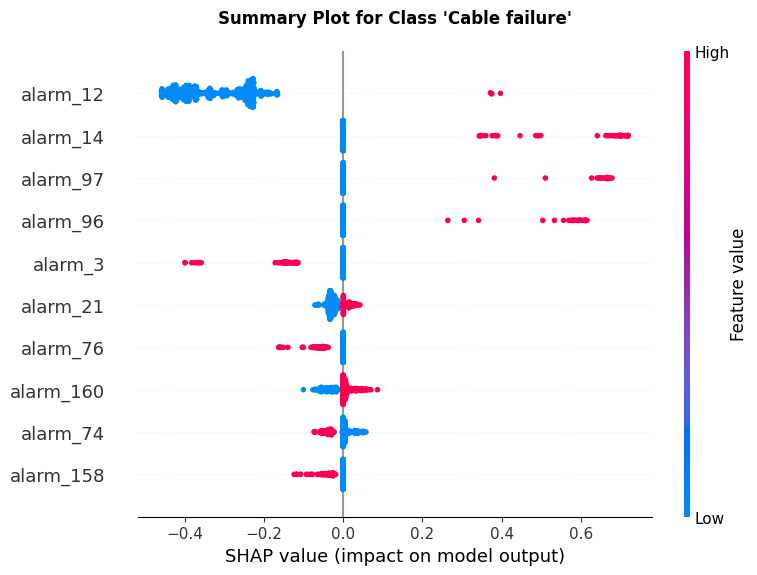

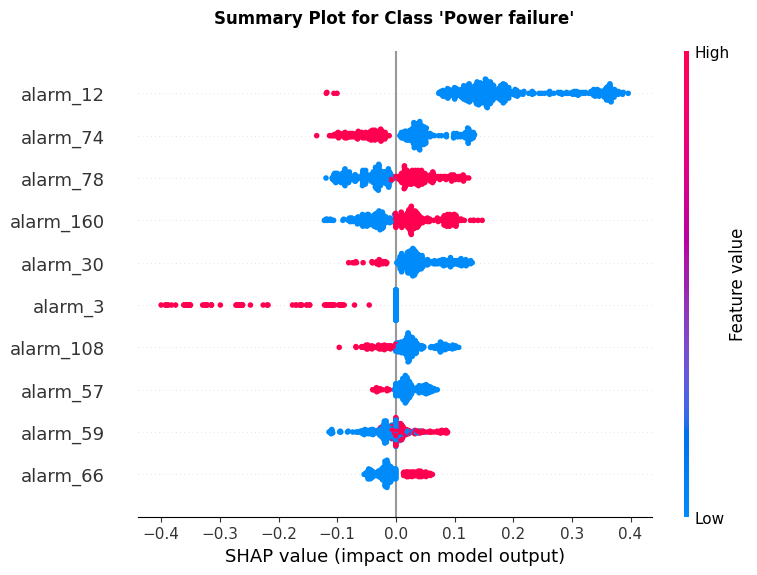

In [ ]:
className = ['IDU failure', 'ODU failure', 'Cable failure', 'Power failure']

with warnings.catch_warnings():
  for idx in range(len(className)):
      plt.figure()

      shap.summary_plot(shapValues[idx], features = xTestBinary, feature_names = columns,
                        show = False, max_display = 10)

      title = f"Summary Plot for Class '{className[idx]}'"
      plt.title(title, pad = 20, fontweight = 'bold')
      plt.show()
      print('\n\n')

### Categorical

#### XGBoost

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

model.fit(xTrainCategorical, yTrainCategorical)

categoricalDf = pd.read_csv("/content/drive/My Drive/NMDA Lab - Project/categorical_dataset/dcategorical.csv")
categoricalDf.drop(columns = ['label'], inplace = True)

# Obtaining shap values
explainerShap = shap.TreeExplainer(model)
shapValues = explainerShap.shap_values(xTestCategorical)

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:160: UserWarning:

[13:55:42] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.



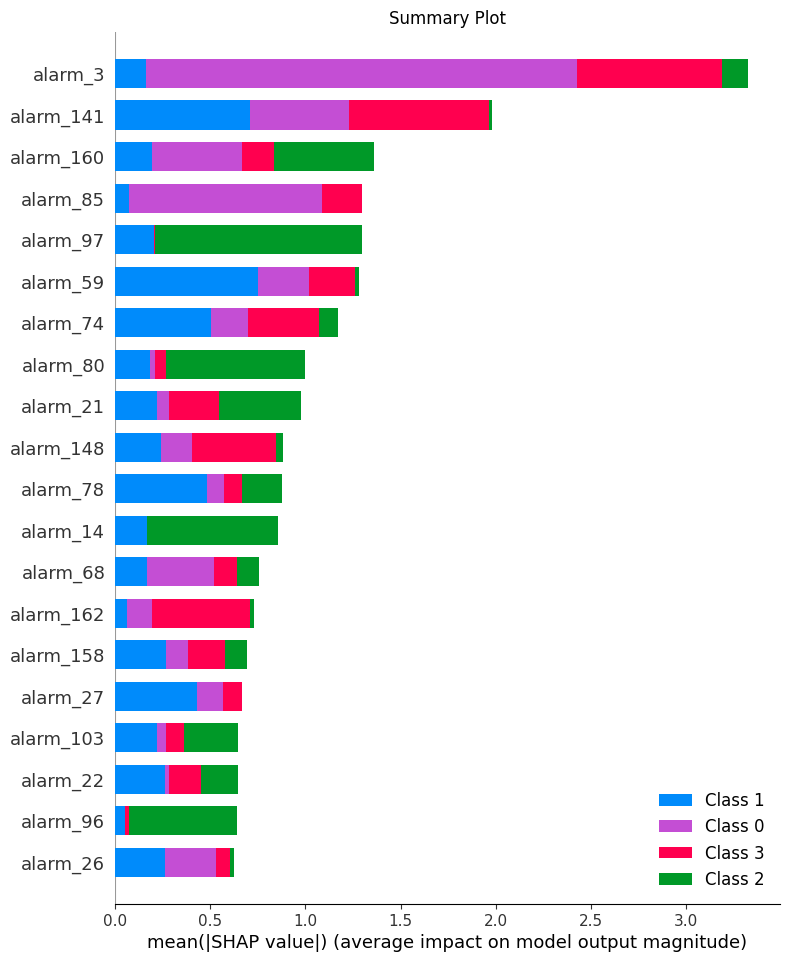

In [ ]:
shap.summary_plot(shapValues, feature_names=list(categoricalDf.columns), show = False)
plt.title("Summary Plot")
plt.show()

/usr/local/lib/python3.10/dist-packages/shap/plots/_beeswarm.py:699: UserWarning:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored



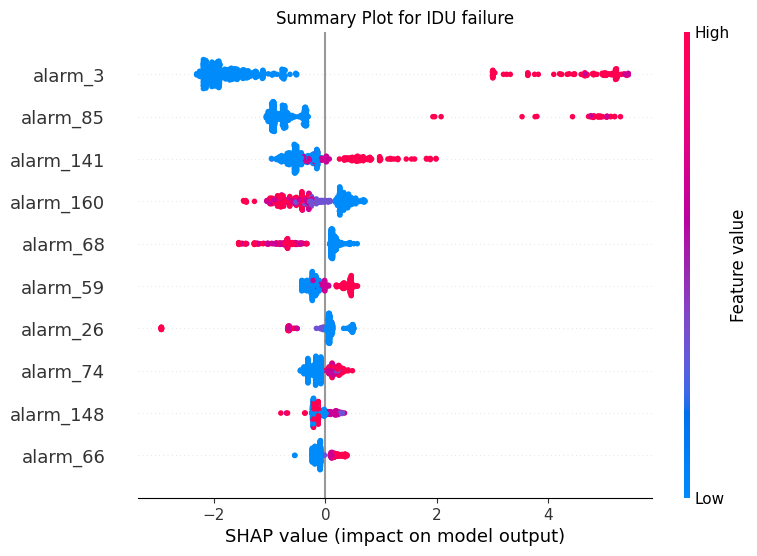

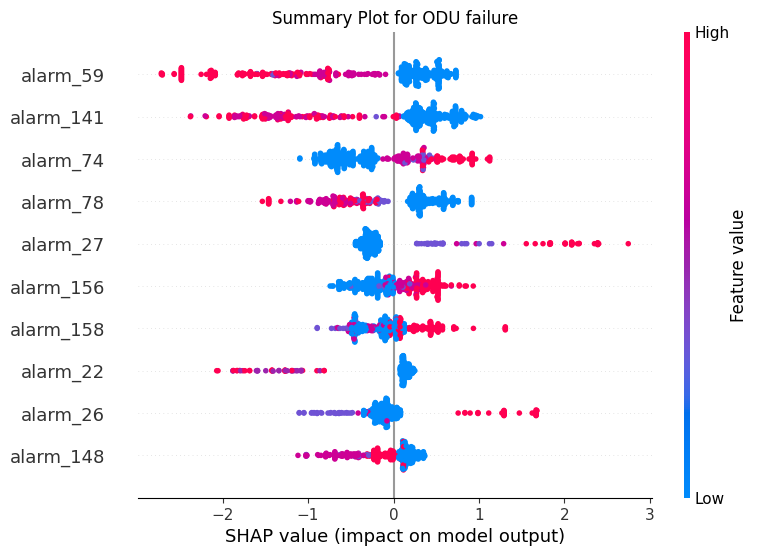

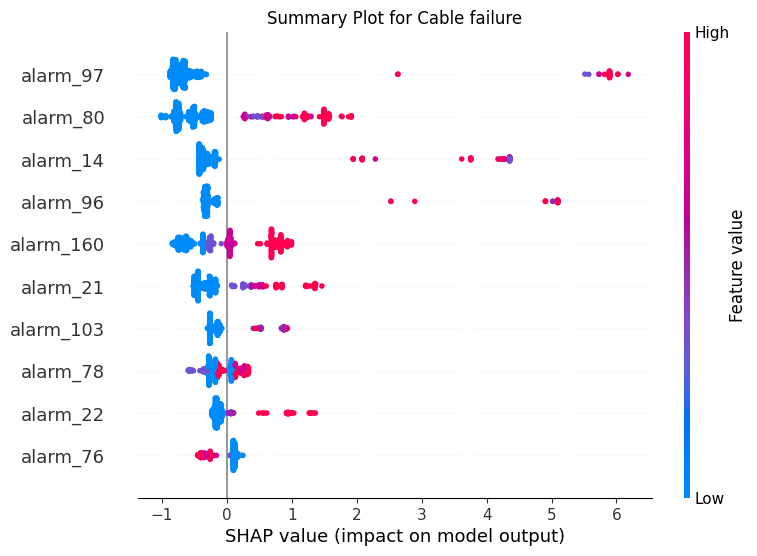

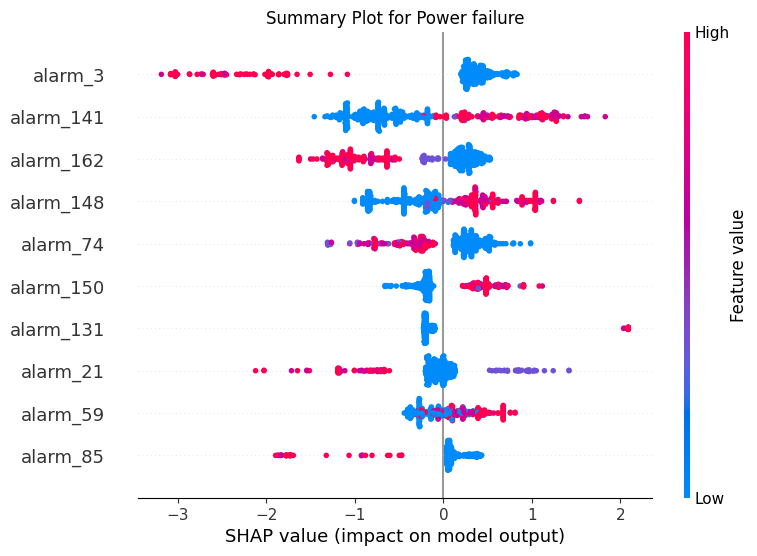

In [ ]:
className = ['IDU failure', 'ODU failure', 'Cable failure', 'Power failure']

for classInd in range(len(className)):
    shap.summary_plot(shapValues[classInd], features=xTestCategorical, feature_names=list(categoricalDf.columns),
                      show = False, max_display=10)

    title = 'Summary Plot for ' + str(className[classInd])
    plt.title(title)
    plt.show()

In [ ]:
shap.initjs()
shap.force_plot(explainerShap.expected_value[0], shapValues[0], xTestCategorical)

#### SVM

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/SVM_Categorical'

with open(path, 'r') as json_file:

    bestParameters = json.load(json_file)

svm = SVC(decision_function_shape = bestParameters['decision_function_shape'],
          kernel = bestParameters['kernel'],
          C = bestParameters['C'],
          gamma = bestParameters['gamma'],
          probability = True,
          class_weight = 'balanced')

svm.fit(xTrainCategorical, yTrainCategorical)

SVC(C=1, class_weight='balanced', decision_function_shape='ovo',
    kernel='linear', probability=True)

In [ ]:
explainer = shap.KernelExplainer(svm.predict, xTestCategorical[:2])

shapValues = explainer(xTestCategorical)

  0%|          | 0/500 [00:00<?, ?it/s]

*********************** Sample 100 ----> Prediction: Class 0, Actual: Class 0 ***********************




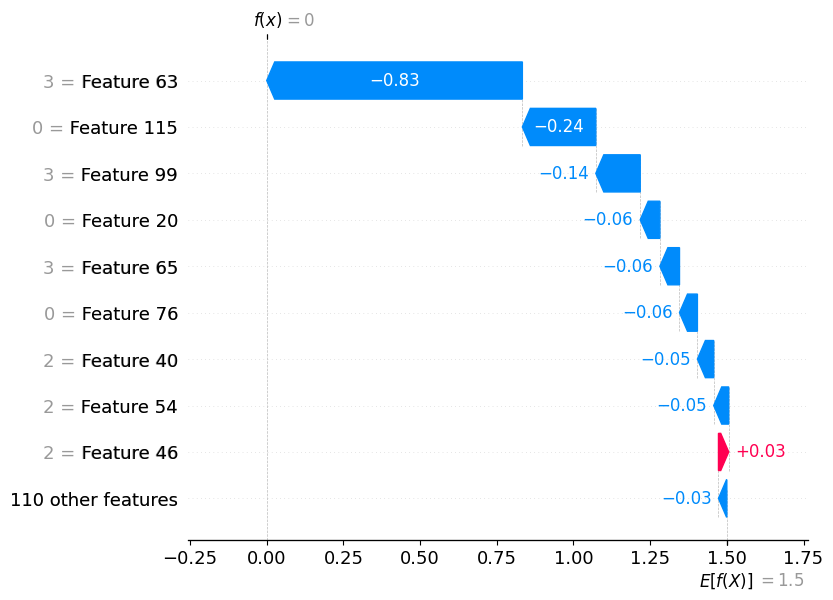

In [ ]:
idx = 100
predictedClass = svm.predict([xTestCategorical[idx]])[0]
actualClass = yTestCategorical[idx]

print(f"*********************** Sample {idx} ----> Prediction: Class {predictedClass}, Actual: Class {actualClass} ***********************\n\n")

shap.plots.waterfall(shapValues[idx], max_display = 10)

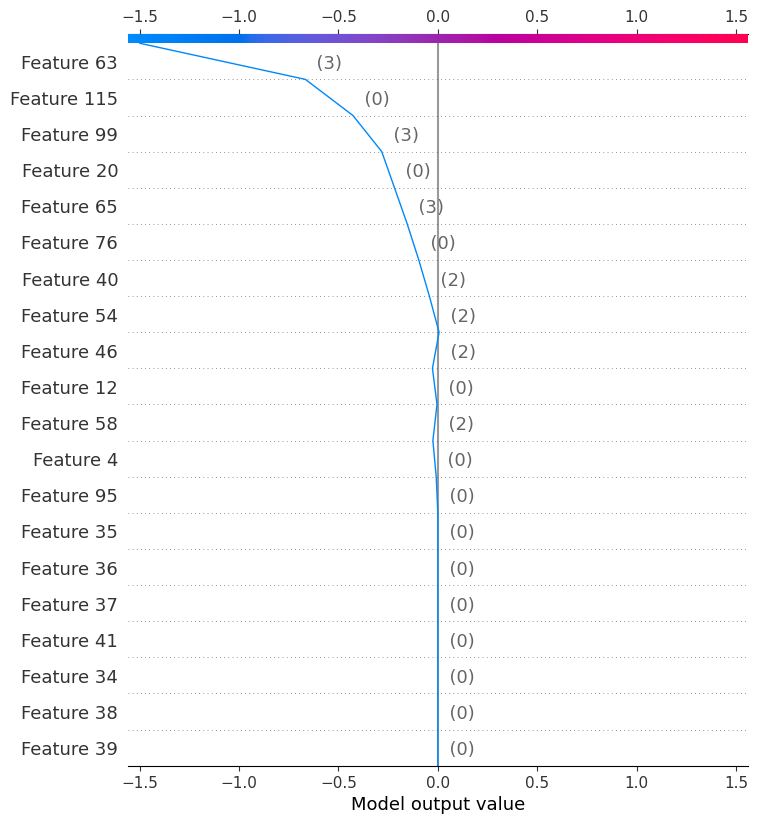

In [ ]:
shapValuesArray = shapValues.values
features = xTestCategorical[idx].reshape(1, -1)

shap.decision_plot(predictedClass, shapValuesArray[idx], features)

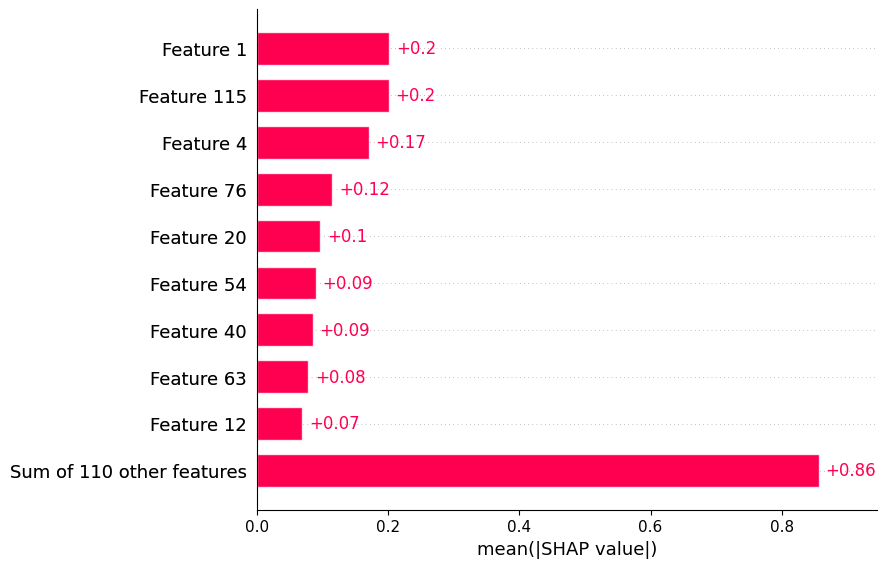

In [ ]:
shap.plots.bar(shapValues)

In [ ]:
explainer = shap.KernelExplainer(svm.predict_proba, xTestCategorical[:2])

shapValues = explainer.shap_values(xTestCategorical)

  0%|          | 0/500 [00:00<?, ?it/s]

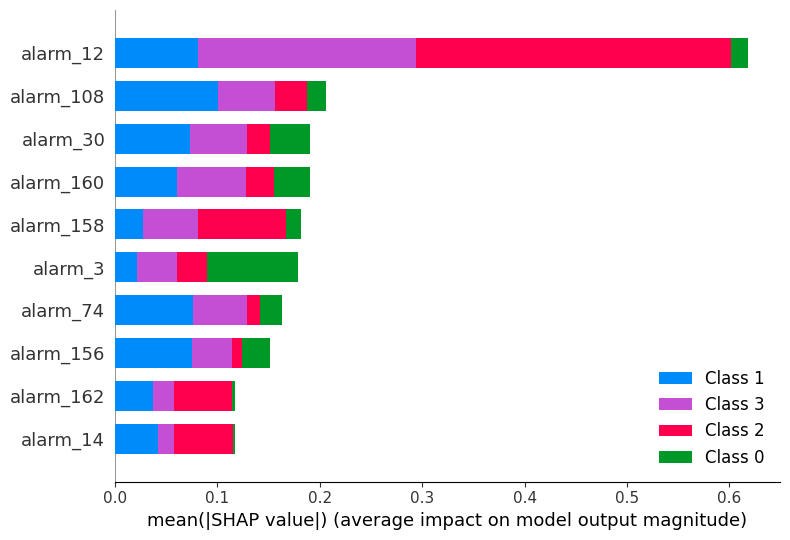

In [ ]:
columns = list(trainingSetCategorical.drop(columns = ['label']).columns)

with warnings.catch_warnings():

  warnings.simplefilter("ignore", UserWarning)
  shap.summary_plot(shapValues, xTestCategorical, feature_names = columns, max_display = 10)

/usr/local/lib/python3.10/dist-packages/shap/plots/_beeswarm.py:699: UserWarning:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored



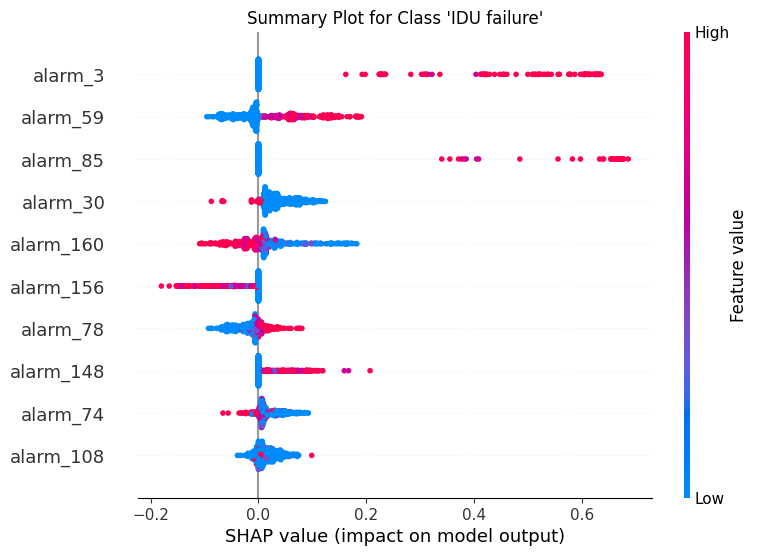

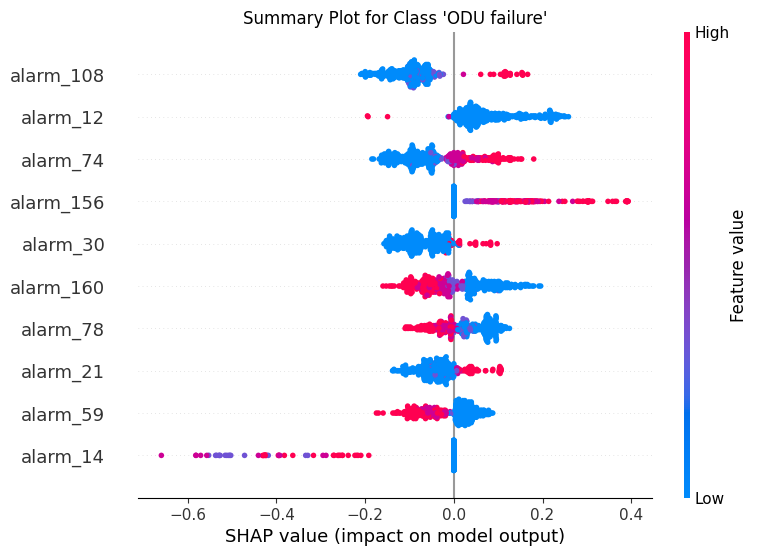

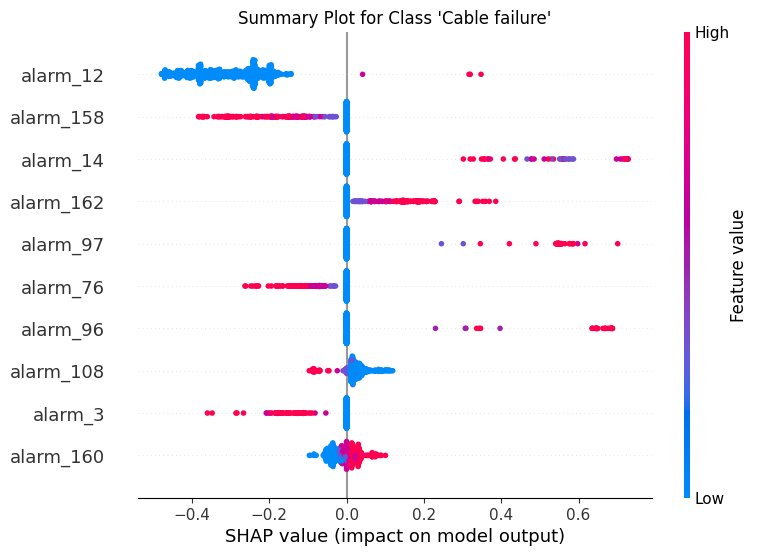

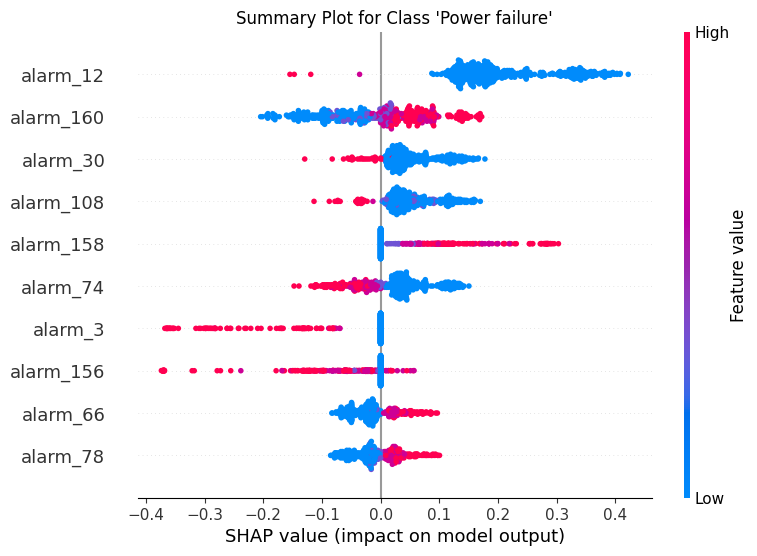

In [ ]:
className = ['IDU failure', 'ODU failure', 'Cable failure', 'Power failure']

with warnings.catch_warnings():
  for idx in range(len(className)):
      plt.figure()
      shap.summary_plot(shapValues[idx], features = xTestCategorical, feature_names = columns,
                        show = False, max_display = 10)

      title = f"Summary Plot for Class '{className[idx]}'"
      plt.title(title)
      plt.show()
      print('\n\n')

## Permutation Feature Importance

### Binary

#### XGBoost

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

model.fit(xTrainBinary, yTrainBinary)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=['mlogloss'],
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.2, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=5,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=100,
              n_jobs=None, num_parallel_tree=None, objective='multi:softmax', ...)

In [ ]:
permImportance = permutation_importance(model, xTestBinary, yTestBinary, n_repeats=10, random_state=42)

importanceDf = pd.DataFrame({'Feature': binaryDf.columns,
                              'Importance': permImportance.importances_mean,
                              'Std': permImportance.importances_std})

importanceDf = importanceDf.sort_values(by='Importance', ascending=False)
importanceDf

,Feature,Importance,Std
1,alarm_3,0.2010,0.012689
6,alarm_14,0.1032,0.006585
69,alarm_97,0.0888,0.008681
68,alarm_96,0.0664,0.003200
63,alarm_85,0.0658,0.004771
...,...,...,...
90,alarm_132,-0.0002,0.000600
38,alarm_57,-0.0002,0.000600
16,alarm_26,-0.0004,0.001200
46,alarm_66,-0.0006,0.000917


In [ ]:
# X-axis (Importance): This axis shows the importance values of the features. Higher absolute values (positive or negative) indicate greater importance in
# influencing the model's predictions.

# Y-axis (Standard Deviation): This axis represents the standard deviation of the feature importance. Lower values indicate more stable importance across permutations,
# while higher values suggest more variability.

# The plot shows that only a few features have significant and stable importance, while most features contribute minimally to the model's predictions

fig = px.scatter(importanceDf, x='Importance', y='Std',
                 title='Permutation Feature Importance',
                 labels={'Importance': 'Importance', 'Std': 'Standard Deviation'})

fig.update_layout(
    xaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    yaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    showlegend=False
)

fig.update_xaxes(showspikes=True, spikecolor="black", spikethickness=1)
fig.update_yaxes(showspikes=True, spikecolor="black", spikethickness=1)

fig.show()

In [ ]:
# The histogram represents the distribution of feature importance values. Most features have an importance value close to zero, indicating they do not significantly
# impact the model's predictions. A few features have importance values slightly deviating from zero, both positively and negatively. This suggests that only a small
# number of features have a meaningful effect on the model, while the majority contribute minimally

fig_hist = px.histogram(importanceDf, x='Importance', nbins=20, title='Importance')

fig_hist.update_layout(
    xaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    yaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    showlegend=False
)

fig_hist.show()

In [ ]:
# X-axis (Mean Decrease in Accuracy): This axis represents how much the accuracy of the model decreases when a particular feature is permuted.
# Values further from zero indicate greater importance of the feature.

fig_bar = go.Figure()

fig_bar.add_trace(go.Bar(
    x=importanceDf['Importance'],
    y=importanceDf['Feature'],
    error_x=dict(type='data', array=importanceDf['Std']),
    orientation='h'
))

fig_bar.update_layout(
    title='Permutation Feature Importance',
    xaxis_title='Mean Decrease in Accuracy',
    yaxis_title='Feature',
    yaxis=dict(autorange='reversed'),
    showlegend=False
)

fig_bar.show()

### Categorical

#### XGBoost

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

model.fit(xTrainCategorical, yTrainCategorical)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=['mlogloss'],
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.2, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=15,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=150,
              n_jobs=None, num_parallel_tree=None, objective='multi:softmax', ...)

In [ ]:
permImportance = permutation_importance(model, xTestCategorical, yTestCategorical, n_repeats=10, random_state=42)

importanceDf = pd.DataFrame({'Feature': categoricalDf.columns,
                              'Importance': permImportance.importances_mean,
                              'Std': permImportance.importances_std})

importanceDf = importanceDf.sort_values(by='Importance', ascending=False)
importanceDf

,Feature,Importance,Std
1,alarm_3,0.2028,0.012205
69,alarm_97,0.0822,0.007125
6,alarm_14,0.0808,0.004750
63,alarm_85,0.0694,0.004903
68,alarm_96,0.0442,0.003628
...,...,...,...
38,alarm_57,0.0000,0.000000
37,alarm_56,0.0000,0.000000
118,alarm_163,0.0000,0.000000
32,alarm_49,-0.0002,0.000600


In [ ]:
# X-axis (Importance): This axis shows the importance values of the features. Higher absolute values (positive or negative) indicate greater importance in
# influencing the model's predictions.

# Y-axis (Standard Deviation): This axis represents the standard deviation of the feature importance. Lower values indicate more stable importance across permutations,
# while higher values suggest more variability.

# The plot shows that only a few features have significant and stable importance, while most features contribute minimally to the model's predictions

fig = px.scatter(importanceDf, x='Importance', y='Std',
                 title='Permutation Feature Importance',
                 labels={'Importance': 'Importance', 'Std': 'Standard Deviation'})

fig.update_layout(
    xaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    yaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    showlegend=False
)

fig.update_xaxes(showspikes=True, spikecolor="black", spikethickness=1)
fig.update_yaxes(showspikes=True, spikecolor="black", spikethickness=1)

fig.show()

In [ ]:
# The histogram represents the distribution of feature importance values. Most features have an importance value close to zero, indicating they do not significantly
# impact the model's predictions. A few features have importance values slightly deviating from zero, both positively and negatively. This suggests that only a small
# number of features have a meaningful effect on the model, while the majority contribute minimally

fig_hist = px.histogram(importanceDf, x='Importance', nbins=20, title='Importance')

fig_hist.update_layout(
    xaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    yaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
    showlegend=False
)

fig_hist.show()

In [ ]:
# X-axis (Mean Decrease in Accuracy): This axis represents how much the accuracy of the model decreases when a particular feature is permuted.
# Values further from zero indicate greater importance of the feature.

fig_bar = go.Figure()

fig_bar.add_trace(go.Bar(
    x=importanceDf['Importance'],
    y=importanceDf['Feature'],
    error_x=dict(type='data', array=importanceDf['Std']),
    orientation='h'
))

fig_bar.update_layout(
    title='Permutation Feature Importance',
    xaxis_title='Mean Decrease in Accuracy',
    yaxis_title='Feature',
    yaxis=dict(autorange='reversed'),
    showlegend=False
)

fig_bar.show()

## LIME

### Binary

#### XGboost

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Binary'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

model.fit(xTrainBinary, yTrainBinary)

explainer = LimeTabularExplainer(
    training_data=xTrainBinary,
    feature_names=binaryDf.columns,
    class_names=['IDU failure', 'ODU failure', 'Cable failure', 'Power failure'],
    mode='classification'
)

index = 300
print(yTestBinary[index])
instance = xTestBinary[index].reshape(1, -1)

exp = explainer.explain_instance(
    data_row=instance[0],
    predict_fn=model.predict_proba
)

exp.show_in_notebook(show_all=False)

3


### Categorical

#### XGboost

In [ ]:
path = '/content/drive/MyDrive/NMDA Lab - Project/best_params/XGBoost_Categorical'

with open(path, 'r') as json_file:
    bestParameters = json.load(json_file)

model = XGBClassifier(verbosity = 0, objective = 'multi:softmax', eval_metric=['mlogloss'],
                      n_estimators = int(bestParameters['n_estimators']), max_depth = int(bestParameters['max_depth']), subsample = bestParameters['subsample'], learning_rate = bestParameters['learning_rate'])

model.fit(xTrainCategorical, yTrainCategorical)

explainer = LimeTabularExplainer(
    training_data=xTrainCategorical,
    feature_names=categoricalDf.columns,
    class_names=['IDU failure', 'ODU failure', 'Cable failure', 'Power failure'],
    mode='classification'
)

index = 88
print(yTestCategorical[index])
instance = xTrainCategorical[index].reshape(1, -1)

exp = explainer.explain_instance(
    data_row=instance[0],
    predict_fn=model.predict_proba
)

exp.show_in_notebook(show_all=False)

2
